# Imports

In [1]:
import pandas as pd

import seaborn as sns
import numpy as np
import matplotlib as mpl

import matplotlib.pyplot as plt

import warnings
import scipy

warnings.filterwarnings("ignore")

sns.set(font_scale=1)

sns.set_style("white")

%matplotlib inline

In [2]:
def item_series(item, indexed=None):
    """
    Creates a series filled with item with indexes from indexed (if Series-like) or numerical indexes (size=indexed)
    :param item: value for filling
    :param indexed:
    :return:
    """
    if indexed is not None:
        if hasattr(indexed, 'index'):
            return pd.Series([item] * len(indexed), index=indexed.index)
        elif type(indexed) is int and indexed > 0:
            return pd.Series([item] * indexed, index=np.arange(indexed))
    return pd.Series()

def pivot_vectors(vec1, vec2, na_label_1=None, na_label_2=None):
    """
    Aggregates 2 vectors into a table with amount of pairs (vec1.x, vec2.y) in a cell
    Both series must have same index.
    Else different indexes values will be counted in a_label_1/na_label_2 columns if specified or ignored
    :param vec1: pd.Series
    :param vec2: pd.Series
    :param na_label_1: How to name NA column
    :param na_label_2: How to name NA row
    :return: pivot table
    """

    name1 = str(vec1.name)
    if vec1.name is None:
        name1 = 'V1'

    name2 = str(vec2.name)
    if vec2.name is None:
        name2 = 'V2'

    if name1 == name2:
        name1 += '_1'
        name2 += '_2'

    sub_df = pd.DataFrame({name1: vec1, name2: vec2})
    # FillNAs
    fill_dict = {}
    if na_label_1 is not None:
        fill_dict[name1] = na_label_1
    if na_label_2 is not None:
        fill_dict[name2] = na_label_2
    sub_df.fillna(value=fill_dict, inplace=True)

    sub_df = sub_df.assign(N=item_series(1, sub_df))

    return (
        pd.pivot_table(data=sub_df, columns=name1, index=name2, values='N', aggfunc=sum)
        .fillna(0)
        .astype(int)
    )


In [3]:
def write_dataset(data, path, sep='\t', header=True, index=True, compression=None):
    """
    See pandas.to_csv documentation - this is just a wrapper
    :param data: data to save
    :param path: str or Path object, path to save
    :param sep:
    :param header:
    :param index:
    :param compression:
    :return:
    """
    from pathlib import Path

    if isinstance(path, str):
        path = Path(path)

    output_dir = path.parents[0]
    output_dir.mkdir(parents=True, exist_ok=True)

    return data.to_csv(
        path, sep=sep, header=header, index=index, compression=compression
    )

In [4]:
#from plotting import annotate_genes_in_maf, vaf_depth_plot

In [5]:

cols = ['Hugo_Symbol',
        'HGVSp_Short', 
       'Tumor_VAF', 'Normal_VAF',
        't_depth','t_alt_count','n_depth', 'n_alt_count',
        'Variant_Classification',
     #   'total', 
     #   'minor',
    #    'LOH',
     #   'segment_cna_combined',
     #  'segment_total_copies',
     #   'segment_altered_copies',
       'Chromosome',
        'Start_Position',
       'End_Position',
      #  'Gain_loss_of_function',
       'HGVSc']
        #'IS_HOTSPOT']

In [6]:
def cell_fraction_by_alt_copy_vaf(vaf, total, altered):
    """
    Calculates mutation cell fraction using VAF, Total and altered copies information
    :param vaf:
    :param total:
    :param altered:
    :return:
    """
    return 2 * vaf / (altered - total * vaf + 2 * vaf)

In [7]:
def bot_bar_plot(
    data,
    palette=None,
    lrot=0,
    figsize=(5, 5),
    title='',
    ax=None,
    order=None,
    stars=False,
    percent=False,
    pvalue=False,
    p_digits=5,
    legend=True,
    xl=True,
    offset=-0.1,
    linewidth=0,
    align='center',
    bar_width=0.9,
    edgecolor=None,
    hide_grid=True,
    draw_horizontal=False,
    plot_all_borders=True,
    **kwargs
):
    """
    Plot a stacked bar plot based on contingency table

    Parameters
    ----------
    data: pd.DataFrame
        contingency table for plotting. Each element of index corresponds to a bar.
    palette: dict
        palette for plotting. Keys are unique values from groups, entries are color hexes
    lrot: float
        rotation angle of bar labels in degrees
    figsize: (float, float)
        figure size in inches
    title: str
        plot title
    ax: matplotlib axis
        axis to plot on
    order: list
        what order to plot the stacks of each bar in. Contains column labels of "data"
    stars: bool
        whether to use the star notation for p value instead of numerical value
    percent: bool
        whether to normalize each bar to 1
    pvalue: bool
        whether to add the p value (chi2 contingency test) to the plot title.
    p_digits: int
        number of digits to round the p value to
    legend: bool
        whether to plot the legend
    xl: bool
        whether to plot bar labels (on x axis for horizontal plot, on y axis for vertical plot)
    hide_grid: bool
        whether to hide grid on plot
    draw_horizontal: bool
        whether to draw horizontal bot bar plot
    plot_all_borders: bool
        whether to plot top and right border

    Returns
    -------
    matplotlib axis
    """
    from matplotlib.ticker import FuncFormatter

    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    if pvalue:
        from scipy.stats import chi2_contingency

        chi2_test_data = chi2_contingency(data)
        p = chi2_test_data[1]
        if title is not False:
            title += '\n' + get_pvalue_string(p, p_digits, stars=stars)

    if percent:
        c_data = data.apply(lambda x: x * 1.0 / x.sum(), axis=1)
        if title:
            title = '% ' + title
        ax.set_ylim(0, 1)
    else:
        c_data = data

    c_data.columns = [str(x) for x in c_data.columns]

    if order is None:
        order = c_data.columns
    else:
        order = [str(x) for x in order]

    if palette is None:
        c_palette = lin_colors(pd.Series(order))

        if len(order) == 1:
            c_palette = {order[0]: blue_color}
    # else:
    #     c_palette = {str(k): v for k, v in palette.items()}

    if edgecolor is not None:
        edgecolor = [edgecolor] * len(c_data)

    kind_type = 'bar'
    if draw_horizontal:
        kind_type = 'barh'

    c_data[order].plot(
        kind=kind_type,
        stacked=True,
        position=offset,
        width=bar_width,
        color=palette,
        ax=ax,
        linewidth=linewidth,
        align=align,
        edgecolor=edgecolor,
    )

    ax = bot_bar_plot_prettify_axis(
        ax,
        c_data,
        legend,
        draw_horizontal,
        xl,
        lrot,
        title,
        hide_grid,
        plot_all_borders,
        **kwargs
    )

    if percent:
        ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

    return ax

def bot_bar_plot_prettify_axis(ax, c_data, legend, draw_horizontal, xl, lrot, title, hide_grid, plot_all_borders,
                               **kwargs):
    """
    Change some properties of bot_bar_plot ax

    Returns
    -------
    prettified axis
    """

    if legend:
        ax.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.1)
    else:
        ax.legend_.remove()

    if 'ylabel' in kwargs.keys():
        ax.set(ylabel=kwargs['ylabel'])

    if 'xlabel' in kwargs.keys():
        ax.set(xlabel=kwargs['xlabel'])

    if not draw_horizontal:
        ax.set_xticks(np.arange(len(c_data.index)) + 0.5)
        if xl:
            ax.set_xticklabels(c_data.index, rotation=lrot)
        else:
            ax.set_xticklabels([])
    else:
        ax.set_yticks(np.arange(len(c_data.index)) + 0.5)
        if xl:
            ax.set_yticklabels(c_data.index, rotation=lrot)
        else:
            ax.set_yticklabels([])

    if title is not False:
        ax.set_title(title)

    if hide_grid:
        ax.grid(False)

    sns.despine(ax=ax)

    if plot_all_borders:
        ax.spines['top'].set_visible(True)
        ax.spines['right'].set_visible(True)

    return ax
def pivot_vectors(vec1, vec2, na_label_1=None, na_label_2=None):
    """
    Aggregates 2 vectors into a table with amount of pairs (vec1.x, vec2.y) in a cell
    Both series must have same index.
    Else different indexes values will be counted in a_label_1/na_label_2 columns if specified or ignored
    :param vec1: pd.Series
    :param vec2: pd.Series
    :param na_label_1: How to name NA column
    :param na_label_2: How to name NA row
    :return: pivot table
    """

    name1 = str(vec1.name)
    if vec1.name is None:
        name1 = 'V1'

    name2 = str(vec2.name)
    if vec2.name is None:
        name2 = 'V2'

    if name1 == name2:
        name1 += '_1'
        name2 += '_2'

    sub_df = pd.DataFrame({name1: vec1, name2: vec2})
    # FillNAs
    fill_dict = {}
    if na_label_1 is not None:
        fill_dict[name1] = na_label_1
    if na_label_2 is not None:
        fill_dict[name2] = na_label_2
    sub_df.fillna(value=fill_dict, inplace=True)

    sub_df = sub_df.assign(N=item_series(1, sub_df))

    return (
        pd.pivot_table(data=sub_df, columns=name1, index=name2, values='N', aggfunc=sum)
        .fillna(0)
        .astype(int)
    )
def item_series(item, indexed=None):
    """
    Creates a series filled with item with indexes from indexed (if Series-like) or numerical indexes (size=indexed)
    :param item: value for filling
    :param indexed:
    :return:
    """
    if indexed is not None:
        if hasattr(indexed, 'index'):
            return pd.Series([item] * len(indexed), index=indexed.index)
        elif type(indexed) is int and indexed > 0:
            return pd.Series([item] * indexed, index=np.arange(indexed))
    return pd.Series()

def lin_colors(
    factors_vector,
    cmap='default',
    sort=True,
    min_v=0,
    max_v=1,
    linspace=True,
    lighten_color=None,
):
    """
    Return dictionary of unique features of "factors_vector" as keys and color hexes as entries
    :param factors_vector: pd.Series
    :param cmap: matplotlib.colors.LinearSegmentedColormap, which colormap to base the returned dictionary on
        default - matplotlib.cmap.hsv with min_v=0, max_v=.8, lighten_color=.9
    :param sort: bool, whether to sort the unique features
    :param min_v: float, for continuous palette - minimum number to choose colors from
    :param max_v: float, for continuous palette - maximum number to choose colors from
    :param linspace: bool, whether to spread the colors from "min_v" to "max_v"
        linspace=False can be used only in discrete cmaps
    :param lighten_color: float, from 0 to +inf: 0 - very dark (just black), 1 - original color, >1 - brighter color
    :return: dict
    """

    unique_factors = factors_vector.dropna().unique()
    if sort:
        unique_factors = np.sort(unique_factors)

    if cmap == 'default':
        cmap = plt.cm.rainbow
        max_v = 0.92

    if linspace:
        cmap_colors = cmap(np.linspace(min_v, max_v, len(unique_factors)))
    else:
        cmap_colors = np.array(cmap.colors[: len(unique_factors)])

    if lighten_color is not None:
        cmap_colors = [x * lighten_color for x in cmap_colors]
        cmap_colors = np.array(cmap_colors).clip(0, 1)

    return dict(
        list(zip(unique_factors, [plt.colors.to_hex(x) for x in cmap_colors]))
    )
def round_to_1(x):
    """
    Round "x" to first significant digit
    :param x: float
    :return: float
    """
    from math import floor, log10

    return round(x, -int(floor(log10(abs(x)))))

def star_pvalue(pvalue, lev1=0.05, lev2=0.01, lev3=0.001):
    """
    Return star notation for p value
    :param pvalue: float
    :param lev1: float, '*' threshold
    :param lev2: float, '**' threshold
    :param lev3: float, '***' threshold
    :return: str
    """
    if pvalue < lev3:
        return '***'
    if pvalue < lev2:
        return '**'
    if pvalue < lev1:
        return '*'
    return '-'


def to_common_samples(df_list=()):
    """
    Accepts a list of dataframe/series-s. Returns all dataframe/series-s with intersected indexes in the same order
    :param df_list: list of pd.DataFrame/pd.Series
    :return: pd.DataFrame
    """
    cs = set(df_list[0].index)
    for i in range(1, len(df_list)):
        cs = cs.intersection(df_list[i].index)

    if len(cs) < 1:
        warnings.warn('No common samples!')
    return [df_list[i].loc[list(cs)] for i in range(len(df_list))]

def get_pvalue_string(p, p_digits=3, stars=False, prefix='p-value'):
    """
    Return string with p-value, rounded to p_digits
    :param stars: Display pvalue as stars
    :param p: float, p-value
    :param p_digits: int, default 4, number of digits to round p-value
    :param prefix:
    :return: str, p-value info string
    """
    significant_pvalue = 10**-p_digits
    if stars:
        pvalue_str = star_pvalue(p, lev3=10**-p_digits)
    else:
        if p < significant_pvalue:
            if len(prefix):
                prefix += ' < '
            pvalue_str = f'{prefix}{significant_pvalue}'
        else:
            if len(prefix):
                prefix += ' = '
            if p < 0.00001:
                pvalue_str = f'{prefix}{round_to_1(p):.0e}'
            else:
                pvalue_str = f'{prefix}{round_to_1(p)}'
    return pvalue_str

def boxplot_with_pvalue(
    data,
    grouping,
    title='',
    ax=None,
    figsize=None,
    swarm=True,
    p_digits=3,
    stars=True,
    violin=False,
    palette=None,
    order=None,
    y_min=None,
    y_max=None,
    s=7,
    p_fontsize=16,
    xlabel=None,
    **kwargs,
):
    """
    Plots boxplot or violin plot with pairwise comparisons
    :param data: pd.Series, series with numerical data
    :param grouping: pd.Series, series with categorical data
    :param title: str, plot title
    :param ax: matplotlib axis, axis to plot on
    :param figsize: (float, float), figure size in inches
    :param swarm: bool, whether to plot a swarm in addition to boxes
    :param p_digits: int, number of digits to round p value to
    :param stars: bool, whether to plot star notation instead of number for p value
    :param violin: bool, whether to do a violin plot
    :param palette: dict, palette for plotting. Keys are unique values from groups, entries are color hexes
    :param order: list, order to plot the entries in. Contains ordered unique values from "grouping"
    :param y_min: float, vertical axis minimum
    :param y_max:float, vertical axis maximum
    :param s: float, size of dots in swarmplot
    :param p_fontsize: float, font size for p value labels
    :param kwargs:
    :return: matplotlib axis
    """

    from scipy.stats import mannwhitneyu

    if data.index.duplicated().any() | grouping.index.duplicated().any():
        raise Exception('Indexes contain duplicates')

    cdata, cgrouping = to_common_samples([data.dropna(), grouping.dropna()])

    if len(cgrouping.dropna().unique()) < 2:
        raise Exception(
            'Less from 2 classes provided: {}'.format(len(cgrouping.unique()))
        )

    if order is None:
        order = cgrouping.dropna().unique()

    if ax is None:
        if figsize is None:
            figsize = (1.2 * len(order), 4)
        _, ax = plt.subplots(figsize=figsize)

    if not violin:
        sns.boxplot(
            y=cdata,
            x=cgrouping,
            ax=ax,
            palette=palette,
            order=order,
            fliersize=0,
            **kwargs,
        )
    else:
        sns.violinplot(
            y=cdata, x=cgrouping, ax=ax, palette=palette, order=order, **kwargs
        )

        # Ignoring swarm setting since violin performs same function
        swarm = False

    if swarm:
        sns.swarmplot(y=cdata, x=cgrouping, ax=ax, color=".25", order=order, s=s)

    pvalues = []
    for g1, g2 in zip(order[:-1], order[1:]):
        samples_g1 = cgrouping[cgrouping == g1].index
        samples_g2 = cgrouping[cgrouping == g2].index
        try:
            if len(samples_g1) and len(samples_g2):
                pv = mannwhitneyu(
                    cdata.loc[samples_g1],
                    cdata.loc[samples_g2],
                    alternative='two-sided',
                ).pvalue
            else:
                pv = 1
        except ValueError:
            pv = 1
        pvalues.append(pv)

    y_max = y_max or max(cdata)
    y_min = y_min or min(cdata)
    effective_size = y_max - y_min
    plot_y_limits = (y_min - effective_size * 0.15, y_max + effective_size * 0.2)

    if p_digits > 0:

        pvalue_line_y_1 = y_max + effective_size * 0.05
        if figsize is None:
            figsize = define_ax_figsize(ax)
        pvalue_text_y_1 = pvalue_line_y_1 + 0.25 * effective_size / figsize[1]

        for pos, pv in enumerate(pvalues):
            pvalue_str = get_pvalue_string(pv, p_digits, stars=stars)
            pvalue_text_y_1_local = pvalue_text_y_1

            if pvalue_str == '-':
                pvalue_text_y_1_local += 0.1 * effective_size / figsize[1]

            bar_fraction = str(0.25 / 2.0 / (figsize[0] / float(len(order))))

            ax.annotate(
                "",
                xy=(pos + 0.1, pvalue_line_y_1),
                xycoords='data',
                xytext=(pos + 0.9, pvalue_line_y_1),
                textcoords='data',
                arrowprops=dict(
                    arrowstyle="-",
                    ec='#000000',
                    connectionstyle="bar,fraction={}".format(bar_fraction),
                ),
            )
            ax.text(
                pos + 0.5,
                pvalue_text_y_1_local,
                pvalue_str,
                fontsize=p_fontsize,
                horizontalalignment='center',
                verticalalignment='center',
            )

    ax.set_title(title)
    ax.set_ylim(plot_y_limits)

    if xlabel is not None:
        ax.set_xlabel(xlabel)

    return ax


In [8]:
cell_fraction_by_alt_copy_vaf(0.6, 1, 1)

0.7499999999999999

In [10]:
import scanpy as sc
# Configure global plot aesthetics for high-quality visuals
sc.set_figure_params(dpi=300, frameon=False, fontsize=12)  # High DPI and clean font settings


# Gene lists

In [11]:
Martincorena = pd.read_excel('/home/alexandra.livanova/INT/41586_2022_5202_MOESM8_ESM 1.xlsx')
Martincorena

,Martincorena
0,ABL1
1,CCDC6
2,EIF1AX
3,HIST1H2BD
4,MED12
...,...
365,HIST1H1E
366,MAX
367,PLCG1
368,SMARCA4


In [12]:
IntOGen = pd.read_excel('/home/alexandra.livanova/INT/IntOGen.xlsx')
IntOGen

,IntOGen
0,ABCB1
1,ABI1
2,ABL1
3,ABL2
4,ACKR3
...,...
563,ZNF814
564,ZNF93
565,ZNRF3
566,ZRSR2


# BTROHT01 core


In [21]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,DDX11L2,0,.,GRCh38,chr1,16257,16257,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16257,1.00
1,OR4G4P,0,.,GRCh38,chr1,55545,55545,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,55545,1.00
2,OR4G4P,0,.,GRCh38,chr1,56987,56988,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56987,0.91
3,OR4F5,0,.,GRCh38,chr1,72140,72141,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72140,0.76
4,OR4F5,0,.,GRCh38,chr1,73843,73843,+,3'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,73842,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407296,Unknown,0,.,GRCh38,chrY,56883711,56883711,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883711,NaN
407297,Unknown,0,.,GRCh38,chrY,56884028,56884028,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884028,NaN
407298,Unknown,0,.,GRCh38,chrY,56886108,56886108,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886108,NaN
407299,Unknown,0,.,GRCh38,chrY,56886110,56886112,+,IGR,TNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886110,NaN


In [22]:
maf_df_tissue['Tumor_VAF']=maf_df_tissue['t_alt_count']/maf_df_tissue['t_depth']
maf_df_tissue['Normal_VAF']=maf_df_tissue['n_alt_count']/maf_df_tissue['n_depth']

maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']
maf_df_tissue=maf_df_tissue[maf_df_tissue['t_depth']>10]
maf_df_tissue=maf_df_tissue[maf_df_tissue['n_depth']>10]
maf_df_tissue=maf_df_tissue[maf_df_tissue['t_alt_count']>=3]
maf_df_tissue=maf_df_tissue[maf_df_tissue['n_alt_count']==0]
# maf_df_tissue = maf_df_tissue[maf_df_tissue.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
#  'Missense_Mutation',
#  'Frame_Shift_Ins',
#  'Frame_Shift_Del',
#  'Nonsense_Mutation',
#  'Nonstop_Mutation',
#  'Translation_Start_Site',
#  'Splice_Site',
#                                                                          "5'Flank", "3'Flank",'Splice_Region',"5'UTR" 
#                                                                         ])]
# maf_df_tissue

In [12]:
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
1,OR4G4P,0,.,GRCh38,chr1,55545,55545,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,55545,1.00,0.101695,0.0
3,OR4F5,0,.,GRCh38,chr1,72140,72141,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,72140,0.76,0.068182,0.0
6,ENST00000466430,0,.,GRCh38,chr1,108297,108297,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,108297,1.00,0.022901,0.0
7,ENST00000466430,0,.,GRCh38,chr1,109488,109488,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,109488,0.52,0.172414,0.0
12,Unknown,0,.,GRCh38,chr1,202217,202217,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,202217,0.64,0.098039,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407223,CTBP2P1,0,.,GRCh38,chrY,56858319,56858320,+,3'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,56858318,NaN,0.021053,0.0
407243,Unknown,0,.,GRCh38,chrY,56863671,56863671,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,56863671,NaN,0.033981,0.0
407282,Unknown,0,.,GRCh38,chrY,56877135,56877135,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,56877135,NaN,0.022989,0.0
407294,Unknown,0,.,GRCh38,chrY,56883135,56883135,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,56883135,NaN,0.057143,0.0


In [15]:
maf_onco_01=maf_df_tissue[maf_df_tissue.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
maf_onco_01['Patient']='BTROHT01'

In [16]:
maf_onco_01

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,Patient
786,RPL22,0,.,GRCh38,chr1,6203811,6203811,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,6203811,1.0,0.200000,0.000000,BTROHT01
2043,PRDM2,0,.,GRCh38,chr1,13825710,13825712,+,3'Flank,TNP,...,NaN,NaN,NaN,NaN,NaN,13825710,1.0,0.032787,0.000000,BTROHT01
2812,ARHGEF10L,0,.,GRCh38,chr1,17538727,17538727,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,17538727,1.0,0.049180,0.000000,BTROHT01
7833,EPS15,0,.,GRCh38,chr1,51522498,51522501,+,5'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,51522497,1.0,0.329787,0.000000,BTROHT01
10970,FUBP1,0,.,GRCh38,chr1,77981578,77981578,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,77981578,1.0,0.070796,0.000000,BTROHT01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364445,PABPC1,0,.,GRCh38,chr8,100715522,100715522,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,100715522,1.0,0.051282,0.000000,BTROHT01
364670,UBR5,0,.,GRCh38,chr8,102329301,102329301,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,102329301,1.0,0.040816,0.000000,BTROHT01
380485,WNK2,0,.,GRCh38,chr9,93323783,93323783,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,93323783,1.0,0.047619,0.000000,BTROHT01
386452,P2RY8,0,.,GRCh38,chrX,1458235,1458235,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,1458235,NaN,0.022222,0.026316,BTROHT01


In [12]:
write_dataset(maf_df_tissue, 'BTROHT01_core_maf_filt.tsv')

In [73]:
#write_dataset(maf_df_orgs, '/home/alexandra.livanova/INT/INT_C036_maf_orgs.tsv')

In [16]:
# maf_merged['Tumor_VAF_y'].fillna(0, inplace=True)
# maf_merged['Tumor_VAF_x'].fillna(0, inplace=True)


# maf_merged['Hugo_Symbol_x'].fillna(maf_merged['Hugo_Symbol_y'], inplace=True)
# maf_merged['Hugo_Symbol_y'].fillna(maf_merged['Hugo_Symbol_x'], inplace=True)

# maf_merged['Variant_Classification_x'].fillna(maf_merged['Variant_Classification_y'], inplace=True)
# maf_merged['Variant_Classification_y'].fillna(maf_merged['Variant_Classification_x'], inplace=True)

# maf_merged['HGVSp_Short_x'].fillna(maf_merged['HGVSp_Short_y'], inplace=True)
# maf_merged['HGVSp_Short_y'].fillna(maf_merged['HGVSp_Short_x'], inplace=True)
# maf_merged[['HGVSp_Short_x', 'HGVSp_Short_y']]

## TMB

In [75]:
def calc_mutation_load(maf):
    """
    returns Coding mutation load (dna_protein_affecting_mutations only)
    :param maf: pd.DataFrame, maf type
    :return: pd.DataFrame
    """
    return (
        maf
        .Tumor_Sample_Barcode.value_counts()
        .astype(int)
    )


def calc_tmb(maf, kit_size=3300):
    """
    returns Coding tmb (dna_protein_affecting_mutations only)
    :param kit_size: Kit size in MB
    :param maf: pd.DataFrame, maf type
    :return: pd.DataFrame
    """
    return calc_mutation_load(maf) / kit_size

rna_protein_affecting_mutations = [
    'In_Frame_Ins',
    'In_Frame_Del',
    'Missense_Mutation',
    'Frame_Shift_Ins',
    'Frame_Shift_Del',
    'Nonsense_Mutation',
    'Nonstop_Mutation',
    'Translation_Start_Site',
]
dna_protein_affecting_mutations = rna_protein_affecting_mutations + ['Splice_Site']

In [11]:
#calc_tmb(maf_df_tissue)

In [76]:
calc_tmb(maf_df_tissue)

Tumor_Sample_Barcode
BTROHT01_T3    2.008788
Name: count, dtype: float64

## MSI sensor

### Organoids

In [33]:
#! /scratch/alexandra.livanova/pipelines/msisensor2/msisensor2/msisensor2 msi -M /scratch/alexandra.livanova/pipelines/msisensor2/msisensor2/models_hg38 -t /scratch/alexandra.livanova/INT/results_alignment/INT_C001/INT_C001_T1/wes/preprocessing/recalibrated/INT_C001_T1.recal.bam -o /scratch/alexandra.livanova/INT/msisensor_results/INT_C001_T1_p4_organoids

In [17]:
! cat /scratch/alexandra.livanova/INT/NT_C043

Total_Number_of_Sites	Number_of_Somatic_Sites	%
541	19	3.51


### Tissue

In [53]:
! /scratch/alexandra.livanova/pipelines/msisensor2/msisensor2/msisensor2 msi -M /scratch/alexandra.livanova/pipelines/msisensor2/msisensor2/models_hg38 -t /scratch/alexandra.livanova/INT/results_alignment/INT_C036/INT_C036_T2/wes/preprocessing/recalibrated/INT_C036_T2.recal.bam -o /scratch/alexandra.livanova/INT/msisensor_results/INT_C036_T2

In [18]:
#! cat /scratch/alexandra.livanova/INT/msisensor_results/INT_C036_T2

## Mutational signatures

In [30]:
%load_ext rpy2.ipython

In [31]:

def calc_mut_signs(maf, ref='hg38'):
    """
    Calculates mutational signatures for a given MAF-file

    :param maf: pd.DataFrame, maf table for sample/s,
    sample name should be written in Tumor_Sample_Barcode column
    :param ref: str, hg38 or hg37

    :return: pd.DataFrame, cosmic signature scores for all samples,
    read more about cosmic signatures here https://cancer.sanger.ac.uk/cosmic/signatures_v2.tt
    """

    import rpy2.robjects as ro
    from rpy2.robjects import pandas2ri
    from rpy2.robjects.conversion import localconverter

    pandas2ri.activate()

    r_calculate_signatures = ro.r(
        """
        function(maf, ref){
            library(tidyverse)
            library(maftools)
            library(deconstructSigs)
            

            reference = 'BSgenome.Hsapiens.UCSC.hg38'
            if (ref == 'hg37') {
            reference = 'BSgenome.Hsapiens.UCSC.hg19'
            }

            mut_sig <- function(maf, ref) {

            tryCatch(
                {
                sample <- maf$Tumor_Sample_Barcode[1]

                cancer.maf <- read.maf(maf = maf, useAll=TRUE, verbose=FALSE)
                signature_substitution_data <- trinucleotideMatrix(maf = cancer.maf,
                                                                  ref_genome = reference,
                                                                  add=TRUE)

                signature_substitution_data <- signature_substitution_data$nmf_matrix
                signature_substitution_data <- as.data.frame(signature_substitution_data)

                signatures_all_found <- whichSignatures(tumor.ref = signature_substitution_data,
                                                        signatures.ref = signatures.cosmic,
                                                        sample.id = sample,
                                                        contexts.needed = TRUE)

                signatures_all_found$weights
                },
            error = function(e) {
                message('Can not calculate signatures, check reference genome (ref parameter)')
                message(e)
                }
              )
            }

         split <- split(maf, maf$Tumor_Sample_Barcode)

         results <- lapply(split, mut_sig)

         results <- bind_rows(results)

         colnames(results) <- gsub('.','_', colnames(results), fixed = TRUE)

         return(results)
        }       """
    )

    maf_filter = maf[
        [
            'Variant_Type',
            'Variant_Classification',
            'Hugo_Symbol',
            'Chromosome',
            'Start_Position',
            'End_Position',
            'Reference_Allele',
            'Tumor_Seq_Allele1',
            'Tumor_Seq_Allele2',
            'Tumor_Sample_Barcode',
        ]
    ]

    with localconverter(ro.default_converter + pandas2ri.converter):
        maf_filter_r = ro.conversion.rpy2py(maf_filter)
        signatures_results = r_calculate_signatures(maf_filter_r, ref)

    return signatures_results


In [113]:
# run it on unfiltered maf 
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue_for_sigs

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,DDX11L2,0,.,GRCh38,chr1,16257,16257,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16257,1.00
1,OR4G4P,0,.,GRCh38,chr1,55545,55545,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,55545,1.00
2,OR4G4P,0,.,GRCh38,chr1,56987,56988,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56987,0.91
3,OR4F5,0,.,GRCh38,chr1,72140,72141,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72140,0.76
4,OR4F5,0,.,GRCh38,chr1,73843,73843,+,3'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,73842,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407296,Unknown,0,.,GRCh38,chrY,56883711,56883711,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883711,NaN
407297,Unknown,0,.,GRCh38,chrY,56884028,56884028,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884028,NaN
407298,Unknown,0,.,GRCh38,chrY,56886108,56886108,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886108,NaN
407299,Unknown,0,.,GRCh38,chrY,56886110,56886112,+,IGR,TNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886110,NaN


In [114]:
maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
1,OR4G4P,0,.,GRCh38,chr1,55545,55545,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,55545,1.00
3,OR4F5,0,.,GRCh38,chr1,72140,72141,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72140,0.76
6,ENST00000466430,0,.,GRCh38,chr1,108297,108297,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,108297,1.00
7,ENST00000466430,0,.,GRCh38,chr1,109488,109488,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,109488,0.52
12,Unknown,0,.,GRCh38,chr1,202217,202217,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202217,0.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407223,CTBP2P1,0,.,GRCh38,chrY,56858319,56858320,+,3'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56858318,NaN
407243,Unknown,0,.,GRCh38,chrY,56863671,56863671,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56863671,NaN
407282,Unknown,0,.,GRCh38,chrY,56877135,56877135,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56877135,NaN
407294,Unknown,0,.,GRCh38,chrY,56883135,56883135,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883135,NaN


In [115]:
mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

-Extracting 5' and 3' adjacent bases
-Extracting +/- 20bp around mutated bases for background C>T estimation
-Estimating APOBEC enrichment scores
--Performing one-way Fisher's test for APOBEC enrichment
---APOBEC related mutations are enriched in  0 % of samples (APOBEC enrichment score > 2 ;  0  of  1  samples)
-Creating mutation matrix
--matrix of dimension 1x96

In [116]:
# combining and renaming mutational signatures
mut_signs=mut_sigs
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
# palette
signs_p = {'Spontaneous deamination': '#89bfb3',
 'DSB repair failure': '#c2ff66',
 'AID/APOBEC activation': '#668cff',
 'Tobacco smoking/chewing': '#ff7733',
 'UV exposure': 'gold',
 'Alkylating_agents': '#218cf4',
 'POLE': '#f9bb66',
 'Drugs_and_toxins': '#ffb3ff',
 'Unexplained processes': 'silver',
 'Defective DNA MMR': '#26734d'}

In [117]:
def bot_bar_plot(
    data,
    palette=None,
    lrot=0,
    figsize=(5, 5),
    title='',
    ax=None,
    order=None,
    stars=False,
    percent=False,
    pvalue=False,
    p_digits=5,
    legend=True,
    xl=True,
    offset=-0.1,
    linewidth=0,
    align='center',
    bar_width=0.9,
    edgecolor=None,
    hide_grid=True,
    draw_horizontal=False,
    plot_all_borders=True,
    **kwargs
):
    """
    Plot a stacked bar plot based on contingency table

    Parameters
    ----------
    data: pd.DataFrame
        contingency table for plotting. Each element of index corresponds to a bar.
    palette: dict
        palette for plotting. Keys are unique values from groups, entries are color hexes
    lrot: float
        rotation angle of bar labels in degrees
    figsize: (float, float)
        figure size in inches
    title: str
        plot title
    ax: matplotlib axis
        axis to plot on
    order: list
        what order to plot the stacks of each bar in. Contains column labels of "data"
    stars: bool
        whether to use the star notation for p value instead of numerical value
    percent: bool
        whether to normalize each bar to 1
    pvalue: bool
        whether to add the p value (chi2 contingency test) to the plot title.
    p_digits: int
        number of digits to round the p value to
    legend: bool
        whether to plot the legend
    xl: bool
        whether to plot bar labels (on x axis for horizontal plot, on y axis for vertical plot)
    hide_grid: bool
        whether to hide grid on plot
    draw_horizontal: bool
        whether to draw horizontal bot bar plot
    plot_all_borders: bool
        whether to plot top and right border

    Returns
    -------
    matplotlib axis
    """
    from matplotlib.ticker import FuncFormatter

    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    if pvalue:
        from scipy.stats import chi2_contingency

        chi2_test_data = chi2_contingency(data)
        p = chi2_test_data[1]
        if title is not False:
            title += '\n' + get_pvalue_string(p, p_digits, stars=stars)

    if percent:
        c_data = data.apply(lambda x: x * 1.0 / x.sum(), axis=1)
        if title:
            title = '% ' + title
        ax.set_ylim(0, 1)
    else:
        c_data = data

    c_data.columns = [str(x) for x in c_data.columns]

    if order is None:
        order = c_data.columns
    else:
        order = [str(x) for x in order]

    if palette is None:
        c_palette = lin_colors(pd.Series(order))

        if len(order) == 1:
            c_palette = {order[0]: blue_color}
    # else:
    #     c_palette = {str(k): v for k, v in palette.items()}

    if edgecolor is not None:
        edgecolor = [edgecolor] * len(c_data)

    kind_type = 'bar'
    if draw_horizontal:
        kind_type = 'barh'

    c_data[order].plot(
        kind=kind_type,
        stacked=True,
        position=offset,
        width=bar_width,
        color=palette,
        ax=ax,
        linewidth=linewidth,
        align=align,
        edgecolor=edgecolor,
    )

    ax = bot_bar_plot_prettify_axis(
        ax,
        c_data,
        legend,
        draw_horizontal,
        xl,
        lrot,
        title,
        hide_grid,
        plot_all_borders,
        **kwargs
    )

    if percent:
        ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))

    return ax

def bot_bar_plot_prettify_axis(ax, c_data, legend, draw_horizontal, xl, lrot, title, hide_grid, plot_all_borders,
                               **kwargs):
    """
    Change some properties of bot_bar_plot ax

    Returns
    -------
    prettified axis
    """

    if legend:
        ax.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.1)
    else:
        ax.legend_.remove()

    if 'ylabel' in kwargs.keys():
        ax.set(ylabel=kwargs['ylabel'])

    if 'xlabel' in kwargs.keys():
        ax.set(xlabel=kwargs['xlabel'])

    if not draw_horizontal:
        ax.set_xticks(np.arange(len(c_data.index)) + 0.5)
        if xl:
            ax.set_xticklabels(c_data.index, rotation=lrot)
        else:
            ax.set_xticklabels([])
    else:
        ax.set_yticks(np.arange(len(c_data.index)) + 0.5)
        if xl:
            ax.set_yticklabels(c_data.index, rotation=lrot)
        else:
            ax.set_yticklabels([])

    if title is not False:
        ax.set_title(title)

    if hide_grid:
        ax.grid(False)

    sns.despine(ax=ax)

    if plot_all_borders:
        ax.spines['top'].set_visible(True)
        ax.spines['right'].set_visible(True)

    return ax
def pivot_vectors(vec1, vec2, na_label_1=None, na_label_2=None):
    """
    Aggregates 2 vectors into a table with amount of pairs (vec1.x, vec2.y) in a cell
    Both series must have same index.
    Else different indexes values will be counted in a_label_1/na_label_2 columns if specified or ignored
    :param vec1: pd.Series
    :param vec2: pd.Series
    :param na_label_1: How to name NA column
    :param na_label_2: How to name NA row
    :return: pivot table
    """

    name1 = str(vec1.name)
    if vec1.name is None:
        name1 = 'V1'

    name2 = str(vec2.name)
    if vec2.name is None:
        name2 = 'V2'

    if name1 == name2:
        name1 += '_1'
        name2 += '_2'

    sub_df = pd.DataFrame({name1: vec1, name2: vec2})
    # FillNAs
    fill_dict = {}
    if na_label_1 is not None:
        fill_dict[name1] = na_label_1
    if na_label_2 is not None:
        fill_dict[name2] = na_label_2
    sub_df.fillna(value=fill_dict, inplace=True)

    sub_df = sub_df.assign(N=item_series(1, sub_df))

    return (
        pd.pivot_table(data=sub_df, columns=name1, index=name2, values='N', aggfunc=sum)
        .fillna(0)
        .astype(int)
    )
def item_series(item, indexed=None):
    """
    Creates a series filled with item with indexes from indexed (if Series-like) or numerical indexes (size=indexed)
    :param item: value for filling
    :param indexed:
    :return:
    """
    if indexed is not None:
        if hasattr(indexed, 'index'):
            return pd.Series([item] * len(indexed), index=indexed.index)
        elif type(indexed) is int and indexed > 0:
            return pd.Series([item] * indexed, index=np.arange(indexed))
    return pd.Series()

def lin_colors(
    factors_vector,
    cmap='default',
    sort=True,
    min_v=0,
    max_v=1,
    linspace=True,
    lighten_color=None,
):
    """
    Return dictionary of unique features of "factors_vector" as keys and color hexes as entries
    :param factors_vector: pd.Series
    :param cmap: matplotlib.colors.LinearSegmentedColormap, which colormap to base the returned dictionary on
        default - matplotlib.cmap.hsv with min_v=0, max_v=.8, lighten_color=.9
    :param sort: bool, whether to sort the unique features
    :param min_v: float, for continuous palette - minimum number to choose colors from
    :param max_v: float, for continuous palette - maximum number to choose colors from
    :param linspace: bool, whether to spread the colors from "min_v" to "max_v"
        linspace=False can be used only in discrete cmaps
    :param lighten_color: float, from 0 to +inf: 0 - very dark (just black), 1 - original color, >1 - brighter color
    :return: dict
    """

    unique_factors = factors_vector.dropna().unique()
    if sort:
        unique_factors = np.sort(unique_factors)

    if cmap == 'default':
        cmap = plt.cm.rainbow
        max_v = 0.92

    if linspace:
        cmap_colors = cmap(np.linspace(min_v, max_v, len(unique_factors)))
    else:
        cmap_colors = np.array(cmap.colors[: len(unique_factors)])

    if lighten_color is not None:
        cmap_colors = [x * lighten_color for x in cmap_colors]
        cmap_colors = np.array(cmap_colors).clip(0, 1)

    return dict(
        list(zip(unique_factors, [plt.colors.to_hex(x) for x in cmap_colors]))
    )
def round_to_1(x):
    """
    Round "x" to first significant digit
    :param x: float
    :return: float
    """
    from math import floor, log10

    return round(x, -int(floor(log10(abs(x)))))

<Axes: >

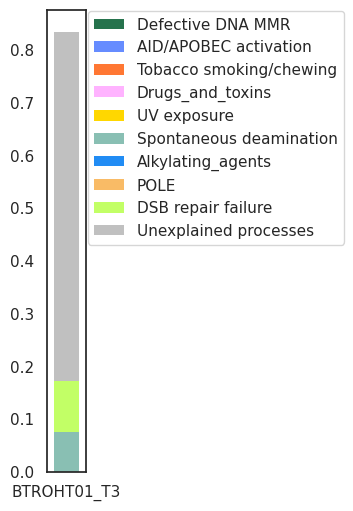

In [118]:
# run to plot mut signatures
bot_bar_plot(mut_signs, figsize=(.5,6), palette=signs_p)

In [120]:
mut_signs_BTROHT01=mut_signs

## Sequenza pp

In [27]:
# pat = 'C036'
# pp = pd.read_csv(f'/scratch/alexandra.livanova/INT/results_whole_range_wes_standard/INT_{pat}/INT_{pat}_T2/wes_sequenza/ploidy_7/gamma_5/INT_{pat}_T2/INT_{pat}_T2_alternative_solutions.txt', sep='\t')
# pd.DataFrame(pp.loc[0])

In [28]:

# pp = pd.read_csv(f'/scratch/alexandra.livanova/INT/results_20_40_wes_standard/INT_{pat}/INT_{pat}_T2/wes_sequenza/ploidy_7/gamma_5/INT_{pat}_T2/INT_{pat}_T2_alternative_solutions.txt', sep='\t')
# pd.DataFrame(pp.loc[0])

The history saving thread hit an unexpected error (OperationalError('database is locked')).History will not be written to the database.


In [32]:
pp = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT01_T3_alternative_solutions.txt', sep='\t')
pd.DataFrame(pp.loc[0])

,0
cellularity,0.760000
ploidy,2.400000
SLPP,0.611795


## Draw segments

In [13]:
segs=pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT01_T3_segments.txt', sep='\t')
chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

                          
chr_sizes = pd.DataFrame(
    {
        'hg19': pd.Series(
            {
                1: 249250621,
                2: 243199373,
                3: 198022430,
                4: 191154276,
                5: 180915260,
                6: 171115067,
                7: 159138663,
                8: 146364022,
                9: 141213431,
                10: 135534747,
                11: 135006516,
                12: 133851895,
                13: 115169878,
                14: 107349540,
                15: 102531392,
                16: 90354753,
                17: 81195210,
                18: 78077248,
                19: 59128983,
                20: 63025520,
                21: 48129895,
                22: 51304566,
                23: 155270560,
                24: 59373566,
            }
        ),
        'hg38': pd.Series(
            {
                1: 248956422,
                2: 242193529,
                3: 198295559,
                4: 190214555,
                5: 181538259,
                6: 170805979,
                7: 159345973,
                8: 145138636,
                9: 138394717,
                10: 133797422,
                11: 135086622,
                12: 133275309,
                13: 114364328,
                14: 107043718,
                15: 101991189,
                16: 90338345,
                17: 83257441,
                18: 80373285,
                19: 58617616,
                20: 64444167,
                21: 46709983,
                22: 50818468,
                23: 156040895,
                24: 57227415,
            }
        ),
    }
)

def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate=None,
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate: genes of interest for annotation in list format
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[
                   :-1
                   ]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.5
    min_h = -0.5

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)

    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate:
        annotate_draw_segments(
            ax=ax,
            cna_segments=cna_segments,
            annotate=annotate,
            chr_sizes_cs=chr_end_cs,
            ref=ref,
        )

    return ax

def annotate_draw_segments(ax, cna_segments, annotate, chr_sizes_cs, ref='hg38'):
    """
    Annotates genes of interest on draw_segments
    :param ax:
    :param cna_segments: segments file
    :param annotate: genes of interest for annotation in list format
    :param chr_sizes_cs: Cumulative sizes of chromosomes
    :param ref:
    """
    sizes_dict = chr_sizes_cs.to_dict()
    sizes_dict[0] = 0  # Needed for chr #1
    path_to_bed = '/scratch/alexandra.livanova/INT/Twist_Exome_RefSeq_targets_hg38.bed'
    cna_genes = segments2genes(cna_segments, path_to_bed)

    common_genes = list(cna_genes.index & annotate)

    hugo_bed = read_dataset(path_to_bed, header=None, index_col=None)
    hugo_bed.columns = ['chrom_n', 'Start_Position', 'End_Position', 'Hugo_Symbol']

    hugo_bed = hugo_bed[hugo_bed['chrom_n'].isin(chromosomes_list24)]
    hugo_bed['chrom_n'] = (
        hugo_bed['chrom_n']
        .str.replace('chr', '')
        .str.replace('X', '23')
        .str.replace('Y', '24')
        .astype(int)
    )
    hugo_bed = hugo_bed.set_index('Hugo_Symbol')
    for gene in common_genes:
        x = (
                hugo_bed['Start_Position'][gene]
                + sizes_dict[int(hugo_bed['chrom_n'][gene]) - 1]
        )
        y = cna_genes['total'][gene]
        arrow_position = x, y + 0.05
        text_position = x, y + 2
        ax.annotate(
            gene,
            xy=arrow_position,
            xytext=text_position,
            va="center",
            ha="center",
            arrowprops=dict(arrowstyle='-|>', color='black', lw=1),
            fontsize=14,
        )
    return ax

<Axes: >

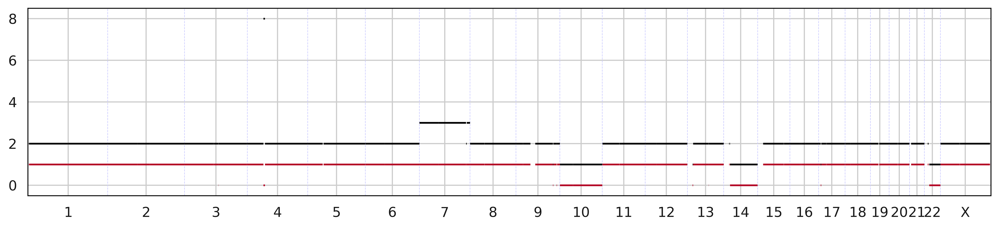

In [14]:
draw_segments(segs)

In [19]:
segs[segs['total']==20]

,chromosome,start,end,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,total,major,minor,LPP,chrom
16,chr4,50508102,54378654,0.005842,999,0.138970,30.175085,213519,27.848421,20,20,0,-6.742443,4
17,chr4,54379322,55045445,0.005260,299,0.178061,49.974729,239702,18.651043,20,20,0,-6.739502,4


In [20]:
def item_series(item, indexed=None):
    """
    Creates a series filled with item with indexes from indexed (if Series-like) or numerical indexes (size=indexed)
    :param item: value for filling
    :param indexed:
    :return:
    """
    if indexed is not None:
        if hasattr(indexed, 'index'):
            return pd.Series([item] * len(indexed), index=indexed.index)
        elif type(indexed) is int and indexed > 0:
            return pd.Series([item] * indexed, index=np.arange(indexed))
    return pd.Series()

def pivot_vectors(vec1, vec2, na_label_1=None, na_label_2=None):
    """
    Aggregates 2 vectors into a table with amount of pairs (vec1.x, vec2.y) in a cell
    Both series must have same index.
    Else different indexes values will be counted in a_label_1/na_label_2 columns if specified or ignored
    :param vec1: pd.Series
    :param vec2: pd.Series
    :param na_label_1: How to name NA column
    :param na_label_2: How to name NA row
    :return: pivot table
    """

    name1 = str(vec1.name)
    if vec1.name is None:
        name1 = 'V1'

    name2 = str(vec2.name)
    if vec2.name is None:
        name2 = 'V2'

    if name1 == name2:
        name1 += '_1'
        name2 += '_2'

    sub_df = pd.DataFrame({name1: vec1, name2: vec2})
    # FillNAs
    fill_dict = {}
    if na_label_1 is not None:
        fill_dict[name1] = na_label_1
    if na_label_2 is not None:
        fill_dict[name2] = na_label_2
    sub_df.fillna(value=fill_dict, inplace=True)

    sub_df = sub_df.assign(N=item_series(1, sub_df))

    return (
        pd.pivot_table(data=sub_df, columns=name1, index=name2, values='N', aggfunc=sum)
        .fillna(0)
        .astype(int)
    )


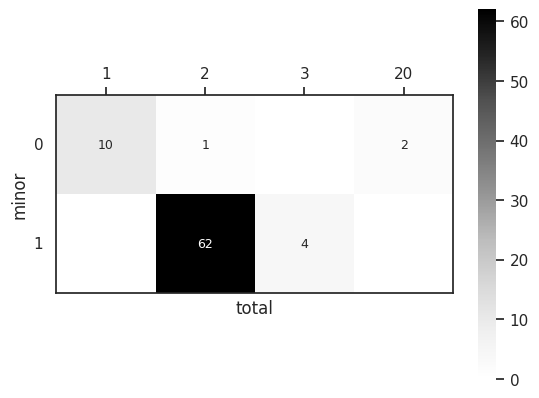

In [21]:
_, ax = plt.subplots()
pv = pivot_vectors(segs['total'], segs['minor'])
pv_annot = pv.astype(str).copy()
pv_annot[pv_annot == '0'] = ''
g = sns.heatmap( pv,  cmap='Greys', square=True, 
                annot=pv_annot.values, fmt='', annot_kws={"size": 9})
for _, spine in g.spines.items():
        spine.set_visible(True)
ax.set_yticklabels(pv.index.astype(int), rotation=0)
ax.xaxis.set_ticks_position('top')
plt.show()

## Add segments to maf

In [22]:
chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

segs['segment_n']=segs.index
segs

,chromosome,start,end,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,total,major,minor,LPP,chrom,segment_n
0,chr1,16495,2881291,0.496718,999,0.094748,0.865421,71503,0.321602,2,1,1,-6.733926,1,0
1,chr1,2881640,121745996,0.498982,51632,0.055190,0.861073,4155783,0.249092,2,1,1,-6.811298,1,1
2,chr1,121750372,124982251,0.486165,1322,0.149155,0.577013,61925,1.345589,2,1,1,-6.911873,1,2
3,chr1,125003160,248945697,0.498981,49088,0.056415,0.859952,3649219,0.263490,2,1,1,-6.830291,1,3
4,chr2,16231,93253108,0.498982,48966,0.055718,0.864830,3223674,0.252161,2,1,1,-6.746865,2,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,chr21,13202200,46689086,0.498973,19360,0.053825,0.863587,1165028,0.249609,2,1,1,-6.742565,21,74
75,chr22,10559720,12903388,0.490123,1905,0.087684,0.607473,44126,0.178262,2,1,1,-9.915780,22,75
76,chr22,15178601,50808234,0.173294,17212,0.083210,0.589216,1028194,0.186557,1,1,0,-9.716348,22,76
77,chrX,17527,60597764,0.498971,18023,0.061480,0.863524,2017008,0.252913,2,1,1,-6.750039,23,77


In [32]:
maf_final=maf_df_tissue
maf_final=maf_final[maf_final['Tumor_VAF']>0.02]
maf_final=maf_final[maf_final['t_depth']>3]
#maf_final=maf_final[maf_final['n_depth']>5]
#maf_final=maf_final[maf_final['Normal_VAF']<0.02]
maf_final=maf_final[maf_final['t_alt_count']>3]
#maf_final=maf_final[(maf_final['t_alt_count']*maf_final['Tumor_VAF'])>2]
maf_final

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
3712,STPG1,0,.,GRCh38,chr1,24391681,24391681,+,Splice_Site,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,24391681,1.0,0.050000,0.0
6652,TIE1,0,.,GRCh38,chr1,43311725,43311823,+,In_Frame_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,43311724,1.0,0.098726,0.0
12219,LRRC8D,0,.,GRCh38,chr1,89935527,89935527,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,89935527,1.0,0.458716,0.0
13460,CDC14A,0,.,GRCh38,chr1,100377621,100377621,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,100377621,1.0,0.057692,0.0
13517,SLC30A7,0,.,GRCh38,chr1,100961873,100961874,+,In_Frame_Ins,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,100961873,1.0,0.036364,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390849,CYBB,0,.,GRCh38,chrX,37793711,37793748,+,Frame_Shift_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,37793710,1.0,0.025157,0.0
394435,MTMR8,0,.,GRCh38,chrX,64345077,64345077,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,64345077,1.0,0.393939,0.0
395182,IGBP1,0,.,GRCh38,chrX,70146758,70146758,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,70146758,1.0,0.098039,0.0
395205,KIF4A,0,.,GRCh38,chrX,70374153,70374153,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,70374153,1.0,0.269737,0.0


In [34]:
import pandas as pd

# Assuming your DataFrame names are maf_final and segs
# Replace with the actual names of your DataFrames

# Sample DataFrames (replace with your actual DataFrames)
# maf_final = pd.DataFrame({'Chromosome': ['1', '2', '1', '3', '2', '3', '1', '2', '3', '1', '2', '3', '1'],
#                           'Start_Position': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200, 1300]})
# segs = pd.DataFrame({'chromosome': ['1', '2', '3', '1', '2', '3'],
#                      'start.pos': [90, 190, 290, 390, 490, 590],
#                      'end.pos': [110, 210, 310, 410, 510, 610],
#                      'CNt': [1, 2, 3, 4, 5, 6]})

# Merge DataFrames based on 'Chromosome'
merged_df = pd.merge(maf_final, segs, how='left', left_on='Chromosome', right_on='chromosome')

# Filter rows based on conditions
condition = (
    (merged_df['Start_Position'] >= merged_df['start']) &
    (merged_df['Start_Position'] <= merged_df['end'])
)

# Apply conditions and select relevant columns
result_df = merged_df[condition][['Chromosome', 'Start_Position', 'total', 'major', 'minor', 'segment_n']]

# Merge the result back to maf_final
maf_final = pd.merge(maf_final, result_df, how='left', on=['Chromosome', 'Start_Position'])

# Rename the CNt column if needed
maf_final.rename(columns={'CNt_y': 'CNt'}, inplace=True)

# Display the updated maf_final DataFrame
maf_final


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n
0,STPG1,0,.,GRCh38,chr1,24391681,24391681,+,Splice_Site,SNP,...,NaN,NaN,24391681,1.0,0.050000,0.0,2,1,1,1
1,TIE1,0,.,GRCh38,chr1,43311725,43311823,+,In_Frame_Del,DEL,...,NaN,NaN,43311724,1.0,0.098726,0.0,2,1,1,1
2,LRRC8D,0,.,GRCh38,chr1,89935527,89935527,+,Missense_Mutation,SNP,...,NaN,NaN,89935527,1.0,0.458716,0.0,2,1,1,1
3,CDC14A,0,.,GRCh38,chr1,100377621,100377621,+,Missense_Mutation,SNP,...,NaN,NaN,100377621,1.0,0.057692,0.0,2,1,1,1
4,SLC30A7,0,.,GRCh38,chr1,100961873,100961874,+,In_Frame_Ins,INS,...,NaN,NaN,100961873,1.0,0.036364,0.0,2,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,CYBB,0,.,GRCh38,chrX,37793711,37793748,+,Frame_Shift_Del,DEL,...,NaN,NaN,37793710,1.0,0.025157,0.0,2,1,1,77
197,MTMR8,0,.,GRCh38,chrX,64345077,64345077,+,Missense_Mutation,SNP,...,NaN,NaN,64345077,1.0,0.393939,0.0,2,1,1,78
198,IGBP1,0,.,GRCh38,chrX,70146758,70146758,+,Missense_Mutation,SNP,...,NaN,NaN,70146758,1.0,0.098039,0.0,2,1,1,78
199,KIF4A,0,.,GRCh38,chrX,70374153,70374153,+,Missense_Mutation,SNP,...,NaN,NaN,70374153,1.0,0.269737,0.0,2,1,1,78


In [25]:
# ploidy=4


# conditions = [
#     (maf_final['total'] >= 10),  # high amp
#     ((maf_final['total'] >= 8) & (maf_final['total'] < 10)),  # amp
#     ((maf_final['total'] >= 5) & (maf_final['total'] < 8)),  # gain
#     ((maf_final['total'] == 4) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 4) & (maf_final['minor'] == 0)),  # LOH
#     ((maf_final['total'] < 4) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

# conditions = [
#     (maf_final['total'] >= 14),  # high amp
#     ((maf_final['total'] >=12) & (maf_final['total'] < 14)),  # amp
#     ((maf_final['total'] >= 7) & (maf_final['total'] < 11)),  # gain
#     ((maf_final['total'] == 6) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 6) & (maf_final['minor'] == 0)),  # cnLOH
#     ((maf_final['total'] < 6) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

# conditions = [
#     (maf_final['total'] >= 5),  # high amp
#     (maf_final['total'] == 4),  # amp
#     (maf_final['total'] == 3),  # gain
#     ((maf_final['total'] == 2) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 2) & (maf_final['minor'] == 0)),  # cnLOH
#     (maf_final['total'] == 1),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

#ploidy=2

conditions = [
    (maf_final['total'] >= 5),  # high amp
    (maf_final['total'] == 4),  # amp
    (maf_final['total'] == 3),  # gain
    ((maf_final['total'] == 2) & (maf_final['minor'] != 0)),  # neutral
    ((maf_final['total'] == 2) & (maf_final['minor'] == 0)),  # cnLOH
    (maf_final['total'] == 1),  # Deletion
    (maf_final['total'] == 0)  # Loss
]
#ploidy=3
# conditions = [
#     (maf_final['total'] >= 8),  # high amp
#     ((maf_final['total'] >=6) & (maf_final['total'] < 8)),  # amp
#     ((maf_final['total'] >= 4) & (maf_final['total'] < 6)),  # gain
#     ((maf_final['total'] == 3) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 3) & (maf_final['minor'] == 0)),  # cnLOH
#     ((maf_final['total'] < 3) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

choices = [
    'High_amplification',
    'Amplification',
    'Gain',
    'Neutral',
    'cnLOH',
    'Deletion',
    'Loss'
]

maf_final['Segment_status'] = np.select(conditions, choices, default='Unknown')
maf_final

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n,Segment_status
0,WRAP73,0,.,GRCh38,chr1,3635071,3635071,+,Missense_Mutation,SNP,...,NaN,3635071,1.0,0.031250,0.000000,2,1,1,1,Neutral
1,MTHFR,0,.,GRCh38,chr1,11801308,11801309,+,In_Frame_Ins,INS,...,NaN,11801308,1.0,0.034091,0.000000,2,1,1,1,Neutral
2,TNFRSF1B,0,.,GRCh38,chr1,12194010,12194010,+,Missense_Mutation,SNP,...,NaN,12194010,1.0,0.023256,0.018182,2,1,1,1,Neutral
3,TNFRSF1B,0,.,GRCh38,chr1,12194016,12194016,+,Missense_Mutation,SNP,...,NaN,12194016,1.0,0.021053,0.000000,2,1,1,1,Neutral
4,HTR6,0,.,GRCh38,chr1,19665826,19665842,+,Frame_Shift_Del,DEL,...,NaN,19665825,1.0,0.051724,0.000000,2,1,1,1,Neutral
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
316,IGBP1,0,.,GRCh38,chrX,70146758,70146758,+,Missense_Mutation,SNP,...,NaN,70146758,1.0,0.098039,0.000000,2,1,1,78,Neutral
317,KIF4A,0,.,GRCh38,chrX,70374153,70374153,+,Missense_Mutation,SNP,...,NaN,70374153,1.0,0.269737,0.000000,2,1,1,78,Neutral
318,PCDH19,0,.,GRCh38,chrX,100408413,100408413,+,Missense_Mutation,SNP,...,NaN,100408413,1.0,0.052632,0.000000,2,1,1,78,Neutral
319,IL13RA1,0,.,GRCh38,chrX,118758240,118758240,+,Missense_Mutation,SNP,...,NaN,118758240,1.0,0.437500,0.000000,2,1,1,78,Neutral


In [43]:
bed=pd.read_csv('/home/alexandra.livanova/utlis_notebooks/gencode.33.hugo.bed', sep='\t', names=['chromosome', 'start', 'end', 'Hugo_Symbol'])
bed.head()

# List of genes of interest
genes_of_interest = IntOGen.IntOGen.tolist()  # Add your genes of interest here
segs['segment_n']=segs.index
# Filter segments DataFrame based on genes of interest
bed = bed[bed['Hugo_Symbol'].isin(genes_of_interest)]

# Merge bed file DataFrame with filtered segments DataFrame
merged_df = pd.merge(bed, segs, how='left', left_on='chromosome', right_on='chromosome')

# Filter rows where start and end from bed file are inside start and end of the segment
merged_df = merged_df[(merged_df['start_x'] >= merged_df['start_y']) & (merged_df['end_x'] <= merged_df['end_y'])]

# Rename columns for clarity
merged_df.rename(columns={'total': 'segment_total', 'major': 'segment_major', 'minor': 'segment_minor'}, inplace=True)

# Drop redundant columns
merged_df.drop(['chromosome', 'start_y', 'end_y'], axis=1, inplace=True)

# Print or save the resulting DataFrame
merged_df

,start_x,end_x,Hugo_Symbol,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,segment_total,segment_major,segment_minor,LPP,chrom,segment_n
0,2555638,2565382,TNFRSF14,0.496718,999,0.094748,0.865421,71503,0.321602,2,1,1,-6.733926,1,0
5,6185019,6209389,RPL22,0.498982,51632,0.055190,0.861073,4155783,0.249092,2,1,1,-6.811298,1,1
9,6785453,7769706,CAMTA1,0.498982,51632,0.055190,0.861073,4155783,0.249092,2,1,1,-6.811298,1,1
13,10636603,10796650,CASZ1,0.498982,51632,0.055190,0.861073,4155783,0.249092,2,1,1,-6.811298,1,1
17,11106534,11262551,MTOR,0.498982,51632,0.055190,0.861073,4155783,0.249092,2,1,1,-6.811298,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1813,129981106,130058083,BCORL1,0.498974,24180,0.060391,0.865644,3194740,0.254547,2,1,1,-6.741103,23,78
1815,134373252,134428791,PHF6,0.498974,24180,0.060391,0.865644,3194740,0.254547,2,1,1,-6.741103,23,78
1817,154010505,154019902,IRAK1,0.498974,24180,0.060391,0.865644,3194740,0.254547,2,1,1,-6.741103,23,78
1819,154389954,154409168,RPL10,0.498974,24180,0.060391,0.865644,3194740,0.254547,2,1,1,-6.741103,23,78


In [45]:
merged_df[merged_df['segment_total']==20]

,start_x,end_x,Hugo_Symbol,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,segment_total,segment_major,segment_minor,LPP,chrom,segment_n
1259,54229279,54298245,PDGFRA,0.005842,999,0.138970,30.175085,213519,27.848421,20,20,0,-6.742443,4,16
1265,54657917,54740715,KIT,0.005260,299,0.178061,49.974729,239702,18.651043,20,20,0,-6.739502,4,17


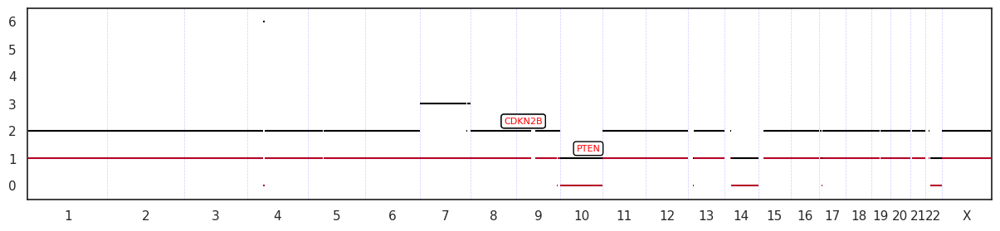

In [47]:
def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate_genes=None,
        maf_final=None,  # DataFrame containing gene information
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate_genes: genes of interest for annotation in list format
    :param maf_final: DataFrame containing gene information
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[:-1]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.5
    min_h = -0.5

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)

    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate_genes and maf_final is not None:
        annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes)

    return ax

def annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes):
    for gene in annotate_genes:
        gene_data = maf_final[maf_final['Hugo_Symbol'] == gene]
        
        if not gene_data.empty:
            gene_data = gene_data.iloc[0]  # Take the first occurrence if there are multiple entries
            segment_index = gene_data['segment_n']

            if pd.notna(segment_index):
                segment_data = cna_segments.loc[segment_index]
                chr_pos = chr_start_cs[int(segment_data['chrom'])]

                ax.annotate(
                    gene,
                    xy=((segment_data['start'] + segment_data['end']) / 2 + chr_pos, segment_data['total']),
                    xytext=(0, 5),
                    textcoords='offset points',
                    ha='center',
                    va='bottom',
                    fontsize=8,
                    color='red',  # You can customize the color
                    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'),
                )

# # Assuming 'Hugo_symbol_y' and 'segment_n' columns are present in maf_final
# # Replace 'Hugo_symbol_y' and 'segment_n' with the actual column names
# maf_final['Hugo_Symbol'] = maf_final['Hugo_Symbol'].astype(str)
# maf_final['segment_n'] = maf_final['segment_n'].astype(float)

# Assuming 'segment_n' is the column in maf_final corresponding to the index of segs
# Modify as per your actual DataFrame structure
genes_to_annotate = genes_of_interest

draw_segments(segs, annotate_genes=genes_to_annotate, maf_final=merged_df,max_cna=6, )
plt.show()


## VAF plot

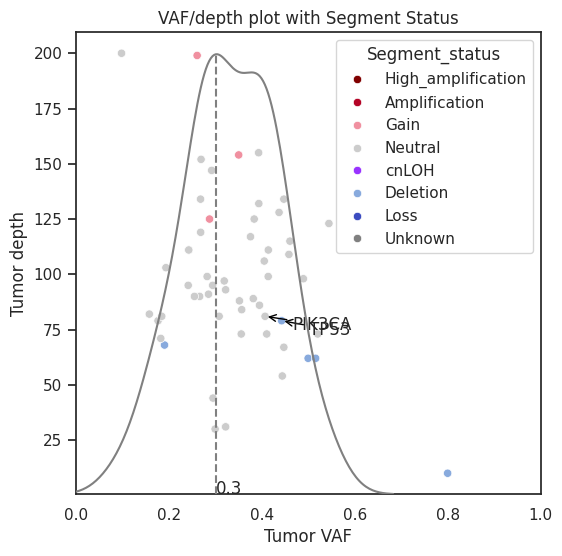

In [83]:
maf_final['t_depth']=maf_final['t_depth'].clip(0, 200)

import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="white", palette="pastel", font_scale=1)

_, ax = plt.subplots(1, 1, figsize=(6, 6))

ax = sns.scatterplot(
    data=maf_final,
    x='Tumor_VAF',
    y='t_depth',
    hue='Segment_status',
    palette={
        'High_amplification': '#800000',
        'Amplification': '#b40426',
        'Gain': '#F090A0',
        'Neutral': '#cccccc',
        'cnLOH': '#9933ff',
        'Deletion': '#88AADD',
        'Loss': '#3b4cc0',
        'Unknown': 'grey'
    },
    hue_order=[
        'High_amplification',
        'Amplification',
        'Gain',
        'Neutral',
        'cnLOH',
        'Deletion',
        'Loss',
        'Unknown'
    ]
)
plt.title('VAF/depth plot with Segment Status')
ax.set_xlabel('Tumor VAF')
ax.set_ylabel('Tumor depth')
ax.set_xlim(0, 1)

ax2 = ax.twinx()
sns.kdeplot(
    maf_final[maf_final['Segment_status']=='Neutral'].Tumor_VAF.astype(float), ax=ax2, color='grey', legend=False
)

line = ax2.get_lines()[0].get_data()
neutral_peak = line[0][line[1].argmax()]
ax2.vlines(
    neutral_peak, ymin=0, ymax=line[1].max(), colors='grey', linestyles='--'
)
ax2.text(neutral_peak, 0, neutral_peak.round(2))

# Annotate one dot with a line and label
for gene in ['TP53', 'PIK3CA']:
    point_to_annotate = maf_final[maf_final['Hugo_Symbol'] == gene].iloc[0]
    ax.annotate(
        text=point_to_annotate['Hugo_Symbol'],
        xy=(point_to_annotate['Tumor_VAF'], point_to_annotate['t_depth']),
        xytext=(20, -10),
        textcoords='offset points',
        arrowprops=dict(arrowstyle='->', color='black')
    )




ax2.axis('off')
plt.show()


In [99]:
cell_fraction_by_alt_copy_vaf(0.3, 3, 2)

0.3529411764705882

## Driver mutations

In [35]:
cols=['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification',
      'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]

maf_final2=maf_final[maf_final.Hugo_Symbol.isin(Martincorena.Martincorena.tolist())]
maf_final2[cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,total,major,minor,t_depth,t_alt_count
5,NUP210L,p.C616W,0.056818,0.056818,Missense_Mutation,2,1,1,88,5
55,ZFHX3,p.R712W,0.357143,0.357143,Missense_Mutation,2,1,1,84,30
59,TP53,p.P27S,0.443038,0.443038,Missense_Mutation,1,1,0,79,35
126,PIK3CA,p.N107S,0.407407,0.407407,Missense_Mutation,2,1,1,81,33
140,PIK3R1,p.L449*,0.544715,0.544715,Nonsense_Mutation,2,1,1,123,67
150,HLA-C,p.C350S,0.142857,0.142857,Missense_Mutation,2,1,1,63,9
168,MUC17,p.T4490M,0.261307,0.261307,Missense_Mutation,3,2,1,199,52
182,UBR5,p.E399D,0.040816,0.040816,Missense_Mutation,2,1,1,98,4
194,CRLF2,p.G351Wfs*2,0.035714,0.035714,Frame_Shift_Ins,2,1,1,112,4


In [36]:
cols=['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification','dbSNP_RS',
      'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]

maf_final3=maf_final[maf_final.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
maf_final3[cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,dbSNP_RS,total,major,minor,t_depth,t_alt_count
6,ARHGEF11,p.X1365_splice,0.030075,0.030075,Splice_Site,novel,2,1,1,133,4
48,USP8,p.L305F,0.060241,0.060241,Missense_Mutation,novel,2,1,1,83,5
55,ZFHX3,p.R712W,0.357143,0.357143,Missense_Mutation,novel,2,1,1,84,30
59,TP53,p.P27S,0.443038,0.443038,Missense_Mutation,rs922736614,1,1,0,79,35
97,SCN9A,p.X87_splice,0.268908,0.268908,Splice_Site,novel,2,1,1,119,32
101,ACSL3,p.Y351Sfs*8,0.243243,0.243243,Frame_Shift_Ins,novel,2,1,1,111,27
102,ACSL3,p.Y351*,0.243243,0.243243,Nonsense_Mutation,novel,2,1,1,111,27
103,ACSL3,p.E479V,0.034783,0.034783,Missense_Mutation,novel,2,1,1,115,4
110,SUSD2,p.R250W,0.057971,0.057971,Missense_Mutation,rs529707119,1,1,0,69,4
126,PIK3CA,p.N107S,0.407407,0.407407,Missense_Mutation,NaN,2,1,1,81,33


In [37]:
write_dataset(maf_final3[cols], 'BTROHT01_somatic_mut.tsv')

In [68]:
maf_final2['Hugo_Symbol'].to_list()

['ZFHX3', 'TP53', 'PIK3CA', 'PIK3R1', 'HLA-C', 'MUC17']

In [69]:
maf_final[maf_final['Hugo_Symbol']=='FLT3LG'][cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,total,major,minor,t_depth,t_alt_count


In [20]:
cell_fraction_by_alt_copy_vaf(0.44, 1, 1)

0.6111111111111112

## CLonality in organoids

In [78]:
from statsmodels.stats.proportion import proportion_confint

def add_clonality_status(
    maf,
    gender = 'female',
    purity = None,
    sub_clone_purity_threshold = None,
    ccf_threshold = 0.7,
    count_threshold= 1,
    t_alt_count= 1,
    n_depth= 1
):
    """
    Add column to maf with clonal/subclonal status

    :param maf: pd.DataFrame
    :param gender:  str 'male'/'female' or None
    :param purity: float, 0 <= purity <= 1
    :param sub_clone_purity_threshold: float, 0 <= purity <= 1
    :param ccf_threshold: float, 0 <= ccf_threshold <= 1
    :param count_threshold: int, 0 <= count_threshold <= 100
    :param t_alt_count: int 0 <= t_alt_count < Inf
    :param n_depth: int 0 <= n_depth < Inf

    :return: pd.DataFrame
    """
    if purity is None:
        print('Please insert putity')
        purity = estimate_purity(maf, t_alt_count, n_depth)
    if sub_clone_purity_threshold is not None and purity < sub_clone_purity_threshold:
        maf['Clonality_status'] = 'Clonal'
    else:
        if gender is None:
            logging.warning('Gender was not provided, estimate mutaton will be calculated with default "female" branch')
            gender = ''
        maf['Clonality_status'] = maf.apply(
            lambda x: estimate_ccf(x, gender.lower(), purity, ccf_threshold, count_threshold),
            axis=1,
        )
    return maf

def estimate_ccf(variant, gender, purity, ccf_threshold, count_threshold):
    """
    Estimate clonal/subclonal mutaton

    :param variant: pd.Series or dict, row from maf
    :param gender: str 'male' or 'female' or ''
    :param purity: float, 0 <= purity <= 1
    :param ccf_threshold: float, 0 <= ccf_threshold <= 1
    :param count_threshold: int, 0 <= count_threshold <= 100

    :return: str
    """
    if pd.isnull(variant['t_depth']) or pd.isnull(variant['t_alt_count']):
        return 'Unable to call clonality'

    vaf_ci = proportion_confint(
        variant['t_alt_count'], variant['t_depth'], method='wilson'
    )

    chr_count = 2
    if gender == 'male' and variant['Chromosome'] in {'chrX', 'chrY'}:
        chr_count = 1
    ccfs = (np.linspace(vaf_ci[0], vaf_ci[1], 100).reshape(1, -1) / purity) * (
        (1 - purity) * chr_count + purity * variant['total']
    )

    if np.count_nonzero(ccfs[0] >= ccf_threshold) >= count_threshold:
        return 'Clonal'
    elif np.count_nonzero(ccfs[0] < ccf_threshold) >= count_threshold:
        return 'Subclonal'
    else:
        return 'Unable to call clonality'

In [81]:
add_clonality_status(maf_final, purity=0.99)

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,vcf_pos,mappability,Tumor_VAF,Normal_VAF,total,major,minor,segment_n,Segment_status,Clonality_status
0,SZRD1,0,.,GRCh38,chr1,16393286,16393286,+,Missense_Mutation,SNP,...,16393286,NaN,0.266667,NaN,2.0,1.0,1.0,0.0,Deletion,Clonal
1,ARHGEF10L,0,.,GRCh38,chr1,17613095,17613095,+,Missense_Mutation,SNP,...,17613095,NaN,0.333333,NaN,2.0,1.0,1.0,0.0,Deletion,Clonal
2,HSPG2,0,.,GRCh38,chr1,21824562,21824563,+,Missense_Mutation,DNP,...,21824562,NaN,0.243902,NaN,2.0,1.0,1.0,0.0,Deletion,Clonal
3,ARID1A,0,.,GRCh38,chr1,26697078,26697079,+,Missense_Mutation,DNP,...,26697078,NaN,0.348837,NaN,2.0,1.0,1.0,0.0,Deletion,Clonal
4,ARID1A,0,.,GRCh38,chr1,26697083,26697083,+,Missense_Mutation,SNP,...,26697083,NaN,0.318182,NaN,2.0,1.0,1.0,0.0,Deletion,Clonal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,MAGEB2,0,.,GRCh38,chrX,30218702,30218702,+,Missense_Mutation,SNP,...,30218702,NaN,0.369231,NaN,4.0,4.0,0.0,43.0,Gain,Clonal
299,BCOR,0,.,GRCh38,chrX,40063889,40063889,+,Missense_Mutation,SNP,...,40063889,NaN,0.296875,NaN,4.0,4.0,0.0,43.0,Gain,Clonal
300,BCOR,0,.,GRCh38,chrX,40063892,40063892,+,Missense_Mutation,SNP,...,40063892,NaN,0.296875,NaN,4.0,4.0,0.0,43.0,Gain,Clonal
301,ZNF81,0,.,GRCh38,chrX,47895928,47895928,+,Nonsense_Mutation,SNP,...,47895928,NaN,0.440000,NaN,4.0,4.0,0.0,43.0,Gain,Clonal


In [ ]:
clon_in_orgs=maf_final.Clonality_status
clon_in_orgs

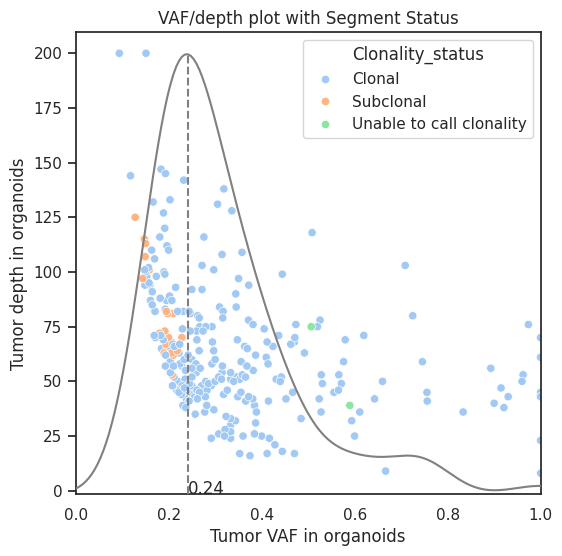

In [82]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="white", palette="pastel", font_scale=1)

_, ax = plt.subplots(1, 1, figsize=(6, 6))

ax = sns.scatterplot(
    data=maf_final,
    x='Tumor_VAF',
    y='t_depth',
    hue='Clonality_status',

)
plt.title('VAF/depth plot with Segment Status')
ax.set_xlabel('Tumor VAF in organoids')
ax.set_ylabel('Tumor depth in organoids')
ax.set_xlim(0, 1)

ax2 = ax.twinx()
sns.kdeplot(
    maf_final[maf_final['Segment_status']=='Neutral'].Tumor_VAF.astype(float), ax=ax2, color='grey', legend=False
)

line = ax2.get_lines()[0].get_data()
neutral_peak = line[0][line[1].argmax()]
ax2.vlines(
    neutral_peak, ymin=0, ymax=line[1].max(), colors='grey', linestyles='--'
)
ax2.text(neutral_peak, 0, neutral_peak.round(2))

# Annotate one dot with a line and label
# for gene in maf_final[maf_final.Hugo_Symbol_y.isin(Martincorena.Martincorena.tolist())]['Hugo_Symbol_y']:
#     point_to_annotate = maf_final[maf_final['Hugo_Symbol_y'] == gene].iloc[0]
#     ax.annotate(
#         text=point_to_annotate['Hugo_Symbol_y'],
#         xy=(point_to_annotate['Tumor_VAF_x'], point_to_annotate['t_depth_x']),
#         xytext=(20, -10),
#         textcoords='offset points',
#         arrowprops=dict(arrowstyle='->', color='black')
#     )




ax2.axis('off')
plt.show()


In [83]:
cols=['Chromosome', 'Hugo_Symbol',
 'HGVSp_Short',
 'Tumor_VAF',
 'Tumor_VAF',
 'Variant_Classification',
 'total',
 'major',
 'minor',
 't_depth',
 't_alt_count']

In [84]:
maf_final[maf_final['Clonality_status']=='Subclonal'][cols]

,Chromosome,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,total,major,minor,t_depth,t_alt_count
15,chr1,SMG5,p.V392I,0.128000,0.128000,Missense_Mutation,3.0,2.0,1.0,125,16
31,chr10,RRP12,p.I282V,0.147826,0.147826,Missense_Mutation,3.0,2.0,1.0,115,17
85,chr14,ABHD4,p.S139T,0.209677,0.209677,Missense_Mutation,2.0,2.0,0.0,62,13
86,chr14,PRMT5,p.R91H,0.194030,0.194030,Missense_Mutation,2.0,2.0,0.0,67,13
96,chr14,SLC8A3,p.A753V,0.228571,0.228571,Missense_Mutation,2.0,2.0,0.0,70,16
97,chr14,UNC79,p.E795D,0.190476,0.190476,Missense_Mutation,2.0,2.0,0.0,63,12
109,chr15,FBXO22,p.S273T,0.206349,0.206349,Missense_Mutation,2.0,2.0,0.0,63,13
110,chr16,RBFOX1,p.A243G,0.207547,0.207547,Missense_Mutation,2.0,2.0,0.0,53,11
114,chr16,TNRC6A,p.N1640S,0.209877,0.209877,Missense_Mutation,2.0,2.0,0.0,81,17
117,chr16,SRCAP,p.R2002H,0.200000,0.200000,Missense_Mutation,2.0,2.0,0.0,70,14


In [76]:
maf_final.columns

Index(['Hugo_Symbol', 'Entrez_Gene_Id', 'Center', 'NCBI_Build', 'Chromosome',
       'Start_Position', 'End_Position', 'Strand', 'Variant_Classification',
       'Variant_Type',
       ...
       'vcf_pos', 'mappability', 'Tumor_VAF', 'Normal_VAF', 'total', 'major',
       'minor', 'segment_n', 'Segment_status', 'Clonality_status'],
      dtype='object', length=123)

## CLonality in tissue

In [86]:
from statsmodels.stats.proportion import proportion_confint

def add_clonality_status(
    maf,
    gender = 'female',
    purity = None,
    sub_clone_purity_threshold = None,
    ccf_threshold = 0.7,
    count_threshold= 1,
    t_alt_count= 1,
    n_depth= 1
):
    """
    Add column to maf with clonal/subclonal status

    :param maf: pd.DataFrame
    :param gender:  str 'male'/'female' or None
    :param purity: float, 0 <= purity <= 1
    :param sub_clone_purity_threshold: float, 0 <= purity <= 1
    :param ccf_threshold: float, 0 <= ccf_threshold <= 1
    :param count_threshold: int, 0 <= count_threshold <= 100
    :param t_alt_count: int 0 <= t_alt_count < Inf
    :param n_depth: int 0 <= n_depth < Inf

    :return: pd.DataFrame
    """
    if purity is None:
        print('Please insert putity')
        purity = estimate_purity(maf, t_alt_count, n_depth)
    if sub_clone_purity_threshold is not None and purity < sub_clone_purity_threshold:
        maf['Clonality_status'] = 'Clonal'
    else:
        if gender is None:
            logging.warning('Gender was not provided, estimate mutaton will be calculated with default "female" branch')
            gender = ''
        maf['Clonality_status'] = maf.apply(
            lambda x: estimate_ccf(x, gender.lower(), purity, ccf_threshold, count_threshold),
            axis=1,
        )
    return maf

def estimate_ccf(variant, gender, purity, ccf_threshold, count_threshold):
    """
    Estimate clonal/subclonal mutaton

    :param variant: pd.Series or dict, row from maf
    :param gender: str 'male' or 'female' or ''
    :param purity: float, 0 <= purity <= 1
    :param ccf_threshold: float, 0 <= ccf_threshold <= 1
    :param count_threshold: int, 0 <= count_threshold <= 100

    :return: str
    """
    if pd.isnull(variant['t_depth']) or pd.isnull(variant['t_alt_count']):
        return 'Unable to call clonality'

    vaf_ci = proportion_confint(
        variant['t_alt_count'], variant['t_depth'], method='wilson'
    )

    chr_count = 2
    if gender == 'male' and variant['Chromosome'] in {'chrX', 'chrY'}:
        chr_count = 1
    ccfs = (np.linspace(vaf_ci[0], vaf_ci[1], 100).reshape(1, -1) / purity) * (
        (1 - purity) * chr_count + purity * variant['total']
    )

    if np.count_nonzero(ccfs[0] >= ccf_threshold) >= count_threshold:
        return 'Clonal'
    elif np.count_nonzero(ccfs[0] < ccf_threshold) >= count_threshold:
        return 'Subclonal'
    else:
        return 'Unable to call clonality'

In [87]:
add_clonality_status(maf_final, purity=0.76)

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n,Segment_status,Clonality_status
0,TIE1,0,.,GRCh38,chr1,43311725,43311823,+,In_Frame_Del,DEL,...,43311724,1.00,0.098726,0.000000,2,1,1,1,Neutral,Subclonal
1,LRRC8D,0,.,GRCh38,chr1,89935527,89935527,+,Missense_Mutation,SNP,...,89935527,1.00,0.458716,0.000000,2,1,1,1,Neutral,Clonal
2,C1orf100,0,.,GRCh38,chr1,244364719,244364719,+,Nonsense_Mutation,SNP,...,244364719,1.00,0.308642,0.000000,2,1,1,3,Neutral,Clonal
3,R3HCC1L,0,.,GRCh38,chr10,98208188,98208188,+,Missense_Mutation,SNP,...,98208188,1.00,0.500000,0.000000,1,1,0,42,Deletion,Clonal
4,CFAP46,0,.,GRCh38,chr10,132860460,132860460,+,Nonsense_Mutation,SNP,...,132860460,1.00,0.516129,0.000000,1,1,0,42,Deletion,Clonal
5,OR5M9,0,.,GRCh38,chr11,56462729,56462729,+,Missense_Mutation,SNP,...,56462729,1.00,0.405660,0.000000,2,1,1,44,Neutral,Clonal
6,PCF11,0,.,GRCh38,chr11,83168446,83168446,+,Missense_Mutation,SNP,...,83168446,1.00,0.447761,0.000000,2,1,1,44,Neutral,Clonal
7,DSCAML1,0,.,GRCh38,chr11,117431596,117431596,+,Missense_Mutation,SNP,...,117431596,1.00,0.414414,0.000000,2,1,1,44,Neutral,Clonal
8,PFKM,0,.,GRCh38,chr12,48133402,48133402,+,Missense_Mutation,SNP,...,48133402,1.00,0.382022,0.000000,2,1,1,46,Neutral,Clonal
9,TRHDE,0,.,GRCh38,chr12,72272705,72272705,+,Missense_Mutation,SNP,...,72272705,1.00,0.322581,0.000000,2,1,1,46,Neutral,Clonal


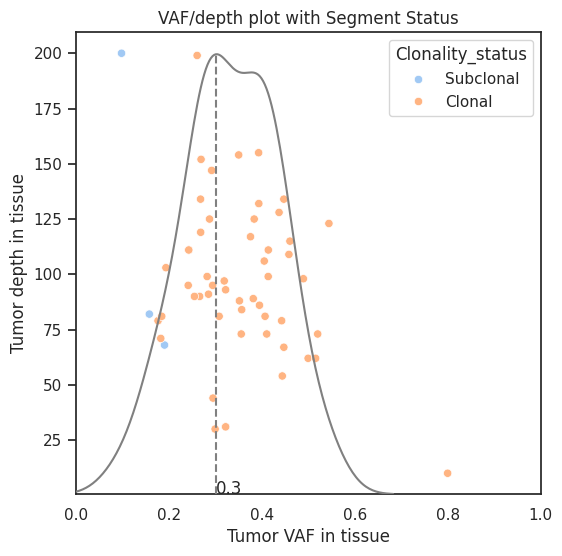

In [90]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="white", palette="pastel", font_scale=1)

_, ax = plt.subplots(1, 1, figsize=(6, 6))

ax = sns.scatterplot(
    data=maf_final,
    x='Tumor_VAF',
    y='t_depth',
    hue='Clonality_status',

)
plt.title('VAF/depth plot with Segment Status')
ax.set_xlabel('Tumor VAF in tissue')
ax.set_ylabel('Tumor depth in tissue')
ax.set_xlim(0, 1)

ax2 = ax.twinx()
sns.kdeplot(
    maf_final[maf_final['Segment_status']=='Neutral'].Tumor_VAF.astype(float), ax=ax2, color='grey', legend=False
)

line = ax2.get_lines()[0].get_data()
neutral_peak = line[0][line[1].argmax()]
ax2.vlines(
    neutral_peak, ymin=0, ymax=line[1].max(), colors='grey', linestyles='--'
)
ax2.text(neutral_peak, 0, neutral_peak.round(2))

# Annotate one dot with a line and label
# for gene in maf_final[maf_final.Hugo_Symbol_y.isin(Martincorena.Martincorena.tolist())]['Hugo_Symbol_y']:
#     point_to_annotate = maf_final[maf_final['Hugo_Symbol_y'] == gene].iloc[0]
#     ax.annotate(
#         text=point_to_annotate['Hugo_Symbol_y'],
#         xy=(point_to_annotate['Tumor_VAF_y'], point_to_annotate['t_depth_y']),
#         xytext=(20, -10),
#         textcoords='offset points',
#         arrowprops=dict(arrowstyle='->', color='black')
#     )




ax2.axis('off')
plt.show()


# CNA

In [14]:
import pybedtools

,chromosome,start,end,Hugo_Symbol
0,chr1,11868,14409,DDX11L1
1,chr1,14403,29570,WASH7P
2,chr1,17368,17436,MIR6859-1
3,chr1,29553,31109,MIR1302-2HG
4,chr1,30365,30503,MIR1302-2


,start_x,end_x,Hugo_Symbol,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,segment_total,segment_major,segment_minor,LPP,chrom,segment_n
1,39687913,39730426,ERBB2,0.174646,299,0.157236,3.17962,72232,5.442033,11,9,2,-6.745523,17,32


In [78]:
draw_segments(segs, annotate=['ERBB2'], maf_final=merged_df)

TypeError: draw_segments() got an unexpected keyword argument 'maf_final'

In [65]:
bed[bed['Hugo_symbol']=='ERBB2']

,chrom,start,end,Hugo_symbol
24165,chr17,39687913,39730426,ERBB2


In [ ]:
# List of genes of interest
genes_of_interest = ['gene1', 'gene2', 'gene3']  # Add your genes of interest here

# Filter segments DataFrame based on genes of interest
filtered_segs_df = segs_df[segs_df['chromosome'].isin(bed_df['chrom'])]

# Merge bed file DataFrame with filtered segments DataFrame
merged_df = pd.merge(bed_df, filtered_segs_df, how='left', left_on='chrom', right_on='chromosome')

# Filter rows where start and end from bed file are inside start and end of the segment
merged_df = merged_df[(merged_df['start_x'] >= merged_df['start_y']) & (merged_df['end_x'] <= merged_df['end_y'])]

# Rename columns for clarity
merged_df.rename(columns={'total': 'segment_total', 'major': 'segment_major', 'minor': 'segment_minor'}, inplace=True)

# Drop redundant columns
merged_df.drop(['chromosome', 'start_y', 'end_y'], axis=1, inplace=True)

# Print or save the resulting DataFrame
print(merged_df)

In [18]:
def segments2genes(segments, genes_bed_path='/home/alexandra.livanova/utlis_notebooks/gencode.33.hugo.bed', fraction_intersection=0.1):
    """
    Calculates cna status for each gene according to the annotation. Returns a DataFrame with important columns
    :param segments:
    :param genes_bed_path: Try /home/jupyter/mvp-data/git/local_databases/CNA/gencode.v22.genes.bed
    :param fraction_intersection: overlap between gene and segment is required to be at least this fraction of
                                  a segment, otherwise, it will be deleted.
    :return:
    """
    import pybedtools

    col_ofi = [
        'chrom',
        'start',
        'end',
     #   'c_fraction',
        'total',
        'minor',
      #  'segment_type',
      #  'margin_segments',
      #  'segment_cna_status',
      #  'segment_cna_combined',
      #  'LOH',
    ]
    out_cols = [
        'total',
        'minor',
     #   'segment_type',
     #   'margin_segments',
     #   'segment_cna_status',
     #   'segment_cna_combined',
     #   'LOH',
    ]

    gene_annotation_bed = pybedtools.BedTool(genes_bed_path)

    c_segments = segments[col_ofi]
    c_segments = c_segments.assign(
        chrom='chr' + c_segments['chrom'].astype(str).replace('23', 'X')
    )
    c_seg_bed = pybedtools.BedTool.from_dataframe(c_segments)

    intersect_df = c_seg_bed.intersect(
        gene_annotation_bed, F=fraction_intersection, wo=True
    ).to_dataframe(header=None)
    intersect_df.columns = col_ofi + [
        'ga_chr',
        'ga_start_gene',
        'ga_end_gene',
        'Hugo_symbol',
        'ga_intersection_len',
    ]
    # Filter out duplicate genes
    intersect_df = intersect_df.sort_values(
        'ga_intersection_len', ascending=True
    ).drop_duplicates('Hugo_symbol', keep='last')
    # Sort by genomic order
    intersect_df = intersect_df.set_index('Hugo_symbol').sort_values(
        ['chrom', 'ga_start_gene']
    )

    pybedtools.cleanup()

    return intersect_df[out_cols]

In [21]:
import os 
os.getenv('PATH')

'/home/alexandra.livanova/miniconda3/envs/atac_env_310/bin:/home/alexandra.livanova/miniconda3/condabin:/cm/local/apps/gcc/10.2.0/bin:/home/alexandra.livanova/.local/bin:/home/alexandra.livanova/bin:/cm/shared/apps/slurm/current/sbin:/cm/shared/apps/slurm/current/bin:/cm/local/apps/environment-modules/4.5.3/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/bin:/sbin:/usr/sbin:/cm/local/apps/environment-modules/4.5.3/bin:/opt/dell/srvadmin/bin:.'

In [38]:
! echo $PATH

/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/:/home/alexandra.livanova/miniconda3/envs/atac_env_310/bin:/home/alexandra.livanova/miniconda3/condabin:/cm/local/apps/gcc/10.2.0/bin:/home/alexandra.livanova/.local/bin:/home/alexandra.livanova/bin:/cm/shared/apps/slurm/current/sbin:/cm/shared/apps/slurm/current/bin:/cm/local/apps/environment-modules/4.5.3/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/bin:/sbin:/usr/sbin:/cm/local/apps/environment-modules/4.5.3/bin:/opt/dell/srvadmin/bin:.


In [37]:
import os

# Directory containing the bedtools executable
bedtools_dir = "/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/"

# Get the current PATH variable
current_path = os.environ.get('PATH', '')

# Append the bedtools directory to the current PATH
new_path = f"{bedtools_dir}:{current_path}"

# Update the PATH environment variable
os.environ['PATH'] = new_path

In [26]:
! module load bcftools

Loading bcftools/1.14-python-3.9.10
  Loading requirement: bzip2/1.0.6 curl/7.61.1 libdeflate/1.9 xz/5.2.4
    zlib/1.2.11 htslib/1.14 berkeley-db/5.3.28 gdbm/1.18 perl/5.34.0
    libpng/1.6.34 freetype/2.11.1-libpng-1.6.34 expat/2.2.5 libiconv/1.16
    libxml2/2.9.7 ncurses/6.2 tar/1.30 gettext/0.20.2 libffi/3.4.2
    openssl/1.1.1g readline/7.0 sqlite/3.26.0 tcl/8.6.8 tk/8.6.8
    util-linux-uuid/2.37.4 python/3.9.10 python-3.9.10/py-cycler/0.11.0
    python-3.9.10/py-fonttools/4.31.2 python-3.9.10/py-kiwisolver/1.3.2
    intel-oneapi-tbb/2021.4.0 intel-oneapi-mkl/2021.4.0
    python-3.9.10/py-setuptools/59.4.0
    python-3.9.10/py-numpy/1.22.4-intel-oneapi-mkl-2021.4.0
    python-3.9.10/py-pyparsing/3.0.6 python-3.9.10/py-packaging/21.3 libjpeg/9d
    python-3.9.10/py-pillow/9.0.0 python-3.9.10/py-six/1.16.0
    python-3.9.10/py-python-dateutil/2.8.2 qhull/2020.2
    py-matplotlib/3.5.2-intel-oneapi-mkl-2021.4.0
>

In [34]:
! export PATH="/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/:$PATH"

In [ ]:
/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/bedtools

In [35]:
%%bash 
bedtools --version

bash: line 1: bedtools: command not found


CalledProcessError: Command 'b'bedtools --version\n'' returned non-zero exit status 127.

In [36]:
import pybedtools

col_ofi = [
        'chrom',
        'start',
        'end',
     #   'c_fraction',
        'total',
        'minor',
      #  'segment_type',
      #  'margin_segments',
      #  'segment_cna_status',
      #  'segment_cna_combined',
      #  'LOH',
    ]
out_cols = [
        'total',
        'minor',
     #   'segment_type',
     #   'margin_segments',
     #   'segment_cna_status',
     #   'segment_cna_combined',
     #   'LOH',
    ]

gene_annotation_bed = pybedtools.BedTool('/home/alexandra.livanova/utlis_notebooks/gencode.33.hugo.bed')

c_segments = segs[col_ofi]
c_segments = c_segments.assign(
        chrom='chr' + c_segments['chrom'].astype(str).replace('23', 'X')
    )
c_seg_bed = pybedtools.BedTool.from_dataframe(c_segments)

intersect_df = c_seg_bed.intersect(
        gene_annotation_bed, F=0.1, wo=True
    ).to_dataframe(header=None)
intersect_df.columns = col_ofi + [
        'ga_chr',
        'ga_start_gene',
        'ga_end_gene',
        'Hugo_symbol',
        'ga_intersection_len',
    ]
    # Filter out duplicate genes
intersect_df = intersect_df.sort_values(
        'ga_intersection_len', ascending=True
    ).drop_duplicates('Hugo_symbol', keep='last')
    # Sort by genomic order
intersect_df = intersect_df.set_index('Hugo_symbol').sort_values(
        ['chrom', 'ga_start_gene']
    )

pybedtools.cleanup()
intersect_df

NotImplementedError: "intersectBed" does not appear to be installed or on the path, so this method is disabled.  Please install a more recent version of BEDTools and re-import to use this method.

In [44]:
%%bash
source ~/.bashrc
conda activate atac_env_310
module load bedtools2/2.31.0
which bedtools
#bedtools2 --version

Loading bedtools2/2.31.0
  Loading requirement: bzip2/1.0.6 xz/5.2.4 zlib/1.2.11


/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/bedtools


In [49]:
%%bash
bedtools --version

bash: line 1: bedtools: command not found


CalledProcessError: Command 'b'bedtools --version\n'' returned non-zero exit status 127.

In [47]:
import os
print(os.environ['PATH'])

/home/alexandra.livanova/miniconda3/envs/atac_env_310/bin:/home/alexandra.livanova/miniconda3/condabin:/cm/local/apps/gcc/10.2.0/bin:/home/alexandra.livanova/.local/bin:/home/alexandra.livanova/bin:/cm/shared/apps/slurm/current/sbin:/cm/shared/apps/slurm/current/bin:/cm/local/apps/environment-modules/4.5.3/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/bin:/sbin:/usr/sbin:/cm/local/apps/environment-modules/4.5.3/bin:/opt/dell/srvadmin/bin:.:/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/bedtools:/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/bedtools:/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/bedtools


In [46]:
import os
os.environ['PATH'] += ":/share/apps/spack/latest-2024-01-17/linux-centos8-skylake_avx512/gcc-8.4.1/bedtools2-2.31.0-lwolrzblk6ulmxih5wlgp4devyglt4nd/bin/bedtools"

In [48]:
segments2genes(segs)

NotImplementedError: "intersectBed" does not appear to be installed or on the path, so this method is disabled.  Please install a more recent version of BEDTools and re-import to use this method.

# BTROHT02

In [77]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/mutect/BTROHT02_T2.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,ENST00000466430,0,.,GRCh38,chr1,103299,103299,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103299,0.47
1,ENST00000471248,0,.,GRCh38,chr1,124846,124847,+,Intron,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,124845,0.81
2,ENST00000669836,0,.,GRCh38,chr1,264681,264681,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,264681,1.00
3,ENST00000669836,0,.,GRCh38,chr1,268465,268465,+,RNA,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,268465,1.00
4,ENST00000669836,0,.,GRCh38,chr1,269239,269240,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,269239,0.99
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275742,Unknown,0,.,GRCh38,chrY,56883761,56883761,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883761,NaN
275743,Unknown,0,.,GRCh38,chrY,56884023,56884024,+,IGR,DNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884023,NaN
275744,Unknown,0,.,GRCh38,chrY,56885448,56885448,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56885448,NaN
275745,Unknown,0,.,GRCh38,chrY,56886030,56886030,+,IGR,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886029,NaN


In [78]:
maf_df_tissue['Tumor_VAF']=maf_df_tissue['t_alt_count']/maf_df_tissue['t_depth']
maf_df_tissue['Normal_VAF']=maf_df_tissue['n_alt_count']/maf_df_tissue['n_depth']

maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']

maf_df_tissue = maf_df_tissue[maf_df_tissue.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
 'Missense_Mutation',
 'Frame_Shift_Ins',
 'Frame_Shift_Del',
 'Nonsense_Mutation',
 'Nonstop_Mutation',
 'Translation_Start_Site',
 'Splice_Site', 
                                                                         "5'Flank", "3'Flank",'Splice_Region',"5'UTR" 
                                                                        ])]
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
5,ENST00000669836,0,.,GRCh38,chr1,269371,269371,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,269371,0.24,0.090909,0.0
6,ENST00000669836,0,.,GRCh38,chr1,271443,271443,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,271443,1.00,0.227273,0.0
44,FAM41C,0,.,GRCh38,chr1,878068,878068,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,878068,0.95,0.039216,0.0
48,FAM41C,0,.,GRCh38,chr1,879778,879778,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,879778,1.00,0.098361,0.0
70,SAMD11,0,.,GRCh38,chr1,943022,943022,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,943022,1.00,0.068966,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
274588,TTTY25P,0,.,GRCh38,chrY,22328737,22328737,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,22328737,NaN,0.074074,0.0
274603,CYCSP48,0,.,GRCh38,chrY,26403083,26403083,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,26403083,NaN,0.214286,0.0
274604,CYCSP48,0,.,GRCh38,chrY,26403099,26403100,+,3'Flank,DNP,...,NaN,NaN,NaN,NaN,NaN,NaN,26403099,NaN,0.230769,0.0
275646,CTBP2P1,0,.,GRCh38,chrY,56852449,56852450,+,5'Flank,DNP,...,NaN,NaN,NaN,NaN,NaN,NaN,56852449,NaN,0.131579,0.0


In [342]:
maf_onco_02=maf_df_tissue[maf_df_tissue.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
maf_onco_02['Patient']='BTROHT02'

In [343]:
maf_onco_02

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,Patient
177,TNFRSF14,0,.,GRCh38,chr1,2556375,2556375,+,5'UTR,SNP,...,NaN,NaN,NaN,NaN,NaN,2556375,1.00,0.111111,0.0,BTROHT02
1799,ARHGEF10L,0,.,GRCh38,chr1,17701548,17701548,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,17701548,1.00,0.111111,0.0,BTROHT02
4542,STIL,0,.,GRCh38,chr1,47281210,47281210,+,Splice_Site,SNP,...,NaN,NaN,NaN,NaN,NaN,47281210,1.00,0.066667,0.0,BTROHT02
16214,PDE4DIP,0,.,GRCh38,chr1,149033731,149033731,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,149033731,0.86,0.051724,0.0,BTROHT02
17003,ARHGEF11,0,.,GRCh38,chr1,157045333,157045333,+,5'UTR,SNP,...,NaN,NaN,NaN,NaN,NaN,157045333,1.00,0.049180,0.0,BTROHT02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265009,NONO,0,.,GRCh38,chrX,71280636,71280636,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,71280636,1.00,0.222222,0.0,BTROHT02
265527,LPAR4,0,.,GRCh38,chrX,78743836,78743836,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,78743836,1.00,0.062500,0.0,BTROHT02
267113,NRK,0,.,GRCh38,chrX,105960086,105960086,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,105960086,1.00,0.090909,0.0,BTROHT02
267114,NRK,0,.,GRCh38,chrX,105960093,105960093,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,105960093,1.00,0.100000,0.0,BTROHT02


In [135]:
maf_final=maf_df_tissue
maf_final=maf_final[maf_final['Tumor_VAF']>0.05]
maf_final=maf_final[maf_final['t_depth']>5]
#maf_final=maf_final[maf_final['n_depth']>5]
#maf_final=maf_final[maf_final['Normal_VAF']<0.05]
maf_final=maf_final[maf_final['t_alt_count']>5]
maf_final=maf_final[(maf_final['t_alt_count']*maf_final['Tumor_VAF'])>2]
maf_final

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
21783,MARK1,0,.,GRCh38,chr1,220599833,220599833,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,220599833,1.00,0.344828,0.0
34816,OGA,0,.,GRCh38,chr10,101806104,101806104,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,101806104,1.00,0.400000,0.0
35130,SORCS3,0,.,GRCh38,chr10,105157267,105157267,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,105157267,1.00,0.550000,0.0
41810,TRIM51,0,.,GRCh38,chr11,55885835,55885835,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,55885835,0.95,0.440000,0.0
43664,PGM2L1,0,.,GRCh38,chr11,74347225,74347225,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,74347225,1.00,0.244898,0.0
53316,SLC11A2,0,.,GRCh38,chr12,51004809,51004810,+,Frame_Shift_Ins,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,51004809,1.00,0.339623,0.0
54331,PPM1H,0,.,GRCh38,chr12,62832145,62832145,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,62832145,1.00,0.343750,0.0
70251,BAZ1A,0,.,GRCh38,chr14,34762174,34762174,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,34762174,1.00,0.346154,0.0
75757,SIVA1,0,.,GRCh38,chr14,104753259,104753259,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,104753259,1.00,0.390244,0.0
75766,AHNAK2,0,.,GRCh38,chr14,104943122,104943122,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,104943122,1.00,0.377358,0.0


## TMB

In [79]:
calc_tmb(maf_df_tissue)

Tumor_Sample_Barcode
BTROHT02_T2    1.845152
Name: count, dtype: float64

## Mutational signatures

In [121]:
# run it on unfiltered maf 
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/mutect/BTROHT02_T2.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue_for_sigs

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,ENST00000466430,0,.,GRCh38,chr1,103299,103299,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103299,0.47
1,ENST00000471248,0,.,GRCh38,chr1,124846,124847,+,Intron,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,124845,0.81
2,ENST00000669836,0,.,GRCh38,chr1,264681,264681,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,264681,1.00
3,ENST00000669836,0,.,GRCh38,chr1,268465,268465,+,RNA,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,268465,1.00
4,ENST00000669836,0,.,GRCh38,chr1,269239,269240,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,269239,0.99
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275742,Unknown,0,.,GRCh38,chrY,56883761,56883761,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883761,NaN
275743,Unknown,0,.,GRCh38,chrY,56884023,56884024,+,IGR,DNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884023,NaN
275744,Unknown,0,.,GRCh38,chrY,56885448,56885448,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56885448,NaN
275745,Unknown,0,.,GRCh38,chrY,56886030,56886030,+,IGR,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886029,NaN


In [122]:
maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,ENST00000466430,0,.,GRCh38,chr1,103299,103299,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103299,0.47
5,ENST00000669836,0,.,GRCh38,chr1,269371,269371,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,269371,0.24
6,ENST00000669836,0,.,GRCh38,chr1,271443,271443,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,271443,1.00
10,ENST00000419394,0,.,GRCh38,chr1,608541,608541,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,608541,0.72
36,LINC01128,0,.,GRCh38,chr1,858370,858370,+,RNA,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,858370,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275654,CTBP2P1,0,.,GRCh38,chrY,56856581,56856581,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56856581,NaN
275677,Unknown,0,.,GRCh38,chrY,56861669,56861669,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56861669,NaN
275684,Unknown,0,.,GRCh38,chrY,56862918,56862918,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56862918,NaN
275700,Unknown,0,.,GRCh38,chrY,56867532,56867532,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56867532,NaN


In [123]:
mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

-Extracting 5' and 3' adjacent bases
-Extracting +/- 20bp around mutated bases for background C>T estimation
-Estimating APOBEC enrichment scores
--Performing one-way Fisher's test for APOBEC enrichment
---APOBEC related mutations are enriched in  0 % of samples (APOBEC enrichment score > 2 ;  0  of  1  samples)
-Creating mutation matrix
--matrix of dimension 1x96

In [124]:
# combining and renaming mutational signatures
mut_signs=mut_sigs
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
# palette
signs_p = {'Spontaneous deamination': '#89bfb3',
 'DSB repair failure': '#c2ff66',
 'AID/APOBEC activation': '#668cff',
 'Tobacco smoking/chewing': '#ff7733',
 'UV exposure': 'gold',
 'Alkylating_agents': '#218cf4',
 'POLE': '#f9bb66',
 'Drugs_and_toxins': '#ffb3ff',
 'Unexplained processes': 'silver',
 'Defective DNA MMR': '#26734d'}

<Axes: >

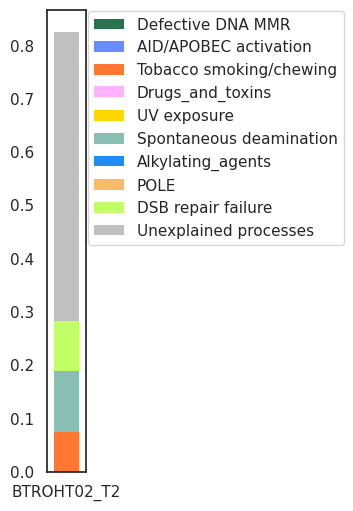

In [125]:
# run to plot mut signatures
bot_bar_plot(mut_signs, figsize=(.5,6), palette=signs_p)

In [126]:
mut_signs_BTROHT02=mut_signs

## Sequenza pp

In [127]:
pp = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT02_T2_alternative_solutions.txt', sep='\t')
pd.DataFrame(pp.loc[0])

,0
cellularity,0.650000
ploidy,2.000000
SLPP,0.290377


## Draw segments

In [59]:
segs=pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT02_T2_segments.txt', sep='\t')
chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

                          
chr_sizes = pd.DataFrame(
    {
        'hg19': pd.Series(
            {
                1: 249250621,
                2: 243199373,
                3: 198022430,
                4: 191154276,
                5: 180915260,
                6: 171115067,
                7: 159138663,
                8: 146364022,
                9: 141213431,
                10: 135534747,
                11: 135006516,
                12: 133851895,
                13: 115169878,
                14: 107349540,
                15: 102531392,
                16: 90354753,
                17: 81195210,
                18: 78077248,
                19: 59128983,
                20: 63025520,
                21: 48129895,
                22: 51304566,
                23: 155270560,
                24: 59373566,
            }
        ),
        'hg38': pd.Series(
            {
                1: 248956422,
                2: 242193529,
                3: 198295559,
                4: 190214555,
                5: 181538259,
                6: 170805979,
                7: 159345973,
                8: 145138636,
                9: 138394717,
                10: 133797422,
                11: 135086622,
                12: 133275309,
                13: 114364328,
                14: 107043718,
                15: 101991189,
                16: 90338345,
                17: 83257441,
                18: 80373285,
                19: 58617616,
                20: 64444167,
                21: 46709983,
                22: 50818468,
                23: 156040895,
                24: 57227415,
            }
        ),
    }
)

def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate=None,
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate: genes of interest for annotation in list format
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[
                   :-1
                   ]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.5
    min_h = -0.5

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)

    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate:
        annotate_draw_segments(
            ax=ax,
            cna_segments=cna_segments,
            annotate=annotate,
            chr_sizes_cs=chr_end_cs,
            ref=ref,
        )

    return ax

def annotate_draw_segments(ax, cna_segments, annotate, chr_sizes_cs, ref='hg38'):
    """
    Annotates genes of interest on draw_segments
    :param ax:
    :param cna_segments: segments file
    :param annotate: genes of interest for annotation in list format
    :param chr_sizes_cs: Cumulative sizes of chromosomes
    :param ref:
    """
    sizes_dict = chr_sizes_cs.to_dict()
    sizes_dict[0] = 0  # Needed for chr #1
    path_to_bed = '/scratch/alexandra.livanova/INT/Twist_Exome_RefSeq_targets_hg38.bed'
    cna_genes = segments2genes(cna_segments, path_to_bed)

    common_genes = list(cna_genes.index & annotate)

    hugo_bed = read_dataset(path_to_bed, header=None, index_col=None)
    hugo_bed.columns = ['chrom_n', 'Start_Position', 'End_Position', 'Hugo_Symbol']

    hugo_bed = hugo_bed[hugo_bed['chrom_n'].isin(chromosomes_list24)]
    hugo_bed['chrom_n'] = (
        hugo_bed['chrom_n']
        .str.replace('chr', '')
        .str.replace('X', '23')
        .str.replace('Y', '24')
        .astype(int)
    )
    hugo_bed = hugo_bed.set_index('Hugo_Symbol')
    for gene in common_genes:
        x = (
                hugo_bed['Start_Position'][gene]
                + sizes_dict[int(hugo_bed['chrom_n'][gene]) - 1]
        )
        y = cna_genes['total'][gene]
        arrow_position = x, y + 0.05
        text_position = x, y + 2
        ax.annotate(
            gene,
            xy=arrow_position,
            xytext=text_position,
            va="center",
            ha="center",
            arrowprops=dict(arrowstyle='-|>', color='black', lw=1),
            fontsize=14,
        )
    return ax

<Axes: >

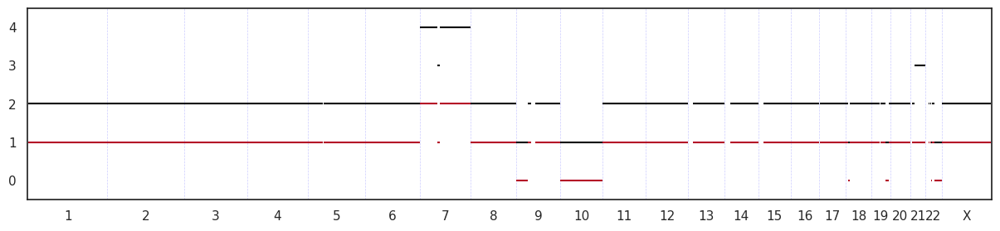

In [60]:
draw_segments(segs)

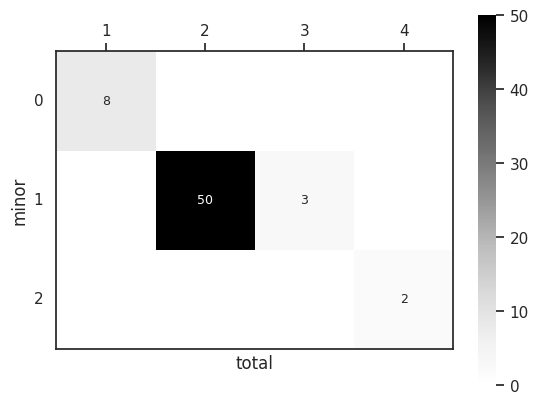

In [61]:
_, ax = plt.subplots()
pv = pivot_vectors(segs['total'], segs['minor'])
pv_annot = pv.astype(str).copy()
pv_annot[pv_annot == '0'] = ''
g = sns.heatmap( pv,  cmap='Greys', square=True, 
                annot=pv_annot.values, fmt='', annot_kws={"size": 9})
for _, spine in g.spines.items():
        spine.set_visible(True)
ax.set_yticklabels(pv.index.astype(int), rotation=0)
ax.xaxis.set_ticks_position('top')
plt.show()

## Add segments to maf

In [45]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/mutect/BTROHT02_T2.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,ENST00000466430,0,.,GRCh38,chr1,103299,103299,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103299,0.47
1,ENST00000471248,0,.,GRCh38,chr1,124846,124847,+,Intron,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,124845,0.81
2,ENST00000669836,0,.,GRCh38,chr1,264681,264681,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,264681,1.00
3,ENST00000669836,0,.,GRCh38,chr1,268465,268465,+,RNA,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,268465,1.00
4,ENST00000669836,0,.,GRCh38,chr1,269239,269240,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,269239,0.99
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275742,Unknown,0,.,GRCh38,chrY,56883761,56883761,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883761,NaN
275743,Unknown,0,.,GRCh38,chrY,56884023,56884024,+,IGR,DNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884023,NaN
275744,Unknown,0,.,GRCh38,chrY,56885448,56885448,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56885448,NaN
275745,Unknown,0,.,GRCh38,chrY,56886030,56886030,+,IGR,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56886029,NaN


In [46]:
maf_df_tissue['Tumor_VAF']=maf_df_tissue['t_alt_count']/maf_df_tissue['t_depth']
maf_df_tissue['Normal_VAF']=maf_df_tissue['n_alt_count']/maf_df_tissue['n_depth']

maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']

maf_df_tissue = maf_df_tissue[maf_df_tissue.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
 'Missense_Mutation',
 'Frame_Shift_Ins',
 'Frame_Shift_Del',
 'Nonsense_Mutation',
 'Nonstop_Mutation',
 'Translation_Start_Site',
 'Splice_Site'])]
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
70,SAMD11,0,.,GRCh38,chr1,943022,943022,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,943022,1.0,0.068966,0.0
73,PERM1,0,.,GRCh38,chr1,979175,979175,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,979175,1.0,0.080000,0.0
75,ISG15,0,.,GRCh38,chr1,1014288,1014288,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,1014288,1.0,0.066667,0.0
350,MEGF6,0,.,GRCh38,chr1,3511585,3511586,+,Frame_Shift_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,3511584,1.0,0.052632,0.0
966,UBE4B,0,.,GRCh38,chr1,10106480,10106483,+,Frame_Shift_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,10106479,1.0,0.047619,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268237,XIAP,0,.,GRCh38,chrX,123886089,123886089,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,123886089,1.0,0.068182,0.0
268345,TEX13C,0,.,GRCh38,chrX,125321420,125321420,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,125321420,1.0,0.117647,0.0
268641,OCRL,0,.,GRCh38,chrX,129590158,129590158,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,129590158,1.0,0.100000,0.0
269577,SLITRK2,0,.,GRCh38,chrX,145824814,145824814,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,145824814,1.0,0.080000,0.0


In [49]:
chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

segs['segment_n']=segs.index
segs

,chromosome,start,end,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,total,major,minor,LPP,chrom,segment_n
0,chr1,54490,124997413,0.498966,51424,0.072537,1.004457,3557417,0.368336,2,1,1,-6.743010,1,0
1,chr1,125002469,248944931,0.498967,42532,0.066134,1.015925,3046672,0.340220,2,1,1,-6.885216,1,1
2,chr2,10596,93294164,0.498967,42194,0.066424,1.010989,2686142,0.320966,2,1,1,-6.794848,2,2
3,chr2,93314516,242183318,0.498970,58669,0.065579,1.016047,4336289,0.319748,2,1,1,-6.941157,2,3
4,chr3,10576,89666728,0.498967,43853,0.064318,1.015426,2685971,0.318062,2,1,1,-6.851865,3,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58,chr22,23511778,27665235,0.498817,2001,0.122674,0.867670,114146,0.334210,2,1,1,-7.153172,22,58
59,chr22,27667264,50808101,0.259366,10938,0.104497,0.694394,602157,0.240612,1,1,0,-6.916764,22,59
60,chrX,35928,2781205,0.474650,2073,0.084210,1.002247,67400,0.365029,2,1,1,-6.786967,23,60
61,chrX,2996882,60440247,0.455144,329,0.141384,1.046691,1176199,0.490157,2,1,1,-7.074999,23,61


In [50]:
maf_final=maf_df_tissue
maf_final=maf_final[maf_final['Tumor_VAF']>0.02]
maf_final=maf_final[maf_final['t_depth']>3]
#maf_final=maf_final[maf_final['n_depth']>5]
#maf_final=maf_final[maf_final['Normal_VAF']<0.02]
maf_final=maf_final[maf_final['t_alt_count']>3]
#maf_final=maf_final[(maf_final['t_alt_count']*maf_final['Tumor_VAF'])>2]
maf_final

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
4542,STIL,0,.,GRCh38,chr1,47281210,47281210,+,Splice_Site,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,47281210,1.0,0.066667,0.0
18557,ASTN1,0,.,GRCh38,chr1,177164613,177164613,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,177164613,1.0,0.200000,0.0
21783,MARK1,0,.,GRCh38,chr1,220599833,220599833,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,220599833,1.0,0.344828,0.0
34816,OGA,0,.,GRCh38,chr10,101806104,101806104,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,101806104,1.0,0.400000,0.0
35130,SORCS3,0,.,GRCh38,chr10,105157267,105157267,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,105157267,1.0,0.550000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
257926,ECPAS,0,.,GRCh38,chr9,111413978,111413978,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,111413978,1.0,0.224138,0.0
259280,SPTAN1,0,.,GRCh38,chr9,128577500,128577500,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,128577500,1.0,0.571429,0.0
262268,PPP4R3C,0,.,GRCh38,chrX,27462896,27463025,+,Frame_Shift_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,27462895,1.0,0.090909,0.0
265031,OGT,0,.,GRCh38,chrX,71564754,71564755,+,Splice_Site,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,71564754,1.0,0.521739,0.0


In [51]:
import pandas as pd

# Assuming your DataFrame names are maf_final and segs
# Replace with the actual names of your DataFrames

# Sample DataFrames (replace with your actual DataFrames)
# maf_final = pd.DataFrame({'Chromosome': ['1', '2', '1', '3', '2', '3', '1', '2', '3', '1', '2', '3', '1'],
#                           'Start_Position': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200, 1300]})
# segs = pd.DataFrame({'chromosome': ['1', '2', '3', '1', '2', '3'],
#                      'start.pos': [90, 190, 290, 390, 490, 590],
#                      'end.pos': [110, 210, 310, 410, 510, 610],
#                      'CNt': [1, 2, 3, 4, 5, 6]})

# Merge DataFrames based on 'Chromosome'
merged_df = pd.merge(maf_final, segs, how='left', left_on='Chromosome', right_on='chromosome')

# Filter rows based on conditions
condition = (
    (merged_df['Start_Position'] >= merged_df['start']) &
    (merged_df['Start_Position'] <= merged_df['end'])
)

# Apply conditions and select relevant columns
result_df = merged_df[condition][['Chromosome', 'Start_Position', 'total', 'major', 'minor', 'segment_n']]

# Merge the result back to maf_final
maf_final = pd.merge(maf_final, result_df, how='left', on=['Chromosome', 'Start_Position'])

# Rename the CNt column if needed
maf_final.rename(columns={'CNt_y': 'CNt'}, inplace=True)

# Display the updated maf_final DataFrame
maf_final


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n
0,STIL,0,.,GRCh38,chr1,47281210,47281210,+,Splice_Site,SNP,...,NaN,NaN,47281210,1.0,0.066667,0.0,2,1,1,0
1,ASTN1,0,.,GRCh38,chr1,177164613,177164613,+,Missense_Mutation,SNP,...,NaN,NaN,177164613,1.0,0.200000,0.0,2,1,1,1
2,MARK1,0,.,GRCh38,chr1,220599833,220599833,+,Missense_Mutation,SNP,...,NaN,NaN,220599833,1.0,0.344828,0.0,2,1,1,1
3,OGA,0,.,GRCh38,chr10,101806104,101806104,+,Missense_Mutation,SNP,...,NaN,NaN,101806104,1.0,0.400000,0.0,1,1,0,26
4,SORCS3,0,.,GRCh38,chr10,105157267,105157267,+,Missense_Mutation,SNP,...,NaN,NaN,105157267,1.0,0.550000,0.0,1,1,0,26
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,ECPAS,0,.,GRCh38,chr9,111413978,111413978,+,Missense_Mutation,SNP,...,NaN,NaN,111413978,1.0,0.224138,0.0,2,1,1,24
116,SPTAN1,0,.,GRCh38,chr9,128577500,128577500,+,Missense_Mutation,SNP,...,NaN,NaN,128577500,1.0,0.571429,0.0,2,1,1,24
117,PPP4R3C,0,.,GRCh38,chrX,27462896,27463025,+,Frame_Shift_Del,DEL,...,NaN,NaN,27462895,1.0,0.090909,0.0,2,1,1,61
118,OGT,0,.,GRCh38,chrX,71564754,71564755,+,Splice_Site,INS,...,NaN,NaN,71564754,1.0,0.521739,0.0,2,1,1,62


In [52]:
# ploidy=4


# conditions = [
#     (maf_final['total'] >= 10),  # high amp
#     ((maf_final['total'] >= 8) & (maf_final['total'] < 10)),  # amp
#     ((maf_final['total'] >= 5) & (maf_final['total'] < 8)),  # gain
#     ((maf_final['total'] == 4) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 4) & (maf_final['minor'] == 0)),  # LOH
#     ((maf_final['total'] < 4) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

# conditions = [
#     (maf_final['total'] >= 14),  # high amp
#     ((maf_final['total'] >=12) & (maf_final['total'] < 14)),  # amp
#     ((maf_final['total'] >= 7) & (maf_final['total'] < 11)),  # gain
#     ((maf_final['total'] == 6) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 6) & (maf_final['minor'] == 0)),  # cnLOH
#     ((maf_final['total'] < 6) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

# conditions = [
#     (maf_final['total'] >= 5),  # high amp
#     (maf_final['total'] == 4),  # amp
#     (maf_final['total'] == 3),  # gain
#     ((maf_final['total'] == 2) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 2) & (maf_final['minor'] == 0)),  # cnLOH
#     (maf_final['total'] == 1),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

#ploidy=2

conditions = [
    (maf_final['total'] >= 5),  # high amp
    (maf_final['total'] == 4),  # amp
    (maf_final['total'] == 3),  # gain
    ((maf_final['total'] == 2) & (maf_final['minor'] != 0)),  # neutral
    ((maf_final['total'] == 2) & (maf_final['minor'] == 0)),  # cnLOH
    (maf_final['total'] == 1),  # Deletion
    (maf_final['total'] == 0)  # Loss
]
#ploidy=3
# conditions = [
#     (maf_final['total'] >= 8),  # high amp
#     ((maf_final['total'] >=6) & (maf_final['total'] < 8)),  # amp
#     ((maf_final['total'] >= 4) & (maf_final['total'] < 6)),  # gain
#     ((maf_final['total'] == 3) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 3) & (maf_final['minor'] == 0)),  # cnLOH
#     ((maf_final['total'] < 3) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

choices = [
    'High_amplification',
    'Amplification',
    'Gain',
    'Neutral',
    'cnLOH',
    'Deletion',
    'Loss'
]

maf_final['Segment_status'] = np.select(conditions, choices, default='Unknown')
maf_final


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n,Segment_status
0,STIL,0,.,GRCh38,chr1,47281210,47281210,+,Splice_Site,SNP,...,NaN,47281210,1.0,0.066667,0.0,2,1,1,0,Neutral
1,ASTN1,0,.,GRCh38,chr1,177164613,177164613,+,Missense_Mutation,SNP,...,NaN,177164613,1.0,0.200000,0.0,2,1,1,1,Neutral
2,MARK1,0,.,GRCh38,chr1,220599833,220599833,+,Missense_Mutation,SNP,...,NaN,220599833,1.0,0.344828,0.0,2,1,1,1,Neutral
3,OGA,0,.,GRCh38,chr10,101806104,101806104,+,Missense_Mutation,SNP,...,NaN,101806104,1.0,0.400000,0.0,1,1,0,26,Deletion
4,SORCS3,0,.,GRCh38,chr10,105157267,105157267,+,Missense_Mutation,SNP,...,NaN,105157267,1.0,0.550000,0.0,1,1,0,26,Deletion
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,ECPAS,0,.,GRCh38,chr9,111413978,111413978,+,Missense_Mutation,SNP,...,NaN,111413978,1.0,0.224138,0.0,2,1,1,24,Neutral
116,SPTAN1,0,.,GRCh38,chr9,128577500,128577500,+,Missense_Mutation,SNP,...,NaN,128577500,1.0,0.571429,0.0,2,1,1,24,Neutral
117,PPP4R3C,0,.,GRCh38,chrX,27462896,27463025,+,Frame_Shift_Del,DEL,...,NaN,27462895,1.0,0.090909,0.0,2,1,1,61,Neutral
118,OGT,0,.,GRCh38,chrX,71564754,71564755,+,Splice_Site,INS,...,NaN,71564754,1.0,0.521739,0.0,2,1,1,62,Neutral


In [138]:
bed=pd.read_csv('/home/alexandra.livanova/utlis_notebooks/gencode.33.hugo.bed', sep='\t', names=['chromosome', 'start', 'end', 'Hugo_Symbol'])
bed.head()

# List of genes of interest
genes_of_interest = ['PTEN', 'CDKN2A', 'CDKN2B']  # Add your genes of interest here
segs['segment_n']=segs.index
# Filter segments DataFrame based on genes of interest
bed = bed[bed['Hugo_Symbol'].isin(genes_of_interest)]

# Merge bed file DataFrame with filtered segments DataFrame
merged_df = pd.merge(bed, segs, how='left', left_on='chromosome', right_on='chromosome')

# Filter rows where start and end from bed file are inside start and end of the segment
merged_df = merged_df[(merged_df['start_x'] >= merged_df['start_y']) & (merged_df['end_x'] <= merged_df['end_y'])]

# Rename columns for clarity
merged_df.rename(columns={'total': 'segment_total', 'major': 'segment_major', 'minor': 'segment_minor'}, inplace=True)

# Drop redundant columns
merged_df.drop(['chromosome', 'start_y', 'end_y'], axis=1, inplace=True)

# Print or save the resulting DataFrame
merged_df

,start_x,end_x,Hugo_Symbol,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,segment_total,segment_major,segment_minor,LPP,chrom,segment_n
1,87863624,87971930,PTEN,0.255204,42391,0.103968,0.694702,2411015,0.243955,1,1,0,-7.418017,10,26
2,21967752,21995301,CDKN2A,0.256139,13145,0.101995,0.687747,585496,0.231180,1,1,0,-6.817202,9,21
6,22002902,22009305,CDKN2B,0.256139,13145,0.101995,0.687747,585496,0.231180,1,1,0,-6.817202,9,21


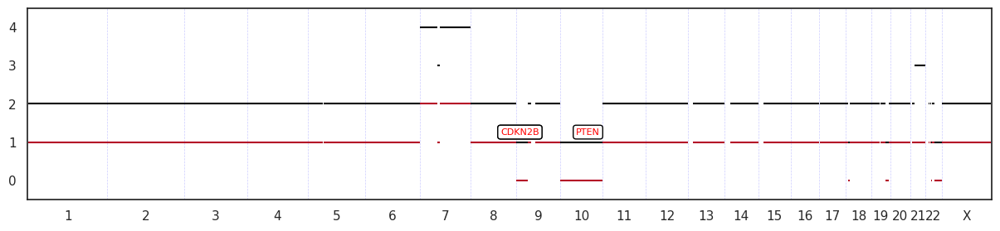

In [139]:
def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate_genes=None,
        maf_final=None,  # DataFrame containing gene information
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate_genes: genes of interest for annotation in list format
    :param maf_final: DataFrame containing gene information
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[:-1]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.5
    min_h = -0.5

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)

    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate_genes and maf_final is not None:
        annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes)

    return ax

def annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes):
    for gene in annotate_genes:
        gene_data = maf_final[maf_final['Hugo_Symbol'] == gene]
        
        if not gene_data.empty:
            gene_data = gene_data.iloc[0]  # Take the first occurrence if there are multiple entries
            segment_index = gene_data['segment_n']

            if pd.notna(segment_index):
                segment_data = cna_segments.loc[segment_index]
                chr_pos = chr_start_cs[int(segment_data['chrom'])]

                ax.annotate(
                    gene,
                    xy=((segment_data['start'] + segment_data['end']) / 2 + chr_pos, segment_data['total']),
                    xytext=(0, 5),
                    textcoords='offset points',
                    ha='center',
                    va='bottom',
                    fontsize=8,
                    color='red',  # You can customize the color
                    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'),
                )

# # Assuming 'Hugo_symbol_y' and 'segment_n' columns are present in maf_final
# # Replace 'Hugo_symbol_y' and 'segment_n' with the actual column names
# maf_final['Hugo_Symbol'] = maf_final['Hugo_Symbol'].astype(str)
# maf_final['segment_n'] = maf_final['segment_n'].astype(float)

# Assuming 'segment_n' is the column in maf_final corresponding to the index of segs
# Modify as per your actual DataFrame structure
genes_to_annotate = genes_of_interest

draw_segments(segs, annotate_genes=genes_to_annotate, maf_final=merged_df,max_cna=6, )
plt.show()


## VAF plot

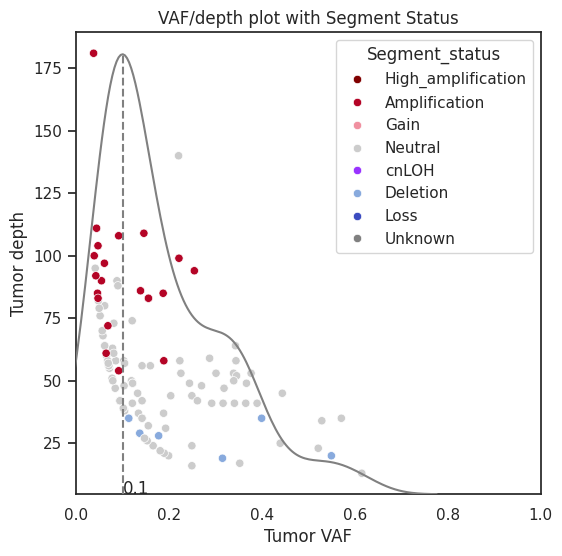

In [53]:
maf_final['t_depth']=maf_final['t_depth'].clip(0, 200)

import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="white", palette="pastel", font_scale=1)

_, ax = plt.subplots(1, 1, figsize=(6, 6))

ax = sns.scatterplot(
    data=maf_final,
    x='Tumor_VAF',
    y='t_depth',
    hue='Segment_status',
    palette={
        'High_amplification': '#800000',
        'Amplification': '#b40426',
        'Gain': '#F090A0',
        'Neutral': '#cccccc',
        'cnLOH': '#9933ff',
        'Deletion': '#88AADD',
        'Loss': '#3b4cc0',
        'Unknown': 'grey'
    },
    hue_order=[
        'High_amplification',
        'Amplification',
        'Gain',
        'Neutral',
        'cnLOH',
        'Deletion',
        'Loss',
        'Unknown'
    ]
)
plt.title('VAF/depth plot with Segment Status')
ax.set_xlabel('Tumor VAF')
ax.set_ylabel('Tumor depth')
ax.set_xlim(0, 1)

ax2 = ax.twinx()
sns.kdeplot(
    maf_final[maf_final['Segment_status']=='Neutral'].Tumor_VAF.astype(float), ax=ax2, color='grey', legend=False
)

line = ax2.get_lines()[0].get_data()
neutral_peak = line[0][line[1].argmax()]
ax2.vlines(
    neutral_peak, ymin=0, ymax=line[1].max(), colors='grey', linestyles='--'
)
ax2.text(neutral_peak, 0, neutral_peak.round(2))

# Annotate one dot with a line and label
# for gene in ['TP53', 'PIK3CA']:
#     point_to_annotate = maf_final[maf_final['Hugo_Symbol'] == gene].iloc[0]
#     ax.annotate(
#         text=point_to_annotate['Hugo_Symbol'],
#         xy=(point_to_annotate['Tumor_VAF'], point_to_annotate['t_depth']),
#         xytext=(20, -10),
#         textcoords='offset points',
#         arrowprops=dict(arrowstyle='->', color='black')
#     )




ax2.axis('off')
plt.show()


In [142]:
cell_fraction_by_alt_copy_vaf(0.33, 2, 1)

0.66

## Driver mutations

In [54]:
cols=['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification',
      'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]

maf_final2=maf_final[maf_final.Hugo_Symbol.isin(Martincorena.Martincorena.tolist())]
maf_final2[cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,total,major,minor,t_depth,t_alt_count
36,NF1,p.Q27*,0.529412,0.529412,Nonsense_Mutation,2,1,1,34,18
110,KMT2C,p.S772L,0.043478,0.043478,Missense_Mutation,4,2,2,92,4
116,SPTAN1,p.S360L,0.571429,0.571429,Missense_Mutation,2,1,1,35,20


In [55]:
cols=['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification','dbSNP_RS',
      'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]

maf_final3=maf_final[maf_final.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
maf_final3[cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,dbSNP_RS,total,major,minor,t_depth,t_alt_count
0,STIL,p.X417_splice,0.066667,0.066667,Splice_Site,novel,2,1,1,60,4
29,USP8,p.A798P,0.070175,0.070175,Missense_Mutation,novel,2,1,1,57,4
36,NF1,p.Q27*,0.529412,0.529412,Nonsense_Mutation,rs1060500363,2,1,1,34,18
47,RHPN2,p.I300M,0.082192,0.082192,Missense_Mutation,rs745872476,2,1,1,73,6
55,RANBP2,p.T2391S,0.062500,0.062500,Missense_Mutation,rs2433786,2,1,1,80,5
58,SIRPA,p.R107S,0.142857,0.142857,Missense_Mutation,rs17855615,2,1,1,35,5
59,SIRPA,p.G109S,0.142857,0.142857,Missense_Mutation,rs17855616,2,1,1,35,5
110,KMT2C,p.S772L,0.043478,0.043478,Missense_Mutation,rs4024453,4,2,2,92,4
112,PABPC1,p.L562S,0.050633,0.050633,Missense_Mutation,rs80006036,2,1,1,79,4
113,PABPC1,p.Q558E,0.088889,0.088889,Missense_Mutation,rs75035099,2,1,1,90,8


In [56]:
write_dataset(maf_final3[cols], 'BTROHT02_somatic_mut.tsv')

In [155]:
maf_df_tissue[maf_df_tissue['Hugo_Symbol']=='MUC16'][['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification',
   #   'total', 'major', 'minor',
 't_depth','CLIN_SIG',
 't_alt_count','dbSNP_RS',
 ]]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,t_depth,CLIN_SIG,t_alt_count,dbSNP_RS
109638,MUC16,p.K13246Tfs*4,0.061224,0.061224,Frame_Shift_Del,49,NaN,3,novel
109639,MUC16,p.H13241L,0.137931,0.137931,Missense_Mutation,29,NaN,4,novel
109688,MUC16,p.I12643V,0.102564,0.102564,Missense_Mutation,39,NaN,4,rs1161451539
109706,MUC16,p.N12272S,0.042105,0.042105,Missense_Mutation,95,NaN,4,rs201143426


# BTROHT04

In [26]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/mutect/BTROHT04_T1.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,OR4F5,0,.,GRCh38,chr1,76024,76024,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76024,0.70
1,ENST00000466430,0,.,GRCh38,chr1,101668,101668,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101668,0.77
2,ENST00000466430,0,.,GRCh38,chr1,109640,109640,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,109640,1.00
3,CICP27,0,.,GRCh38,chr1,127638,127638,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,127638,0.04
4,MIR6859-2,0,.,GRCh38,chr1,191617,191617,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,191617,0.73
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242361,Unknown,0,.,GRCh38,chrY,56883282,56883282,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883282,NaN
242362,Unknown,0,.,GRCh38,chrY,56884023,56884024,+,IGR,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884023,NaN
242363,Unknown,0,.,GRCh38,chrY,56884305,56884305,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884305,NaN
242364,Unknown,0,.,GRCh38,chrY,56885579,56885579,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56885579,NaN


In [35]:
maf_df_tissue['Tumor_VAF']=maf_df_tissue['t_alt_count']/maf_df_tissue['t_depth']
maf_df_tissue['Normal_VAF']=maf_df_tissue['n_alt_count']/maf_df_tissue['n_depth']

maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']

maf_df_tissue = maf_df_tissue[maf_df_tissue.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
 'Missense_Mutation',
 'Frame_Shift_Ins',
 'Frame_Shift_Del',
 'Nonsense_Mutation',
 'Nonstop_Mutation',
 'Translation_Start_Site',
 'Splice_Site', 
                                                          #               "5'Flank", "3'Flank",'Splice_Region',"5'UTR" 
                                                                        ])]
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
196,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,2593928,1.0,0.276596,0.0
617,GPR153,0,.,GRCh38,chr1,6249933,6249974,+,In_Frame_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,6249932,1.0,0.027523,0.0
618,GPR153,0,.,GRCh38,chr1,6249978,6249978,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,6249978,1.0,0.045455,0.0
826,ENO1,0,.,GRCh38,chr1,8863303,8863303,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,8863303,1.0,0.051724,0.0
1158,VPS13D,0,.,GRCh38,chr1,12321880,12321880,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,12321880,1.0,0.048387,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233797,SLC25A43,0,.,GRCh38,chrX,119399504,119399504,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,119399504,1.0,0.090909,0.0
234462,ACTRT1,0,.,GRCh38,chrX,128052181,128052181,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,128052181,1.0,0.086957,0.0
234929,ZNF449,0,.,GRCh38,chrX,135360976,135360976,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,135360976,1.0,0.058824,0.0
234993,BRS3,0,.,GRCh38,chrX,136490476,136490476,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,136490476,1.0,0.600000,0.0


In [346]:
maf_onco_04=maf_df_tissue[maf_df_tissue.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
maf_onco_04['Patient']='BTROHT04'

In [347]:
maf_onco_04

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,Patient
4199,STIL,0,.,GRCh38,chr1,47249939,47249939,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,47249939,1.00,0.102564,0.0,BTROHT04
4439,EPS15,0,.,GRCh38,chr1,51520741,51520741,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,51520741,1.00,0.044444,0.0,BTROHT04
16061,BCL9,0,.,GRCh38,chr1,147627164,147627164,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,147627164,1.00,0.056338,0.0,BTROHT04
19949,SLC45A3,0,.,GRCh38,chr1,205656246,205656247,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,205656246,1.00,0.157895,0.0,BTROHT04
23313,SFMBT2,0,.,GRCh38,chr10,7154351,7154351,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,7154351,1.00,0.125000,0.0,BTROHT04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230536,NONO,0,.,GRCh38,chrX,71278724,71278724,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,71278724,0.93,0.166667,0.0,BTROHT04
231040,LPAR4,0,.,GRCh38,chrX,78759854,78759854,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,78759854,1.00,0.062500,0.0,BTROHT04
233112,ACSL4,0,.,GRCh38,chrX,109682802,109682802,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,109682802,1.00,0.055556,0.0,BTROHT04
236132,IRAK1,0,.,GRCh38,chrX,154008746,154008746,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,154008746,1.00,0.048780,0.0,BTROHT04


In [232]:
maf_df_tissue['Tumor_VAF']=maf_df_tissue['t_alt_count']/maf_df_tissue['t_depth']
maf_df_tissue['Normal_VAF']=maf_df_tissue['n_alt_count']/maf_df_tissue['n_depth']

maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']

maf_df_tissue = maf_df_tissue[maf_df_tissue.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
 'Missense_Mutation',
 'Frame_Shift_Ins',
 'Frame_Shift_Del',
 'Nonsense_Mutation',
 'Nonstop_Mutation',
 'Translation_Start_Site',
 'Splice_Site'])]
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
196,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,2593928,1.0,0.276596,0.0
617,GPR153,0,.,GRCh38,chr1,6249933,6249974,+,In_Frame_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,6249932,1.0,0.027523,0.0
618,GPR153,0,.,GRCh38,chr1,6249978,6249978,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,6249978,1.0,0.045455,0.0
826,ENO1,0,.,GRCh38,chr1,8863303,8863303,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,8863303,1.0,0.051724,0.0
1158,VPS13D,0,.,GRCh38,chr1,12321880,12321880,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,12321880,1.0,0.048387,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233797,SLC25A43,0,.,GRCh38,chrX,119399504,119399504,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,119399504,1.0,0.090909,0.0
234462,ACTRT1,0,.,GRCh38,chrX,128052181,128052181,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,128052181,1.0,0.086957,0.0
234929,ZNF449,0,.,GRCh38,chrX,135360976,135360976,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,135360976,1.0,0.058824,0.0
234993,BRS3,0,.,GRCh38,chrX,136490476,136490476,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,136490476,1.0,0.600000,0.0


In [230]:
maf_df_tissue[maf_df_tissue['Hugo_Symbol']=='TERT'][['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification',
  #    'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,t_depth,t_alt_count


In [233]:
maf_final=maf_df_tissue
maf_final=maf_final[maf_final['Tumor_VAF']>0.05]
maf_final=maf_final[maf_final['t_depth']>5]
#maf_final=maf_final[maf_final['n_depth']>5]
#maf_final=maf_final[maf_final['Normal_VAF']<0.05]
maf_final=maf_final[maf_final['t_alt_count']>5]
maf_final=maf_final[(maf_final['t_alt_count']*maf_final['Tumor_VAF'])>2]
maf_final

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
196,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,2593928,1.00,0.276596,0.000000
1731,PADI3,0,.,GRCh38,chr1,17267882,17267882,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,17267882,1.00,0.436782,0.000000
4189,CYP4A22,0,.,GRCh38,chr1,47148751,47148751,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,47148751,0.97,0.375000,0.000000
21447,OBSCN,0,.,GRCh38,chr1,228333293,228333293,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,228333293,1.00,0.226667,0.000000
41163,HEPHL1,0,.,GRCh38,chr11,94104742,94104742,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,94104742,1.00,0.295082,0.000000
43503,GLB1L2,0,.,GRCh38,chr11,134371473,134371473,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,134371473,1.00,0.400000,0.000000
45646,DDX11,0,.,GRCh38,chr12,31085044,31085044,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,31085044,1.00,0.380952,0.000000
48462,BAZ2A,0,.,GRCh38,chr12,56602181,56602181,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,56602181,1.00,0.271429,0.000000
49485,ZFC3H1,0,.,GRCh38,chr12,71663237,71663237,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,71663237,1.00,0.202899,0.000000
55667,LATS2,0,.,GRCh38,chr13,21045921,21045921,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,21045921,1.00,0.279412,0.000000


## TMB

In [83]:
calc_tmb(maf_df_tissue)

Tumor_Sample_Barcode
BTROHT04_T1    1.467576
Name: count, dtype: float64

## Mut signatures

In [39]:
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/mutect/BTROHT04_T1.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
196,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,2593928,1.0,0.276596,0.0
617,GPR153,0,.,GRCh38,chr1,6249933,6249974,+,In_Frame_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,6249932,1.0,0.027523,0.0
618,GPR153,0,.,GRCh38,chr1,6249978,6249978,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,6249978,1.0,0.045455,0.0
826,ENO1,0,.,GRCh38,chr1,8863303,8863303,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,8863303,1.0,0.051724,0.0
1158,VPS13D,0,.,GRCh38,chr1,12321880,12321880,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,12321880,1.0,0.048387,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233797,SLC25A43,0,.,GRCh38,chrX,119399504,119399504,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,119399504,1.0,0.090909,0.0
234462,ACTRT1,0,.,GRCh38,chrX,128052181,128052181,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,128052181,1.0,0.086957,0.0
234929,ZNF449,0,.,GRCh38,chrX,135360976,135360976,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,135360976,1.0,0.058824,0.0
234993,BRS3,0,.,GRCh38,chrX,136490476,136490476,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,136490476,1.0,0.600000,0.0


In [40]:
maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,OR4F5,0,.,GRCh38,chr1,76024,76024,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76024,0.70
2,ENST00000466430,0,.,GRCh38,chr1,109640,109640,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,109640,1.00
5,Unknown,0,.,GRCh38,chr1,202192,202192,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202192,0.39
15,ENST00000419394,0,.,GRCh38,chr1,619428,619428,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,619428,0.44
17,LINC01409,0,.,GRCh38,chr1,777985,777985,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,777985,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242154,Unknown,0,.,GRCh38,chrY,56845472,56845472,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56845472,NaN
242155,Unknown,0,.,GRCh38,chrY,56845477,56845477,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56845477,NaN
242330,Unknown,0,.,GRCh38,chrY,56871712,56871712,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56871712,NaN
242348,Unknown,0,.,GRCh38,chrY,56879273,56879273,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56879273,NaN


In [ ]:
mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

-Extracting 5' and 3' adjacent bases


In [ ]:
# combining and renaming mutational signatures
mut_signs=mut_sigs
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
# palette
signs_p = {'Spontaneous deamination': '#89bfb3',
 'DSB repair failure': '#c2ff66',
 'AID/APOBEC activation': '#668cff',
 'Tobacco smoking/chewing': '#ff7733',
 'UV exposure': 'gold',
 'Alkylating_agents': '#218cf4',
 'POLE': '#f9bb66',
 'Drugs_and_toxins': '#ffb3ff',
 'Unexplained processes': 'silver',
 'Defective DNA MMR': '#26734d'}

In [ ]:
# run to plot mut signatures
bot_bar_plot(mut_signs, figsize=(.5,6), palette=signs_p)

In [179]:
mut_signs_BTROHT04=mut_signs

## Sequenza pp

In [180]:
pp = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT04_T1_alternative_solutions.txt', sep='\t')
pd.DataFrame(pp.loc[0])

,0
cellularity,0.530000
ploidy,1.800000
SLPP,0.450057


## Draw segments

In [64]:
segs=pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT04_T1_segments.txt', sep='\t')
chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

                          
chr_sizes = pd.DataFrame(
    {
        'hg19': pd.Series(
            {
                1: 249250621,
                2: 243199373,
                3: 198022430,
                4: 191154276,
                5: 180915260,
                6: 171115067,
                7: 159138663,
                8: 146364022,
                9: 141213431,
                10: 135534747,
                11: 135006516,
                12: 133851895,
                13: 115169878,
                14: 107349540,
                15: 102531392,
                16: 90354753,
                17: 81195210,
                18: 78077248,
                19: 59128983,
                20: 63025520,
                21: 48129895,
                22: 51304566,
                23: 155270560,
                24: 59373566,
            }
        ),
        'hg38': pd.Series(
            {
                1: 248956422,
                2: 242193529,
                3: 198295559,
                4: 190214555,
                5: 181538259,
                6: 170805979,
                7: 159345973,
                8: 145138636,
                9: 138394717,
                10: 133797422,
                11: 135086622,
                12: 133275309,
                13: 114364328,
                14: 107043718,
                15: 101991189,
                16: 90338345,
                17: 83257441,
                18: 80373285,
                19: 58617616,
                20: 64444167,
                21: 46709983,
                22: 50818468,
                23: 156040895,
                24: 57227415,
            }
        ),
    }
)

def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate=None,
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate: genes of interest for annotation in list format
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[
                   :-1
                   ]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.5
    min_h = -0.5

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)

    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate:
        annotate_draw_segments(
            ax=ax,
            cna_segments=cna_segments,
            annotate=annotate,
            chr_sizes_cs=chr_end_cs,
            ref=ref,
        )

    return ax

def annotate_draw_segments(ax, cna_segments, annotate, chr_sizes_cs, ref='hg38'):
    """
    Annotates genes of interest on draw_segments
    :param ax:
    :param cna_segments: segments file
    :param annotate: genes of interest for annotation in list format
    :param chr_sizes_cs: Cumulative sizes of chromosomes
    :param ref:
    """
    sizes_dict = chr_sizes_cs.to_dict()
    sizes_dict[0] = 0  # Needed for chr #1
    path_to_bed = '/scratch/alexandra.livanova/INT/Twist_Exome_RefSeq_targets_hg38.bed'
    cna_genes = segments2genes(cna_segments, path_to_bed)

    common_genes = list(cna_genes.index & annotate)

    hugo_bed = read_dataset(path_to_bed, header=None, index_col=None)
    hugo_bed.columns = ['chrom_n', 'Start_Position', 'End_Position', 'Hugo_Symbol']

    hugo_bed = hugo_bed[hugo_bed['chrom_n'].isin(chromosomes_list24)]
    hugo_bed['chrom_n'] = (
        hugo_bed['chrom_n']
        .str.replace('chr', '')
        .str.replace('X', '23')
        .str.replace('Y', '24')
        .astype(int)
    )
    hugo_bed = hugo_bed.set_index('Hugo_Symbol')
    for gene in common_genes:
        x = (
                hugo_bed['Start_Position'][gene]
                + sizes_dict[int(hugo_bed['chrom_n'][gene]) - 1]
        )
        y = cna_genes['total'][gene]
        arrow_position = x, y + 0.05
        text_position = x, y + 2
        ax.annotate(
            gene,
            xy=arrow_position,
            xytext=text_position,
            va="center",
            ha="center",
            arrowprops=dict(arrowstyle='-|>', color='black', lw=1),
            fontsize=14,
        )
    return ax

<Axes: >

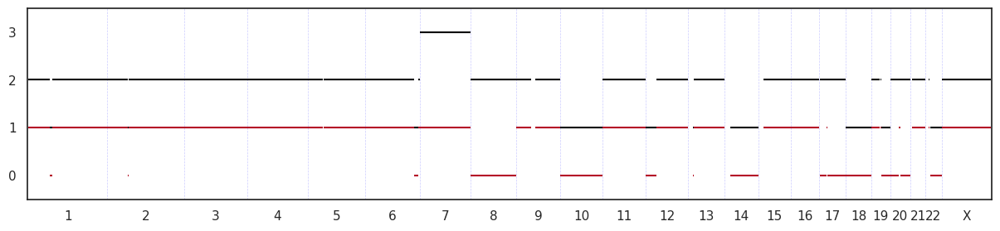

In [65]:
draw_segments(segs)

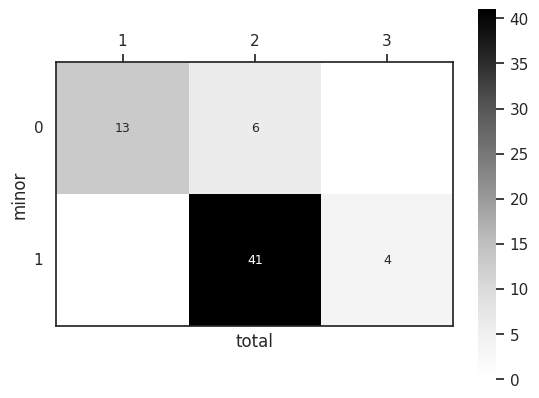

In [66]:
_, ax = plt.subplots()
pv = pivot_vectors(segs['total'], segs['minor'])
pv_annot = pv.astype(str).copy()
pv_annot[pv_annot == '0'] = ''
g = sns.heatmap( pv,  cmap='Greys', square=True, 
                annot=pv_annot.values, fmt='', annot_kws={"size": 9})
for _, spine in g.spines.items():
        spine.set_visible(True)
ax.set_yticklabels(pv.index.astype(int), rotation=0)
ax.xaxis.set_ticks_position('top')
plt.show()

## Add segments on maf

In [235]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/mutect/BTROHT04_T1.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,OR4F5,0,.,GRCh38,chr1,76024,76024,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76024,0.70
1,ENST00000466430,0,.,GRCh38,chr1,101668,101668,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101668,0.77
2,ENST00000466430,0,.,GRCh38,chr1,109640,109640,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,109640,1.00
3,CICP27,0,.,GRCh38,chr1,127638,127638,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,127638,0.04
4,MIR6859-2,0,.,GRCh38,chr1,191617,191617,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,191617,0.73
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242361,Unknown,0,.,GRCh38,chrY,56883282,56883282,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883282,NaN
242362,Unknown,0,.,GRCh38,chrY,56884023,56884024,+,IGR,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884023,NaN
242363,Unknown,0,.,GRCh38,chrY,56884305,56884305,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56884305,NaN
242364,Unknown,0,.,GRCh38,chrY,56885579,56885579,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56885579,NaN


In [236]:
maf_df_tissue['Tumor_VAF']=maf_df_tissue['t_alt_count']/maf_df_tissue['t_depth']
maf_df_tissue['Normal_VAF']=maf_df_tissue['n_alt_count']/maf_df_tissue['n_depth']

maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']

maf_df_tissue = maf_df_tissue[maf_df_tissue.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
 'Missense_Mutation',
 'Frame_Shift_Ins',
 'Frame_Shift_Del',
 'Nonsense_Mutation',
 'Nonstop_Mutation',
 'Translation_Start_Site',
 'Splice_Site'])]
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
196,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,2593928,1.0,0.276596,0.0
617,GPR153,0,.,GRCh38,chr1,6249933,6249974,+,In_Frame_Del,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,6249932,1.0,0.027523,0.0
618,GPR153,0,.,GRCh38,chr1,6249978,6249978,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,6249978,1.0,0.045455,0.0
826,ENO1,0,.,GRCh38,chr1,8863303,8863303,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,8863303,1.0,0.051724,0.0
1158,VPS13D,0,.,GRCh38,chr1,12321880,12321880,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,12321880,1.0,0.048387,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233797,SLC25A43,0,.,GRCh38,chrX,119399504,119399504,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,119399504,1.0,0.090909,0.0
234462,ACTRT1,0,.,GRCh38,chrX,128052181,128052181,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,128052181,1.0,0.086957,0.0
234929,ZNF449,0,.,GRCh38,chrX,135360976,135360976,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,135360976,1.0,0.058824,0.0
234993,BRS3,0,.,GRCh38,chrX,136490476,136490476,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,136490476,1.0,0.600000,0.0


In [67]:
maf_final=maf_df_tissue
maf_final=maf_final[maf_final['Tumor_VAF']>0.02]
maf_final=maf_final[maf_final['t_depth']>3]
#maf_final=maf_final[maf_final['n_depth']>5]
#maf_final=maf_final[maf_final['Normal_VAF']<0.02]
maf_final=maf_final[maf_final['t_alt_count']>3]
#maf_final=maf_final[(maf_final['t_alt_count']*maf_final['Tumor_VAF'])>2]
maf_final

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF
196,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,2593928,1.00,0.276596,0.0
1588,NBPF1,0,.,GRCh38,chr1,16576285,16576285,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,16576285,0.65,0.063291,0.0
1589,NBPF1,0,.,GRCh38,chr1,16576289,16576289,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,16576289,0.65,0.052632,0.0
1731,PADI3,0,.,GRCh38,chr1,17267882,17267882,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,17267882,1.00,0.436782,0.0
4155,TEX38,0,.,GRCh38,chr1,46673275,46673275,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,46673275,1.00,0.075472,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
222285,IARS1,0,.,GRCh38,chr9,92287901,92287901,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,92287901,1.00,0.297297,0.0
223134,OR13C2,0,.,GRCh38,chr9,104605348,104605348,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,104605348,0.70,0.150000,0.0
224310,RC3H2,0,.,GRCh38,chr9,122865368,122865368,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,122865368,1.00,0.320000,0.0
228957,SUV39H1,0,.,GRCh38,chrX,48698976,48698977,+,Frame_Shift_Ins,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,48698976,1.00,0.111111,0.0


In [68]:
chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

segs['segment_n']=segs.index
segs

,chromosome,start,end,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,total,major,minor,LPP,chrom,segment_n
0,chr1,16495,45667489,0.498962,21911,0.063419,1.082706,1406447,0.302638,2,1,1,-6.912154,1,0
1,chr1,45895811,67333487,0.498933,9525,0.085509,0.971176,637459,0.303657,2,1,1,-7.582230,1,1
2,chr1,67333880,75388905,0.322819,4006,0.096394,0.770334,219087,0.227653,1,1,0,-6.739138,1,2
3,chr1,75389462,120093190,0.498960,21083,0.062927,1.046685,1339477,0.291229,2,1,1,-6.758722,1,3
4,chr1,120124168,124994336,0.496330,1255,0.143147,0.904645,65230,0.762441,2,1,1,-6.851589,1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,chr21,13272200,46699658,0.498959,18982,0.064246,1.047755,1000709,0.291122,2,1,1,-6.748226,21,59
60,chr22,10534580,12900610,0.474256,1916,0.091132,0.834199,34703,0.227877,2,1,1,-8.011254,22,60
61,chr22,15178601,50808014,0.307440,18987,0.096463,0.793369,960903,0.234718,1,1,0,-6.921506,22,61
62,chrX,98061,60406953,0.498904,2729,0.097069,1.087685,1346829,0.444454,2,1,1,-6.887611,23,62


In [69]:
import pandas as pd

# Assuming your DataFrame names are maf_final and segs
# Replace with the actual names of your DataFrames

# Sample DataFrames (replace with your actual DataFrames)
# maf_final = pd.DataFrame({'Chromosome': ['1', '2', '1', '3', '2', '3', '1', '2', '3', '1', '2', '3', '1'],
#                           'Start_Position': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200, 1300]})
# segs = pd.DataFrame({'chromosome': ['1', '2', '3', '1', '2', '3'],
#                      'start.pos': [90, 190, 290, 390, 490, 590],
#                      'end.pos': [110, 210, 310, 410, 510, 610],
#                      'CNt': [1, 2, 3, 4, 5, 6]})

# Merge DataFrames based on 'Chromosome'
merged_df = pd.merge(maf_final, segs, how='left', left_on='Chromosome', right_on='chromosome')

# Filter rows based on conditions
condition = (
    (merged_df['Start_Position'] >= merged_df['start']) &
    (merged_df['Start_Position'] <= merged_df['end'])
)

# Apply conditions and select relevant columns
result_df = merged_df[condition][['Chromosome', 'Start_Position', 'total', 'major', 'minor', 'segment_n']]

# Merge the result back to maf_final
maf_final = pd.merge(maf_final, result_df, how='left', on=['Chromosome', 'Start_Position'])

# Rename the CNt column if needed
maf_final.rename(columns={'CNt_y': 'CNt'}, inplace=True)

# Display the updated maf_final DataFrame
maf_final


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n
0,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,NaN,2593928,1.00,0.276596,0.0,2,1,1,0
1,NBPF1,0,.,GRCh38,chr1,16576285,16576285,+,Missense_Mutation,SNP,...,NaN,NaN,16576285,0.65,0.063291,0.0,2,1,1,0
2,NBPF1,0,.,GRCh38,chr1,16576289,16576289,+,Missense_Mutation,SNP,...,NaN,NaN,16576289,0.65,0.052632,0.0,2,1,1,0
3,PADI3,0,.,GRCh38,chr1,17267882,17267882,+,Missense_Mutation,SNP,...,NaN,NaN,17267882,1.00,0.436782,0.0,2,1,1,0
4,TEX38,0,.,GRCh38,chr1,46673275,46673275,+,Missense_Mutation,SNP,...,NaN,NaN,46673275,1.00,0.075472,0.0,2,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,IARS1,0,.,GRCh38,chr9,92287901,92287901,+,Missense_Mutation,SNP,...,NaN,NaN,92287901,1.00,0.297297,0.0,2,1,1,29
114,OR13C2,0,.,GRCh38,chr9,104605348,104605348,+,Missense_Mutation,SNP,...,NaN,NaN,104605348,0.70,0.150000,0.0,2,1,1,29
115,RC3H2,0,.,GRCh38,chr9,122865368,122865368,+,Missense_Mutation,SNP,...,NaN,NaN,122865368,1.00,0.320000,0.0,2,1,1,29
116,SUV39H1,0,.,GRCh38,chrX,48698976,48698977,+,Frame_Shift_Ins,INS,...,NaN,NaN,48698976,1.00,0.111111,0.0,2,1,1,62


In [240]:
# ploidy=4


# conditions = [
#     (maf_final['total'] >= 10),  # high amp
#     ((maf_final['total'] >= 8) & (maf_final['total'] < 10)),  # amp
#     ((maf_final['total'] >= 5) & (maf_final['total'] < 8)),  # gain
#     ((maf_final['total'] == 4) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 4) & (maf_final['minor'] == 0)),  # LOH
#     ((maf_final['total'] < 4) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

# conditions = [
#     (maf_final['total'] >= 14),  # high amp
#     ((maf_final['total'] >=12) & (maf_final['total'] < 14)),  # amp
#     ((maf_final['total'] >= 7) & (maf_final['total'] < 11)),  # gain
#     ((maf_final['total'] == 6) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 6) & (maf_final['minor'] == 0)),  # cnLOH
#     ((maf_final['total'] < 6) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

# conditions = [
#     (maf_final['total'] >= 5),  # high amp
#     (maf_final['total'] == 4),  # amp
#     (maf_final['total'] == 3),  # gain
#     ((maf_final['total'] == 2) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 2) & (maf_final['minor'] == 0)),  # cnLOH
#     (maf_final['total'] == 1),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

#ploidy=2

conditions = [
    (maf_final['total'] >= 5),  # high amp
    (maf_final['total'] == 4),  # amp
    (maf_final['total'] == 3),  # gain
    ((maf_final['total'] == 2) & (maf_final['minor'] != 0)),  # neutral
    ((maf_final['total'] == 2) & (maf_final['minor'] == 0)),  # cnLOH
    (maf_final['total'] == 1),  # Deletion
    (maf_final['total'] == 0)  # Loss
]
#ploidy=3
# conditions = [
#     (maf_final['total'] >= 8),  # high amp
#     ((maf_final['total'] >=6) & (maf_final['total'] < 8)),  # amp
#     ((maf_final['total'] >= 4) & (maf_final['total'] < 6)),  # gain
#     ((maf_final['total'] == 3) & (maf_final['minor'] != 0)),  # neutral
#     ((maf_final['total'] == 3) & (maf_final['minor'] == 0)),  # cnLOH
#     ((maf_final['total'] < 3) & (maf_final['total'] >= 1)),  # Deletion
#     (maf_final['total'] == 0)  # Loss
# ]

choices = [
    'High_amplification',
    'Amplification',
    'Gain',
    'Neutral',
    'cnLOH',
    'Deletion',
    'Loss'
]

maf_final['Segment_status'] = np.select(conditions, choices, default='Unknown')
maf_final


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,total,major,minor,segment_n,Segment_status
0,MMEL1,0,.,GRCh38,chr1,2593928,2593928,+,Missense_Mutation,SNP,...,NaN,2593928,1.00,0.276596,0.000000,2,1,1,0,Neutral
1,PADI3,0,.,GRCh38,chr1,17267882,17267882,+,Missense_Mutation,SNP,...,NaN,17267882,1.00,0.436782,0.000000,2,1,1,0,Neutral
2,CYP4A22,0,.,GRCh38,chr1,47148751,47148751,+,Missense_Mutation,SNP,...,NaN,47148751,0.97,0.375000,0.000000,2,1,1,1,Neutral
3,OBSCN,0,.,GRCh38,chr1,228333293,228333293,+,Missense_Mutation,SNP,...,NaN,228333293,1.00,0.226667,0.000000,2,1,1,5,Neutral
4,HEPHL1,0,.,GRCh38,chr11,94104742,94104742,+,Missense_Mutation,SNP,...,NaN,94104742,1.00,0.295082,0.000000,2,1,1,35,Neutral
5,GLB1L2,0,.,GRCh38,chr11,134371473,134371473,+,Missense_Mutation,SNP,...,NaN,134371473,1.00,0.400000,0.000000,2,1,1,35,Neutral
6,DDX11,0,.,GRCh38,chr12,31085044,31085044,+,Missense_Mutation,SNP,...,NaN,31085044,1.00,0.380952,0.000000,1,1,0,36,Deletion
7,BAZ2A,0,.,GRCh38,chr12,56602181,56602181,+,Missense_Mutation,SNP,...,NaN,56602181,1.00,0.271429,0.000000,2,1,1,38,Neutral
8,ZFC3H1,0,.,GRCh38,chr12,71663237,71663237,+,Missense_Mutation,SNP,...,NaN,71663237,1.00,0.202899,0.000000,2,1,1,38,Neutral
9,LATS2,0,.,GRCh38,chr13,21045921,21045921,+,Missense_Mutation,SNP,...,NaN,21045921,1.00,0.279412,0.000000,2,1,1,40,Neutral


In [196]:
bed=pd.read_csv('/home/alexandra.livanova/utlis_notebooks/gencode.33.hugo.bed', sep='\t', names=['chromosome', 'start', 'end', 'Hugo_Symbol'])
bed.head()

# List of genes of interest
genes_of_interest = ['PTEN', 'CDKN2A', 'CDKN2B']  # Add your genes of interest here
segs['segment_n']=segs.index
# Filter segments DataFrame based on genes of interest
bed = bed[bed['Hugo_Symbol'].isin(genes_of_interest)]

# Merge bed file DataFrame with filtered segments DataFrame
merged_df = pd.merge(bed, segs, how='left', left_on='chromosome', right_on='chromosome')

# Filter rows where start and end from bed file are inside start and end of the segment
merged_df = merged_df[(merged_df['start_x'] >= merged_df['start_y']) & (merged_df['end_x'] <= merged_df['end_y'])]

# Rename columns for clarity
merged_df.rename(columns={'total': 'segment_total', 'major': 'segment_major', 'minor': 'segment_minor'}, inplace=True)

# Drop redundant columns
merged_df.drop(['chromosome', 'start_y', 'end_y'], axis=1, inplace=True)

# Print or save the resulting DataFrame
merged_df

,start_x,end_x,Hugo_Symbol,Bf,N.BAF,sd.BAF,depth.ratio,N.ratio,sd.ratio,segment_total,segment_major,segment_minor,LPP,chrom,segment_n
1,87863624,87971930,PTEN,0.328895,45645,0.096112,0.778415,2539039,0.228131,1,1,0,-6.746674,10,33
2,21967752,21995301,CDKN2A,0.498959,23275,0.067288,1.041090,1237065,0.294586,2,1,1,-6.797359,9,28
6,22002902,22009305,CDKN2B,0.498959,23275,0.067288,1.041090,1237065,0.294586,2,1,1,-6.797359,9,28


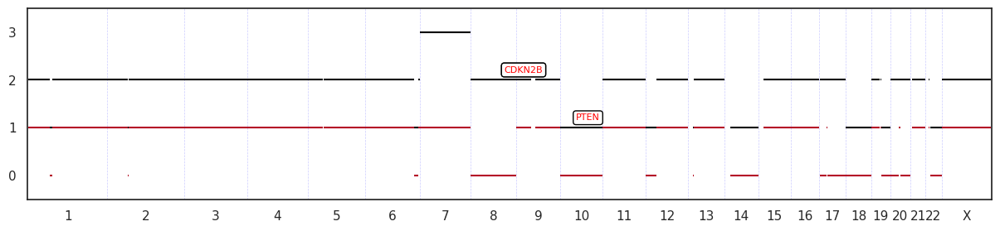

In [197]:
def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate_genes=None,
        maf_final=None,  # DataFrame containing gene information
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate_genes: genes of interest for annotation in list format
    :param maf_final: DataFrame containing gene information
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[:-1]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.5
    min_h = -0.5

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)

    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate_genes and maf_final is not None:
        annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes)

    return ax

def annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes):
    for gene in annotate_genes:
        gene_data = maf_final[maf_final['Hugo_Symbol'] == gene]
        
        if not gene_data.empty:
            gene_data = gene_data.iloc[0]  # Take the first occurrence if there are multiple entries
            segment_index = gene_data['segment_n']

            if pd.notna(segment_index):
                segment_data = cna_segments.loc[segment_index]
                chr_pos = chr_start_cs[int(segment_data['chrom'])]

                ax.annotate(
                    gene,
                    xy=((segment_data['start'] + segment_data['end']) / 2 + chr_pos, segment_data['total']),
                    xytext=(0, 5),
                    textcoords='offset points',
                    ha='center',
                    va='bottom',
                    fontsize=8,
                    color='red',  # You can customize the color
                    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'),
                )

# # Assuming 'Hugo_symbol_y' and 'segment_n' columns are present in maf_final
# # Replace 'Hugo_symbol_y' and 'segment_n' with the actual column names
# maf_final['Hugo_Symbol'] = maf_final['Hugo_Symbol'].astype(str)
# maf_final['segment_n'] = maf_final['segment_n'].astype(float)

# Assuming 'segment_n' is the column in maf_final corresponding to the index of segs
# Modify as per your actual DataFrame structure
genes_to_annotate = genes_of_interest

draw_segments(segs, annotate_genes=genes_to_annotate, maf_final=merged_df,max_cna=6, )
plt.show()


## VAF plot

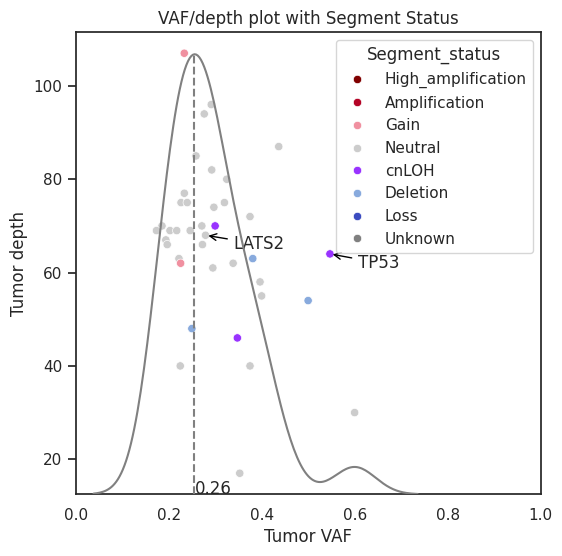

In [241]:
maf_final['t_depth']=maf_final['t_depth'].clip(0, 200)

import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(style="white", palette="pastel", font_scale=1)

_, ax = plt.subplots(1, 1, figsize=(6, 6))

ax = sns.scatterplot(
    data=maf_final,
    x='Tumor_VAF',
    y='t_depth',
    hue='Segment_status',
    palette={
        'High_amplification': '#800000',
        'Amplification': '#b40426',
        'Gain': '#F090A0',
        'Neutral': '#cccccc',
        'cnLOH': '#9933ff',
        'Deletion': '#88AADD',
        'Loss': '#3b4cc0',
        'Unknown': 'grey'
    },
    hue_order=[
        'High_amplification',
        'Amplification',
        'Gain',
        'Neutral',
        'cnLOH',
        'Deletion',
        'Loss',
        'Unknown'
    ]
)
plt.title('VAF/depth plot with Segment Status')
ax.set_xlabel('Tumor VAF')
ax.set_ylabel('Tumor depth')
ax.set_xlim(0, 1)

ax2 = ax.twinx()
sns.kdeplot(
    maf_final[maf_final['Segment_status']=='Neutral'].Tumor_VAF.astype(float), ax=ax2, color='grey', legend=False
)

line = ax2.get_lines()[0].get_data()
neutral_peak = line[0][line[1].argmax()]
ax2.vlines(
    neutral_peak, ymin=0, ymax=line[1].max(), colors='grey', linestyles='--'
)
ax2.text(neutral_peak, 0, neutral_peak.round(2))

#Annotate one dot with a line and label
for gene in ['TP53', 'LATS2']:
    point_to_annotate = maf_final[maf_final['Hugo_Symbol'] == gene].iloc[0]
    ax.annotate(
        text=point_to_annotate['Hugo_Symbol'],
        xy=(point_to_annotate['Tumor_VAF'], point_to_annotate['t_depth']),
        xytext=(20, -10),
        textcoords='offset points',
        arrowprops=dict(arrowstyle='->', color='black')
    )




ax2.axis('off')
plt.show()


In [199]:
cell_fraction_by_alt_copy_vaf(0.26, 2, 1)

0.52

## Driver mutations

In [70]:
cols=['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification',
      'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]

maf_final2=maf_final[maf_final.Hugo_Symbol.isin(Martincorena.Martincorena.tolist())]
maf_final2[cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,total,major,minor,t_depth,t_alt_count
1,NBPF1,p.V701F,0.063291,0.063291,Missense_Mutation,2,1,1,79,5
2,NBPF1,p.H699Q,0.052632,0.052632,Missense_Mutation,2,1,1,76,4
27,LATS2,p.G36R,0.279412,0.279412,Missense_Mutation,2,1,1,68,19
40,TP53,p.S127F,0.546875,0.546875,Missense_Mutation,2,2,0,64,35
104,MUC17,p.T2255A,0.113208,0.113208,Missense_Mutation,3,2,1,53,6
105,MUC17,p.T3199A,0.039216,0.039216,Missense_Mutation,3,2,1,102,4


In [205]:
cell_fraction_by_alt_copy_vaf(0.55, 2, 2)

0.55

In [71]:
cols=['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification','dbSNP_RS',
      'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]

maf_final3=maf_final[maf_final.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
maf_final3[cols]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,dbSNP_RS,total,major,minor,t_depth,t_alt_count
18,ARHGEF12,p.P603L,0.133333,0.133333,Missense_Mutation,novel,2,1,1,30,4
27,LATS2,p.G36R,0.279412,0.279412,Missense_Mutation,novel,2,1,1,68,19
40,TP53,p.S127F,0.546875,0.546875,Missense_Mutation,rs730881999,2,2,0,64,35
62,ERBB4,p.G372S,0.163265,0.163265,Missense_Mutation,NaN,2,1,1,49,8
79,PAK2,p.S20R,0.060606,0.060606,Missense_Mutation,rs76714248,2,1,1,66,4
110,NRG1,p.M463T,0.064516,0.064516,Missense_Mutation,novel,2,2,0,62,4


In [ ]:
write_dataset(maf_final3[cols], 'BTROHT04_somatic_mut.tsv')

In [209]:
maf_df_tissue[maf_df_tissue['Hugo_Symbol'].isin(['ERBB4', 'CUL1'])][['Hugo_Symbol',
 'HGVSp_Short','Tumor_VAF','Tumor_VAF',

      'Variant_Classification',
  #    'total', 'major', 'minor',
 't_depth',
 't_alt_count'
 ]]

,Hugo_Symbol,HGVSp_Short,Tumor_VAF,Tumor_VAF,Variant_Classification,t_depth,t_alt_count
116943,ERBB4,p.G372S,0.163265,0.163265,Missense_Mutation,49,8
205872,CUL1,p.E190Q,0.225806,0.225806,Missense_Mutation,62,14


# Mutation signatures

In [253]:
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)


maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

# combining and renaming mutational signatures
mut_signs=mut_sigs
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
# palette
signs_p = {'Spontaneous deamination': '#89bfb3',
 'DSB repair failure': '#c2ff66',
 'AID/APOBEC activation': '#668cff',
 'Tobacco smoking/chewing': '#ff7733',
 'UV exposure': 'gold',
 'Alkylating_agents': '#218cf4',
 'POLE': '#f9bb66',
 'Drugs_and_toxins': '#ffb3ff',
 'Unexplained processes': 'silver',
 'Defective DNA MMR': '#26734d'}

-Extracting 5' and 3' adjacent bases
-Extracting +/- 20bp around mutated bases for background C>T estimation
-Estimating APOBEC enrichment scores
--Performing one-way Fisher's test for APOBEC enrichment
---APOBEC related mutations are enriched in  0 % of samples (APOBEC enrichment score > 2 ;  0  of  1  samples)
-Creating mutation matrix
--matrix of dimension 1x96

In [254]:
mut_signs_BTROHT01=mut_signs

In [255]:
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/mutect/BTROHT02_T2.maf',
sep='\t', comment='#', low_memory=False)


maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

# combining and renaming mutational signatures
mut_signs=mut_sigs
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
# palette
signs_p = {'Spontaneous deamination': '#89bfb3',
 'DSB repair failure': '#c2ff66',
 'AID/APOBEC activation': '#668cff',
 'Tobacco smoking/chewing': '#ff7733',
 'UV exposure': 'gold',
 'Alkylating_agents': '#218cf4',
 'POLE': '#f9bb66',
 'Drugs_and_toxins': '#ffb3ff',
 'Unexplained processes': 'silver',
 'Defective DNA MMR': '#26734d'}

-Extracting 5' and 3' adjacent bases
-Extracting +/- 20bp around mutated bases for background C>T estimation
-Estimating APOBEC enrichment scores
--Performing one-way Fisher's test for APOBEC enrichment
---APOBEC related mutations are enriched in  0 % of samples (APOBEC enrichment score > 2 ;  0  of  1  samples)
-Creating mutation matrix
--matrix of dimension 1x96

In [256]:
mut_signs_BTROHT02=mut_signs

In [265]:
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/mutect/BTROHT04_T1.maf',
sep='\t', comment='#', low_memory=False)


maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

# combining and renaming mutational signatures
mut_signs=mut_sigs

-Extracting 5' and 3' adjacent bases
-Extracting +/- 20bp around mutated bases for background C>T estimation
-Estimating APOBEC enrichment scores
--Performing one-way Fisher's test for APOBEC enrichment
---APOBEC related mutations are enriched in  0 % of samples (APOBEC enrichment score > 2 ;  0  of  1  samples)
-Creating mutation matrix
--matrix of dimension 1x96

In [267]:
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
#

In [268]:
mut_signs.T.sum()

BTROHT04_T1    0.844377
dtype: float64

In [266]:
mut_signs.T.sum()

BTROHT04_T1    0.844377
dtype: float64

In [269]:
mut_signs

,Defective DNA MMR,AID/APOBEC activation,Tobacco smoking/chewing,Drugs_and_toxins,UV exposure,Spontaneous deamination,Alkylating_agents,POLE,DSB repair failure,Unexplained processes
BTROHT04_T1,0.0,0.0,0.067441,0.0,0.0,0.100077,0.0,0.0,0.087428,0.589431


In [257]:
maf_df_tissue_for_sigs = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/mutect/BTROHT04_T1.maf',
sep='\t', comment='#', low_memory=False)


maf_df_tissue_for_sigs=maf_df_tissue_for_sigs[maf_df_tissue_for_sigs['FILTER']=='PASS']
maf_df_tissue_for_sigs

mut_sigs=calc_mut_signs(maf_df_tissue_for_sigs)

# combining and renaming mutational signatures
mut_signs=mut_sigs
mut_signs['Defective DNA MMR'] = (mut_signs.Signature_15 + mut_signs.Signature_6 + 
                                          mut_signs.Signature_20 + mut_signs.Signature_26)
mut_signs['AID/APOBEC activation'] = (mut_signs.Signature_2 + mut_signs.Signature_13)
mut_signs['Tobacco smoking/chewing'] = (mut_signs.Signature_4 + mut_signs.Signature_29)
mut_signs['Drugs_and_toxins'] = (mut_signs.Signature_22+ 
                          mut_signs.Signature_24)
mut_signs['UV exposure'] = mut_signs.Signature_7
mut_signs['Spontaneous deamination'] = mut_signs.Signature_1
mut_signs['Alkylating_agents'] = mut_signs.Signature_11
mut_signs['POLE'] = mut_signs.Signature_10
mut_signs['DSB repair failure'] = mut_signs.Signature_3
mut_signs['Unexplained processes'] = (mut_signs.Signature_8+ mut_signs.Signature_9 +
                          mut_signs.Signature_14+ mut_signs.Signature_17+
                          mut_signs.Signature_18+mut_signs.Signature_19+
                          mut_signs.Signature_21+ mut_signs.Signature_25+
                          mut_signs.Signature_27+mut_signs.Signature_28+
                          mut_signs.Signature_30 + mut_signs.Signature_5 + 
                         mut_signs.Signature_16 +  mut_signs.Signature_23 + 
                         mut_signs.Signature_12)
# leaving only renamed
mut_signs = mut_signs[['Defective DNA MMR', 'AID/APOBEC activation',
                              'Tobacco smoking/chewing', 'Drugs_and_toxins', 
                              'UV exposure','Spontaneous deamination',
                               'Alkylating_agents',
                               'POLE','DSB repair failure', 'Unexplained processes']]
# palette
signs_p = {'Spontaneous deamination': '#89bfb3',
 'DSB repair failure': '#c2ff66',
 'AID/APOBEC activation': '#668cff',
 'Tobacco smoking/chewing': '#ff7733',
 'UV exposure': 'gold',
 'Alkylating_agents': '#218cf4',
 'POLE': '#f9bb66',
 'Drugs_and_toxins': '#ffb3ff',
 'Unexplained processes': 'silver',
 'Defective DNA MMR': '#26734d'}

-Extracting 5' and 3' adjacent bases
-Extracting +/- 20bp around mutated bases for background C>T estimation
-Estimating APOBEC enrichment scores
--Performing one-way Fisher's test for APOBEC enrichment
---APOBEC related mutations are enriched in  0 % of samples (APOBEC enrichment score > 2 ;  0  of  1  samples)
-Creating mutation matrix
--matrix of dimension 1x96

In [258]:
mut_signs_BTROHT04=mut_signs

In [259]:
mut_sign_concat=pd.concat([mut_signs_BTROHT01, mut_signs_BTROHT02, mut_signs_BTROHT04])
mut_sign_concat

,Defective DNA MMR,AID/APOBEC activation,Tobacco smoking/chewing,Drugs_and_toxins,UV exposure,Spontaneous deamination,Alkylating_agents,POLE,DSB repair failure,Unexplained processes
BTROHT01_T3,0.0,0.0,0.000000,0.0,0.0,0.074839,0.0,0.0,0.097064,0.662896
BTROHT02_T2,0.0,0.0,0.074175,0.0,0.0,0.115406,0.0,0.0,0.093630,0.542175
BTROHT04_T1,0.0,0.0,0.067441,0.0,0.0,0.100077,0.0,0.0,0.087428,0.589431


[Text(0.5, 0, 'BTROHT01_T3'),
 Text(1.5, 0, 'BTROHT02_T2'),
 Text(2.5, 0, 'BTROHT04_T1')]

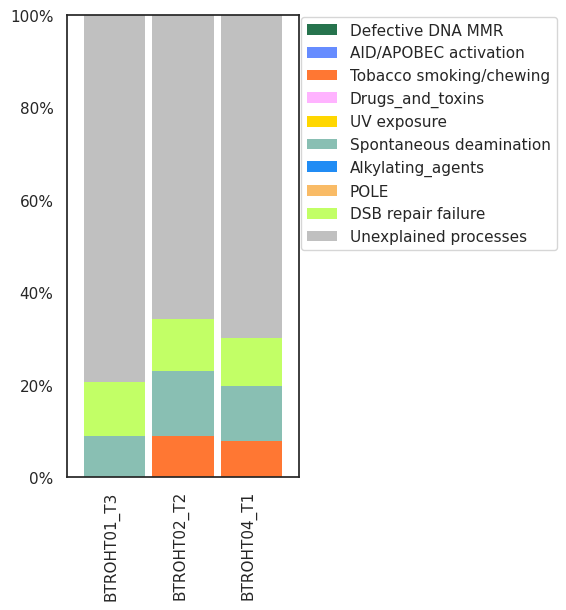

In [273]:
# run to plot mut signatures
ax=bot_bar_plot(mut_sign_concat, figsize=(3,6), palette=signs_p, percent=True)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

In [292]:
'SCN9A' in IntOGen['IntOGen'].tolist()

False

# Oncoplot

In [404]:
maf_for_oncoplot=pd.concat([maf_onco_01, maf_onco_02, 
           maf_onco_04       ])

In [405]:
maf_for_oncoplot

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY,Tumor_VAF,Normal_VAF,Patient
786,RPL22,0,.,GRCh38,chr1,6203811,6203811,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,6203811,1.00,0.200000,0.0,BTROHT01
2043,PRDM2,0,.,GRCh38,chr1,13825710,13825712,+,3'Flank,TNP,...,NaN,NaN,NaN,NaN,NaN,13825710,1.00,0.032787,0.0,BTROHT01
2812,ARHGEF10L,0,.,GRCh38,chr1,17538727,17538727,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,17538727,1.00,0.049180,0.0,BTROHT01
7833,EPS15,0,.,GRCh38,chr1,51522498,51522501,+,5'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,51522497,1.00,0.329787,0.0,BTROHT01
10970,FUBP1,0,.,GRCh38,chr1,77981578,77981578,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,77981578,1.00,0.070796,0.0,BTROHT01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230536,NONO,0,.,GRCh38,chrX,71278724,71278724,+,5'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,71278724,0.93,0.166667,0.0,BTROHT04
231040,LPAR4,0,.,GRCh38,chrX,78759854,78759854,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,78759854,1.00,0.062500,0.0,BTROHT04
233112,ACSL4,0,.,GRCh38,chrX,109682802,109682802,+,Missense_Mutation,SNP,...,NaN,NaN,NaN,NaN,NaN,109682802,1.00,0.055556,0.0,BTROHT04
236132,IRAK1,0,.,GRCh38,chrX,154008746,154008746,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,154008746,1.00,0.048780,0.0,BTROHT04


In [406]:
mutation_classes = [
    '',
    'Multi_Hit',
    'In_Frame_Ins',
    'In_Frame_Del',
    'Missense_Mutation',
    'Splice_Site',
    'Frame_Shift_Ins',
    'Frame_Shift_Del',
    'Nonsense_Mutation',
    'Nonstop_Mutation',
    'Translation_Start_Site',
    'Fusion',
    'Methylated',
    "5'Flank", 
    "3'Flank",
     "5'UTR"
    
]

mut_class_numbers = np.array([0, 1, 2, 2, 3, 4, 5, 5, 6, 6, 6, 7, 8, 9, 9, 9])
mut_class_to_number = dict(list(zip(mutation_classes, mut_class_numbers)))

In [407]:
mut_class_to_number

{'': 0,
 'Multi_Hit': 1,
 'In_Frame_Ins': 2,
 'In_Frame_Del': 2,
 'Missense_Mutation': 3,
 'Splice_Site': 4,
 'Frame_Shift_Ins': 5,
 'Frame_Shift_Del': 5,
 'Nonsense_Mutation': 6,
 'Nonstop_Mutation': 6,
 'Translation_Start_Site': 6,
 'Fusion': 7,
 'Methylated': 8,
 "5'Flank": 9,
 "3'Flank": 9,
 "5'UTR": 9}

In [369]:
maf_for_oncoplot['Variant_Classification'].unique()

array(["5'Flank", "3'Flank", 'Splice_Site', 'In_Frame_Del', "5'UTR",
       'Frame_Shift_Del', 'Missense_Mutation', 'Frame_Shift_Ins',
       'Nonsense_Mutation', 'Splice_Region'], dtype=object)

In [409]:
def aggregate_mutations(maf):
    """
    Create dataframe with aggregated mutation types by sample and gene based on maf
    :param maf: pd.DataFrame, maf
    :return: pd.DataFrame, samples in index and genes in column names.
    """
    not_used_mc = set(maf['Variant_Classification'].unique()).difference(
        set(mutation_classes)
    )
    if len(not_used_mc):
        warnings.warn('{} variant classes were skipped'.format(','.join(not_used_mc)))

    cmaf = maf[np.in1d(maf['Variant_Classification'], list(mut_class_to_number.keys()))]
    mut_event = {}
    for csample in cmaf.groupby('Patient'):
        mut_event[csample[0]] = {}
        mut_genes = pd.concat(
            [
                pd.Series(csample[1].Hugo_Symbol.values),
                pd.Series(csample[1].Variant_Classification.values),
            ],
            axis=1,
        )
        mut_genes.columns = ['Gene', 'Event']
        for gene in mut_genes.groupby('Gene'):

            if len(gene[1].Event) > 1:
                mut_event[csample[0]][gene[0]] = 'Multi_Hit'
            else:
                mut_event[csample[0]][gene[0]] = gene[1].Event.iloc[0]

    return pd.DataFrame(mut_event).fillna('').T


In [408]:
# maf_for_oncoplot=maf_for_oncoplot[maf_for_oncoplot['Variant_Classification'].isin(dna_protein_affecting_mutations)]
# maf_for_oncoplot

In [353]:
def to_bin_table(table):
    """
    Return dataframe based on "table" with "False" where there was "" and "True" otherwise.
    :param table: pd.DataFrame
    :return: pd.DataFrame
    """
    return table.apply(lambda x: x != '')

In [354]:
def get_most_mutated_gene(bin_mut_table):
    """
    Return gene with most mutation incidences
    :param bin_mut_table: pd.DataFrame, binary table of genes mutated. Get by calling utils.to_bin_table on aggregated
                          mutation table
    :return: str
    """
    return bin_mut_table.sum().sort_values(ascending=False).index[0]

In [355]:
def get_genes_order(bin_mut_table, top=20, pre_ranked=None):
    """
    Return the top mutated genes using bin_mut_table
    :param bin_mut_table: pd.DataFrame, binary table of genes mutated.
                            Get by calling utils.to_bin_table on aggregated mutation table
    :param top: int, how many genes to return
    :param pre_ranked: list, first len(pre_ranked) top genes, will override the first genes,
                    making it so only the leftover top-len(pre_ranked) are calculated using bin_mut_table
    :return: list
    """

    genes_order = bin_mut_table.sum().sort_values(ascending=False).head(top).index.tolist()


    return genes_order

In [417]:
maf_for_oncoplot.Variant_Classification.unique()

array(["5'Flank", "3'Flank", 'Splice_Site', 'In_Frame_Del', "5'UTR",
       'Frame_Shift_Del', 'Missense_Mutation', 'Frame_Shift_Ins',
       'Nonsense_Mutation', 'Splice_Region'], dtype=object)

In [419]:
def mut_freq_plot(mut_table, ax=None, legend=True):
    """
    `   Bar plot of frequency of mutations in each gene by mutation class in given sample set
        :param mut_table: pd.DataFrame, aggregated mutation table. See mutations.aggregate_mutations for info.
        :param ax: matplotlib axis, axis to plot on
        :param legend: bool, whether to plot a legend
        :return: matplotlib axis
    """

    frequencies = (
        mut_table.apply(
            lambda x: x.map(mut_class_to_number)
            .map(mut_number_to_agg_class)
            .value_counts()
        )
        .loc[mutation_class_labels_order]
        .fillna(0)
        .astype(int)
        .T
    )

    if ax is None:
        _, ax = plt.subplots(figsize=(4, 0.25 * len(frequencies.columns)))
    frequencies.plot(
        kind='barh',
        stacked=True,
        ax=ax,
        color=pd.Series(mut_class_to_color)[mutation_class_labels_order].values,
        width=0.8,
        align='edge',
    )

    ax.set_ylim(0, len(frequencies.index))

    if legend:
        ax.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.1)
    else:
        ax.legend_.remove()
    return ax

In [420]:
def oncoplot_sort_samples(mut_values_table):
    """
    Sort samples for usage in oncoplot
    :param mut_values_table: pd.DataFrame, sample-mutation table in format used by oncoplot
    :return: pd.DataFrame
    """
    base = mut_values_table.values.max() + 1.0
    if base > 4:
        raise Exception('Too big base! {}'.format(base))
    powers = base ** np.array(list(range(len(mut_values_table.columns))))[::-1]
    return mut_values_table.dot(powers).sort_values(ascending=False).index

In [421]:
from matplotlib import gridspec

def oncoplot(
    mut_table,
    top=20,
    non_mutated=True,
    sort_by_mutations=True,
    genes_order=None,
    legend=False,
    mload_plot=True,
    plot_mean=True,
    cna=None,
    alt_ratio=1,
    title='',
    mpq=0.98,
    figsize=None,
):
    """

    :param mut_table:
    :param top:
    :param non_mutated:
    :param sort_by_mutations:
    :param genes_order:
    :param legend:
    :param mload_plot:
    :param plot_mean:
    :param cna:
    :param alt_ratio:
    :param title:
    :param mpq:
    :return:
    """

    bin_mut_table = to_bin_table(mut_table)
    if cna is not None and not sort_by_mutations:
        common_genes = cna.columns & bin_mut_table.columns
        bin_mut_table *= 2
        bin_mut_table[common_genes] += (
            abs(cna.loc[bin_mut_table.index, common_genes].fillna(0)) >= alt_ratio
        ).astype(int)

    genes_order = get_genes_order(bin_mut_table, top=top, pre_ranked=genes_order)

    samples_order = bin_mut_table.index
    n_mutations = bin_mut_table.loc[samples_order, genes_order].sum(axis=1)

    if not non_mutated:
        samples_order = samples_order[
            ~np.in1d(samples_order, n_mutations[n_mutations < 1].index)
        ]

    height = max(4, 2.0 / 8 * len(genes_order))
    width = max(6, len(mut_table) / 50.0)

    final_table = mut_table.loc[samples_order, genes_order]

    if figsize is not None:
        fig = plt.figure(figsize=figsize)
    else:
        fig = plt.figure(figsize=(width + 2, height + 1))

    if mload_plot:
        grid_spec = gridspec.GridSpec(
            2,
            2,
            width_ratios=(width, 2),
            height_ratios=(1, height),
            wspace=0.025,
            hspace=0.025,
        )

        mload_plot_ax = fig.add_subplot(grid_spec[0])
        ax_ = fig.add_subplot(grid_spec[1])
        ax_.axis('off')
        heatmap_ax = fig.add_subplot(grid_spec[2], sharex=mload_plot_ax)
        freq_plot_ax = fig.add_subplot(grid_spec[3], sharey=heatmap_ax)

        mutation_load_plot(
            to_bin_table(
                mut_table.loc[samples_order]
                .replace('Methylated', '')
                .replace('Fusion', '')
            ).sum(axis=1),
            ax=mload_plot_ax,
            plot_median=plot_mean,
            q=mpq,
        )
        axs = [[mload_plot_ax, ax_], [heatmap_ax, freq_plot_ax]]
    else:
        fig, axs = plt.subplots(
            1,
            2,
            figsize=(width + 2, height),
            gridspec_kw={'width_ratios': (width, 2), 'wspace': 0.025},
            sharey=True,
        )
        heatmap_ax = axs[0]
        freq_plot_ax = axs[1]

    mut_freq_plot(final_table, ax=freq_plot_ax, legend=legend)

    mut_plot(final_table, heatmap_ax)
    fig.patch.set_facecolor(onco_plot_background_color)

    if cna is not None:
        draw_cna(
            heatmap_ax,
            samples_order,
            genes_order,
            cna,
            s=width / 2.0,
            alpha=0.9,
            alt_ratio=alt_ratio,
        )

    heatmap_ax.set_title(title)
    return axs

In [455]:
import matplotlib.pyplot as plt
import matplotlib 
mutation_class_labels = [
    'Multi_Hit',
    'In_Frame_Ins/Del',
    'Missense_Mutation',
    'Splice_Site',
    'Frame_Shift_Ins/Del',
    'Non-sense/stop/start_Mutation',
    'Fusion',
    'Methylated',
    "Flank/UTR"
]
mut_class_numbers = np.array([0, 1, 2, 2, 3, 4, 5, 5, 6, 6, 6, 7, 8, 9])
total_mutation_classes = len(mutation_class_labels)

mut_number_to_agg_class = dict(
    list(zip(np.arange(total_mutation_classes) + 1, mutation_class_labels))
)

mutation_class_labels_order = [
  #  'Non-sense/stop/start_Mutation',
    'In_Frame_Ins/Del',
# 'Frame_Shift_Ins/Del',
    'Splice_Site',
    'Missense_Mutation',
    'Multi_Hit',
    "Flank/UTR"
  #  'Fusion',
  #  'Methylated',
]
onco_colors = [
    '#f5f5f5',
    '#000000',
    '#BDB20A',
    '#5DADE2',
    '#52be80',
    '#ee850f',
    '#FC2214',
    '#693A1B',
    '#FF00D4',
    '#8d2b8a'
]
mut_class_to_color = dict(list(zip(mutation_class_labels, onco_colors[1:])))
onco_colors_cm = matplotlib.colors.ListedColormap(onco_colors)

onco_colors_cm_norm = matplotlib.colors.BoundaryNorm(
    np.arange(total_mutation_classes + 2) - 0.5, onco_colors_cm.N
)

onco_plot_background_color = '#ffffff'

In [456]:
def mut_plot(mut_table, ax=None):
    """
    Plots heatmap of mutation classes in each gene of each sample contained in "mut_table"
    :param mut_table: pd.DataFrame, aggregated mutation table. See mutations.aggregate_mutations for info.
    :param ax: matplotlib axis, axis to plot on
    :return: matplotlib aixs
    """

    if ax is None:
        height = max(4, 2.0 / 8 * len(mut_table.columns))
        width = max(6, len(mut_table.index) / 50.0)
        _, ax = plt.subplots(figsize=(width, height))

    sns.heatmap(
        mut_table.T.apply(lambda x: x.map(mut_class_to_number)),
        ax=ax,
        cbar=False,
        xticklabels=True,
        yticklabels=True,
        cmap=onco_colors_cm,
        norm=onco_colors_cm_norm,
        vmax=total_mutation_classes - 0.5,
         
        
    )
    ax.xaxis.set_ticks_position('top')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    return ax

In [457]:
mut_table=aggregate_mutations(maf_for_oncoplot)

In [463]:
bin_mut_table = to_bin_table(mut_table)
genes_order = get_genes_order(bin_mut_table, top=39, pre_ranked=None)
for gene in genes_order:
    print(gene)

HLA-A
ZNF521
EPS15
SOCS1
STIL
TCF7L2
FANCD2
RHPN2
SET
NTRK3
SMAD2
PDGFRB
FAT1
FLT3
PARP4
HERC2
HLA-B
NONO
LATS2
LPAR4
FGD5
ARID2
USP8
WNK2
STAT5B
TNFAIP3
TP53
MEF2B
PABPC1
PDPR
RUNX1
SATB1
SH2B3
RANBP2
RGPD3
RNF213
BCL7A
ARHGEF10L
ARHGEF11


array([<Axes: >, <Axes: >], dtype=object)

<Figure size 800x1100 with 0 Axes>

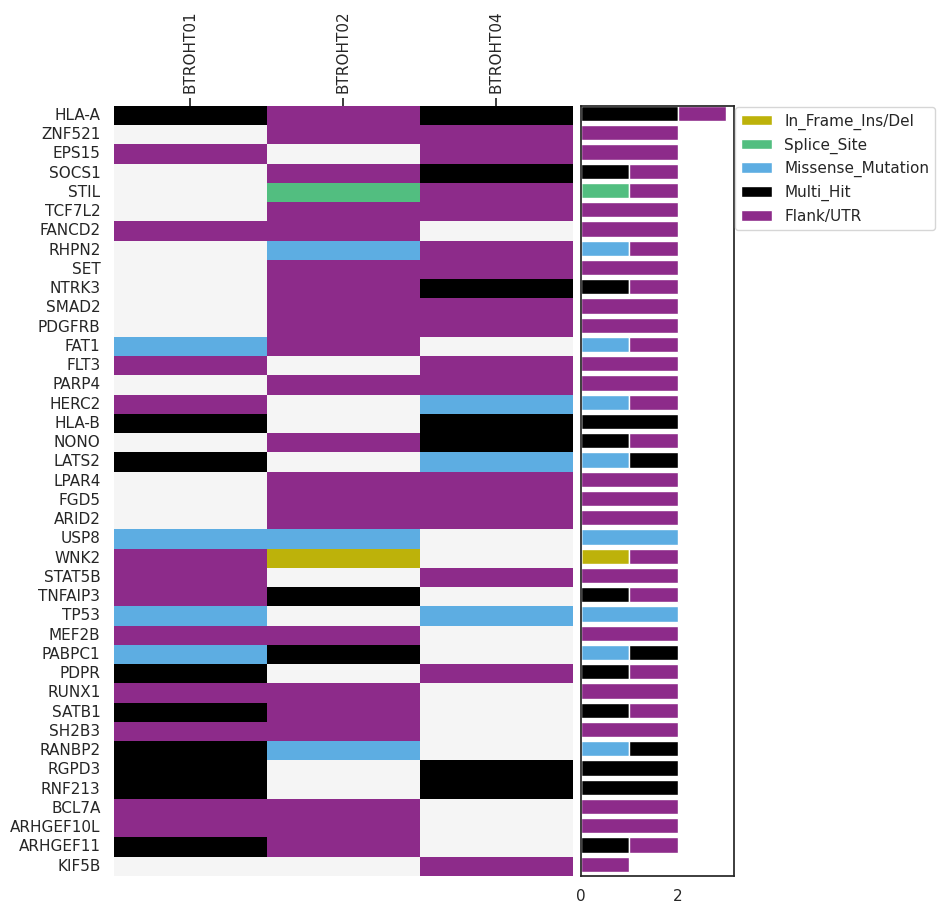

In [458]:
oncoplot(mut_table, top=40, mload_plot=False,legend=True,sort_by_mutations=True,  )

array([<Axes: >, <Axes: >], dtype=object)

<Figure size 800x1100 with 0 Axes>

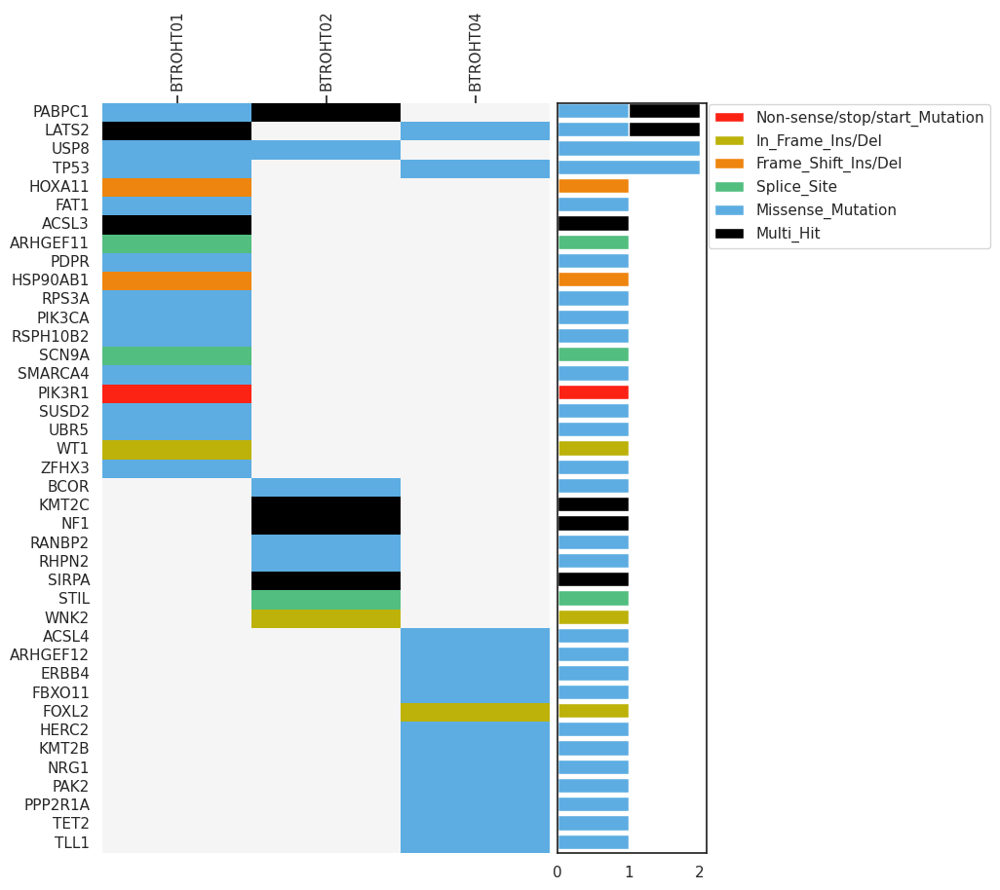

In [403]:
oncoplot(mut_table, top=199, mload_plot=False,legend=True,sort_by_mutations=False,  )

In [464]:
import gseapy as gp

In [465]:
enr = gp.enrichr(gene_list=genes_order, # or "./tests/data/gene_list.txt",
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human', 'Reactome_2022', 'GO_Biological_Process_2023'],
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [467]:
enr01=enr.results[enr.results['Adjusted P-value']<0.05]
enr01

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Interferon Gamma Response,6/200,2.299047e-06,0.000053,0,0,18.525773,240.520411,LATS2;RNF213;SOCS1;HLA-B;TNFAIP3;HLA-A
23,KEGG_2021_Human,Pathways in cancer,9/531,6.382303e-07,0.000072,0,0,11.171839,159.361443,SMAD2;PDGFRB;ARHGEF11;STAT5B;TCF7L2;FLT3;LPAR4...
24,KEGG_2021_Human,Acute myeloid leukemia,4/67,8.659965e-06,0.000389,0,0,36.096145,420.765540,STAT5B;TCF7L2;FLT3;RUNX1
25,KEGG_2021_Human,Central carbon metabolism in cancer,4/70,1.031602e-05,0.000389,0,0,34.450216,395.550932,PDGFRB;FLT3;NTRK3;TP53
26,KEGG_2021_Human,Human T-cell leukemia virus 1 infection,5/219,6.393422e-05,0.001806,0,0,13.569956,131.053965,SMAD2;STAT5B;HLA-B;HLA-A;TP53
...,...,...,...,...,...,...,...,...,...,...
610,GO_Biological_Process_2023,Peptidyl-Tyrosine Modification (GO:0018212),2/54,4.973412e-03,0.044326,0,0,20.695426,109.761278,PDGFRB;FLT3
611,GO_Biological_Process_2023,Regulation Of Reactive Oxygen Species Metaboli...,2/56,5.339128e-03,0.045865,0,0,19.926927,104.271489,PDGFRB;TP53
612,GO_Biological_Process_2023,Mitotic DNA Damage Checkpoint Signaling (GO:00...,2/56,5.339128e-03,0.045865,0,0,19.926927,104.271489,FANCD2;TP53
613,GO_Biological_Process_2023,Positive Regulation Of Cellular Metabolic Proc...,2/56,5.339128e-03,0.045865,0,0,19.926927,104.271489,PDGFRB;TP53


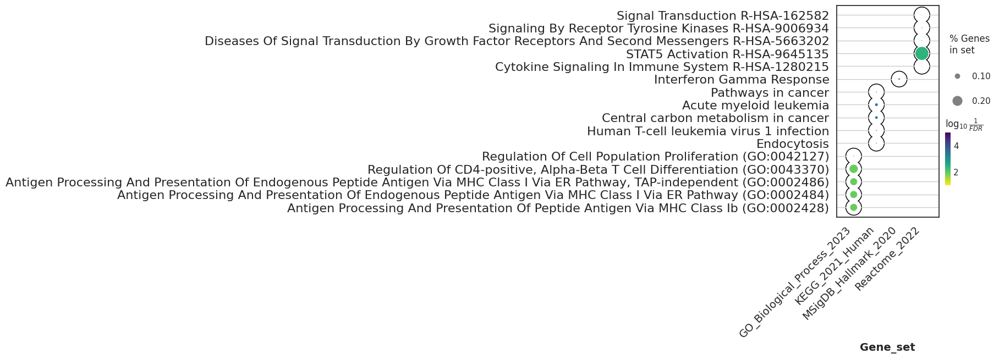

In [471]:
# categorical scatterplot
ax = gp.dotplot(enr.results,
              column="Adjusted P-value",
              x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
              size=10,
              top_term=5,
              figsize=(3,5),
              title = "",
              xticklabels_rot=45, # rotate xtick labels
              show_ring=True, # set to False to revmove outer ring
              marker='o',
             )

In [334]:
'TERT' in IntOGen.IntOGen.tolist()

False

# BTROHT01 sc mut calling

In [111]:
import scanpy as sc

In [84]:
! gunzip /scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_core_somatic/cellSNP.cells.vcf.gz

In [85]:
! gunzip /scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_core_somatic/cellSNP.cells.vcf.gz

In [22]:
demultiplexing=pd.read_csv('/home/alexandra.livanova/ROVIGO/multiome/BTROHT_01_02_04_core/demultiplexing_final.csv', sep='\t')
demultiplexing=demultiplexing.set_index('cell')
demultiplexing

,donor_id_rna,prob_max_rna,prob_doublet_rna,n_vars_rna,best_singlet_rna,best_doublet_rna,doublet_logLikRatio_rna,donor_id_atac,prob_max_atac,prob_doublet_atac,n_vars_atac,best_singlet_atac,best_doublet_atac,doublet_logLikRatio_atac,final_donor_id
cell,,,,,,,,,,,,,,,
AAACAGCCAGGATAAC-1,BTROHT04_germline,1.000000,6.560000e-231,3708,BTROHT04_germline,"BTROHT02_germline,BTROHT01_germline",-527.035,doublet,0.000000e+00,1.000000e+00,5451,BTROHT01_germline,"BTROHT02_germline,BTROHT01_germline",1220.105,BTROHT04_germline
AAACAGCCAGGCGAGT-1,unassigned,0.000005,6.650000e-01,34,BTROHT02_germline,"BTROHT01_germline,BTROHT02_germline",14.838,BTROHT02_germline,1.000000e+00,5.240000e-163,2682,BTROHT02_germline,"BTROHT01_germline,BTROHT02_germline",-370.684,BTROHT02_germline
AAACAGCCAGTACCGT-1,BTROHT04_germline,1.000000,3.740000e-254,4012,BTROHT04_germline,"BTROHT02_germline,BTROHT01_germline",-580.559,BTROHT04_germline,1.000000e+00,0.000000e+00,20499,BTROHT04_germline,"BTROHT01_germline,BTROHT02_germline",-2834.005,BTROHT04_germline
AAACATGCACAACAAA-1,BTROHT04_germline,1.000000,2.550000e-107,1830,BTROHT04_germline,"BTROHT02_germline,BTROHT01_germline",-242.462,BTROHT04_germline,1.000000e+00,0.000000e+00,14025,BTROHT04_germline,"BTROHT01_germline,BTROHT02_germline",-2010.986,BTROHT04_germline
AAACATGCACACAATT-1,BTROHT04_germline,1.000000,1.410000e-14,463,BTROHT04_germline,"BTROHT01_germline,BTROHT04_germline",-28.913,BTROHT04_germline,1.000000e+00,0.000000e+00,7291,BTROHT04_germline,"BTROHT01_germline,BTROHT02_germline",-1072.009,BTROHT04_germline
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGGCACTGGCCA-1,BTROHT02_germline,1.000000,6.120000e-15,325,BTROHT02_germline,"BTROHT01_germline,BTROHT02_germline",-29.747,BTROHT02_germline,1.000000e+00,3.790000e-67,1123,BTROHT02_germline,"BTROHT01_germline,BTROHT02_germline",-149.961,BTROHT02_germline
TTTGTGGCATGAAGTA-1,BTROHT02_germline,0.999000,5.620000e-04,34,BTROHT02_germline,"BTROHT02_germline,BTROHT01_germline",-4.503,BTROHT02_germline,1.000000e+00,2.020000e-37,575,BTROHT02_germline,"BTROHT01_germline,BTROHT02_germline",-81.513,BTROHT02_germline
TTTGTGTTCGGTTTGG-1,BTROHT02_germline,1.000000,1.940000e-10,367,BTROHT02_germline,"BTROHT02_germline,BTROHT01_germline",-19.381,doublet,2.360000e-45,1.000000e+00,2314,BTROHT02_germline,"BTROHT02_germline,BTROHT01_germline",105.737,BTROHT02_germline


In [60]:
cells=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_core_somatic/cellSNP.samples.tsv', sep="\t", header=None)


sample_names = cells[0].tolist()

# Read cellSNP.cells.vcf file
vcf_df = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_core_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns = vcf_df.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns = vcf_df.iloc[:, 9:]   # Assuming remaining columns are sample genotypes

# Rename sample columns with sample names
sample_columns.columns = sample_names
sample_columns=sample_columns[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]

# Concatenate variant columns with renamed sample columns
vcf_with_sample_names = pd.concat([variant_columns, sample_columns], axis=1)
vcf_with_sample_names['modality']='atac'

cells_gex=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_core_somatic/cellSNP.samples.tsv', sep="\t", header=None)
sample_names = cells_gex[0].tolist()

# Read cellSNP.cells.vcf file
vcf_df_gex = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_core_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns_gex = vcf_df_gex.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns_gex = vcf_df_gex.iloc[:, 9:]   # Assuming remaining columns are sample genotypes
# Rename sample columns with sample names
sample_columns_gex.columns = sample_names

sample_columns_gex=sample_columns_gex[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]


# Concatenate variant columns with renamed sample columns
vcf_with_sample_names_gex = pd.concat([variant_columns_gex, sample_columns_gex], axis=1)
vcf_with_sample_names_gex['modality']='gex'

#concatenate atac and rna vcfs
vcf_with_sample_names=pd.concat([vcf_with_sample_names, vcf_with_sample_names_gex])

vcf_with_sample_names=vcf_with_sample_names.rename(columns={0:'Chromosome', 1:'Start_Position'})
vcf_with_sample_names

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACGGATCATTGCAA-1,...,TTTAAGGTCCCATAGG-1,TTTCATCAGCTCCTTA-1,TTTCCTGAGGTTTGAC-1,TTTGACCGTCCTTTAA-1,TTTGCGGAGCCAGTAT-1,TTTGGTGCACACAATT-1,TTTGTCTAGGACGTAA-1,TTTGTGGCAAGTCGCT-1,TTTGTTGGTGCTAGAC-1,modality
0,chr1,16257,.,G,C,.,PASS,AD=3;DP=35;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,atac
1,chr1,202217,.,G,A,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,atac
2,chr1,202259,.,G,T,.,PASS,AD=5;DP=7;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,atac
3,chr1,283102,.,T,C,.,PASS,AD=2;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,atac
4,chr1,630026,.,C,T,.,PASS,AD=6;DP=10;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,atac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3442,chrX,153581087,.,T,G,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,gex
3443,chrX,154318600,.,C,T,.,PASS,AD=2;DP=3;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,gex
3444,chrY,11298902,.,G,A,.,PASS,AD=2;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,gex
3445,chrY,11305405,.,G,T,.,PASS,AD=2;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,.:.:.:.:.:.,...,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,.:.:.:.:.:.,gex


In [24]:
vcf_with_sample_names=vcf_with_sample_names.replace('.:.:.:.:.:.', 'nan')
vcf_with_sample_names

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACGGATCATTGCAA-1,...,TTTAAGGTCCCATAGG-1,TTTCATCAGCTCCTTA-1,TTTCCTGAGGTTTGAC-1,TTTGACCGTCCTTTAA-1,TTTGCGGAGCCAGTAT-1,TTTGGTGCACACAATT-1,TTTGTCTAGGACGTAA-1,TTTGTGGCAAGTCGCT-1,TTTGTTGGTGCTAGAC-1,modality
0,chr1,16257,.,G,C,.,PASS,AD=3;DP=35;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
1,chr1,202217,.,G,A,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
2,chr1,202259,.,G,T,.,PASS,AD=5;DP=7;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
3,chr1,283102,.,T,C,.,PASS,AD=2;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
4,chr1,630026,.,C,T,.,PASS,AD=6;DP=10;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3442,chrX,153581087,.,T,G,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex
3443,chrX,154318600,.,C,T,.,PASS,AD=2;DP=3;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex
3444,chrY,11298902,.,G,A,.,PASS,AD=2;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex
3445,chrY,11305405,.,G,T,.,PASS,AD=2;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex


## let's see how many positions with variants are covered in each cell in GEX and ATAC

In [215]:
vcf_df_gex = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_core_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns_gex = vcf_df_gex.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns_gex = vcf_df_gex.iloc[:, 9:]   # Assuming remaining columns are sample genotypes
# Rename sample columns with sample names
sample_columns_gex.columns = sample_names

sample_columns_gex=sample_columns_gex[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]


# Concatenate variant columns with renamed sample columns
vcf_with_sample_names_gex = pd.concat([variant_columns_gex, sample_columns_gex], axis=1)


vcf_with_sample_names_gex=vcf_with_sample_names_gex.replace('.:.:.:.:.:.', 'nan')

#отбираем только мутации прошедшие фильрт
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']


vcf_with_sample_names_gex=vcf_with_sample_names_gex.rename(columns={0:'Chromosome', 1:'Start_Position'})
vcf_with_sample_names_gex = pd.merge(vcf_with_sample_names_gex, maf_df_tissue, on=["Chromosome", "Start_Position"], how="inner")
vcf_with_sample_names_gex

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACGGATCATTGCAA-1,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,chr1,826372,.,C,T,.,PASS,AD=51;DP=53;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,826372,1.00
1,chr1,1292702,.,C,G,.,PASS,AD=1;DP=164;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1292702,1.00
2,chr1,6515320,.,G,C,.,PASS,AD=2;DP=5;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6515320,1.00
3,chr1,10554117,.,G,A,.,PASS,AD=2;DP=14;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10554117,1.00
4,chr1,14012956,.,A,T,.,PASS,AD=0;DP=8;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14012956,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
798,chrX,119030820,.,G,T,.,PASS,AD=1;DP=2;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,119030820,1.00
799,chrX,119092755,.,C,T,.,PASS,AD=1;DP=2;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,119092755,1.00
800,chrX,120812432,.,G,T,.,PASS,AD=3;DP=7;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,120812432,0.97
801,chrX,123962062,.,G,C,.,PASS,AD=1;DP=3;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,123962062,1.00


<Axes: ylabel='Count'>

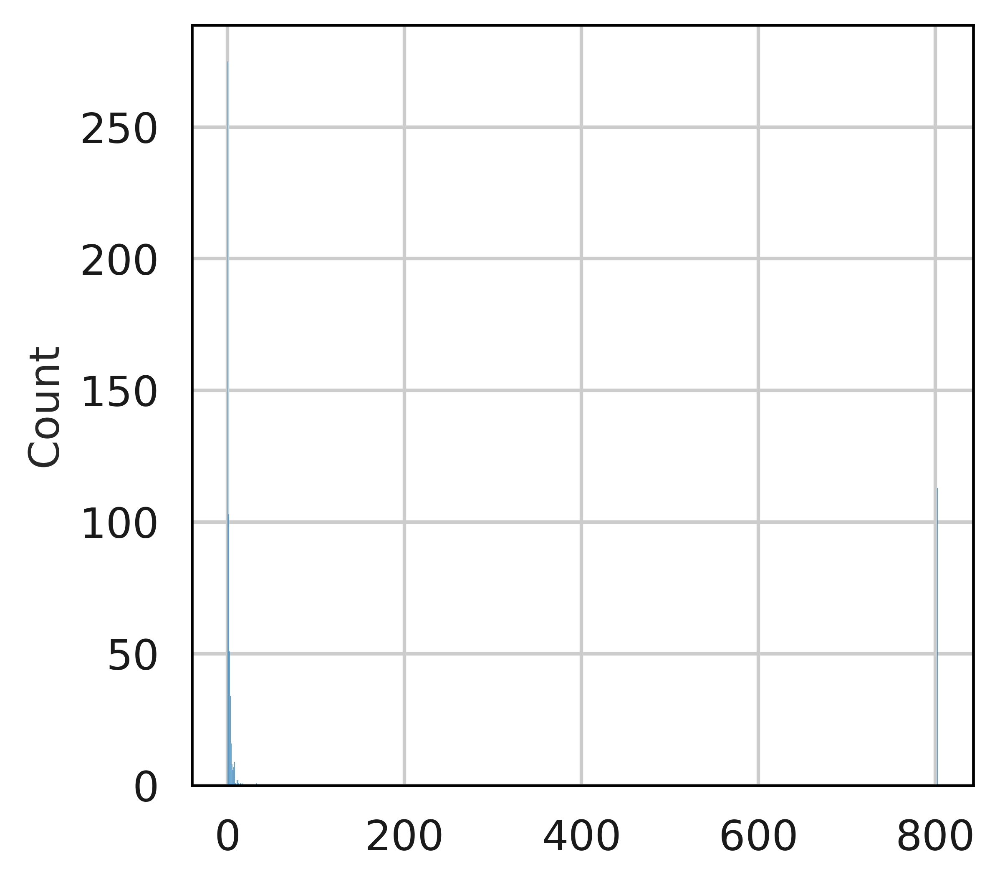

In [216]:
sns.histplot((vcf_with_sample_names_gex.iloc[:, 9:]!='nan').sum(), )

In [213]:
cells=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_core_somatic/cellSNP.samples.tsv', sep="\t", header=None)


sample_names = cells[0].tolist()

# Read cellSNP.cells.vcf file
vcf_df_atac = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_core_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns = vcf_df_atac.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns = vcf_df_atac.iloc[:, 9:]   # Assuming remaining columns are sample genotypes

# Rename sample columns with sample names
sample_columns.columns = sample_names
sample_columns=sample_columns[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]

# Concatenate variant columns with renamed sample columns
vcf_with_sample_names_atac = pd.concat([variant_columns, sample_columns], axis=1)

vcf_with_sample_names_atac=vcf_with_sample_names_atac.replace('.:.:.:.:.:.', 'nan')
vcf_with_sample_names_atac

#отбираем только мутации прошедшие фильрт
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']


vcf_with_sample_names_atac=vcf_with_sample_names_atac.rename(columns={0:'Chromosome', 1:'Start_Position'})
vcf_with_sample_names_atac = pd.merge(vcf_with_sample_names_atac, maf_df_tissue, on=["Chromosome", "Start_Position"], how="inner")
vcf_with_sample_names_atac

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACGGATCATTGCAA-1,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,chr1,202217,.,G,A,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202217,0.64
1,chr1,789671,.,G,C,.,PASS,AD=2;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,789671,1.00
2,chr1,1783824,.,G,C,.,PASS,AD=1;DP=15;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1783824,1.00
3,chr1,1900573,.,C,A,.,PASS,AD=1;DP=11;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900573,1.00
4,chr1,2208463,.,T,G,.,PASS,AD=0;DP=21;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2208463,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2503,chrY,11322165,.,A,C,.,PASS,AD=6;DP=13;OTH=5,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11322165,NaN
2504,chrY,11322179,.,G,A,.,PASS,AD=3;DP=29;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11322179,NaN
2505,chrY,11322331,.,G,T,.,PASS,AD=6;DP=64;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11322331,NaN
2506,chrY,56846310,.,A,T,.,PASS,AD=0;DP=11;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56846310,NaN


<Axes: ylabel='Count'>

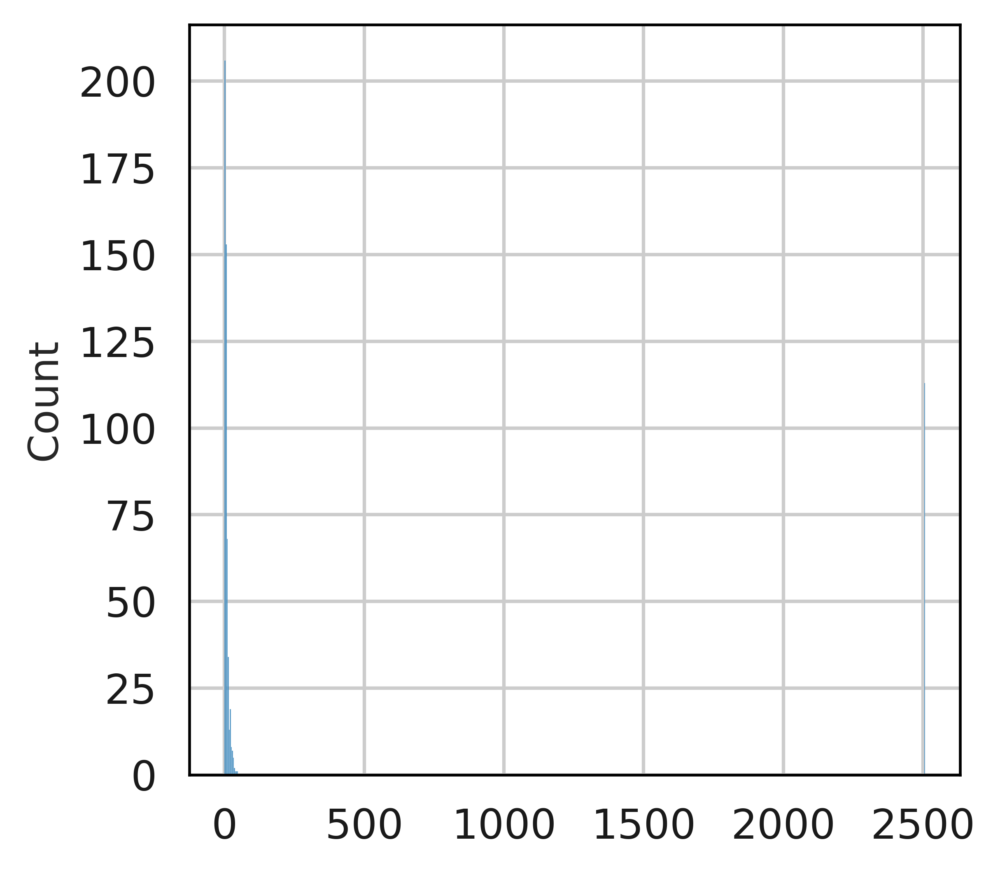

In [214]:
sns.histplot((vcf_with_sample_names_atac.iloc[:, 9:]!='nan').sum(), )

In [ ]:
vcf_with_sample_names_atac.iloc[:, 9:].iloc[:, :519]

In [222]:
(vcf_with_sample_names_atac.iloc[:, 9:] != 'nan').sum()

AAACGGATCATTGCAA-1      29
AAACGGATCTCAATTC-1       4
AAAGCGGGTCATGCAA-1       3
AAAGCTTGTCACTCGC-1       0
AAAGCTTGTTAGGATT-1       1
                      ... 
gnomAD_NFE_AF         2508
gnomAD_OTH_AF         2508
gnomAD_SAS_AF         2508
vcf_pos               2508
MAPPABILITY           2508
Length: 631, dtype: int64

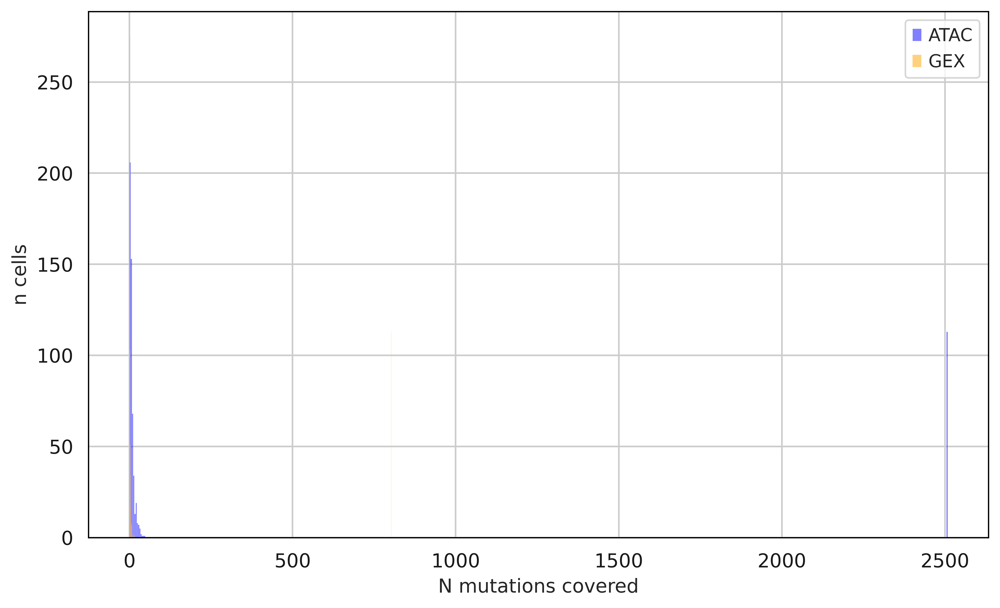

In [218]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create the figure
plt.figure(figsize=(10, 6))

# Plot the first histogram for ATAC data
sns.histplot((vcf_with_sample_names_atac.iloc[:, 9:] != 'nan').sum(), 
             color='blue', label='ATAC', kde=False, alpha=0.5, )

# Plot the second histogram for GEX data
sns.histplot((vcf_with_sample_names_gex.iloc[:, 9:] != 'nan').sum(), 
             color='orange', label='GEX', kde=False, alpha=0.5)

# Add labels and a title
plt.xlabel('N mutations covered')
plt.ylabel('n cells')
plt.title('')

# Show the legend to differentiate between ATAC and GEX
plt.legend()

# Display the plot
plt.show()


## visualize coverage and n of mutations in UMAP plots

In [67]:
import scanpy as sc
rna = sc.read('/home/alexandra.livanova/ROVIGO/multiome/BTROHT_01_02_04_core/BTROHT01_rna_muon_new.h5ad')
rna

AnnData object with n_obs × n_vars = 382 × 36588
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'cell_typist_majority_voting_AdultAged_Hippocampus', 'cell_typist_predicted_labels_AdultAged_Hippocampus', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'celltypist_conf_score_AdultAged_Hippocampus', 'cnv_raw_l1', 'cnv_raw_l2', 'cnv_score', 'cnv_leiden', 'celltype_with_tumor', 'celltype', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cell_typist_majority_voting_AdultAged_Hippocampus_colors', 'cell_typist_predicted_labels_AdultAged_Hippocampus_colors', 'celltype_colors', 'cnv_leiden_colors', 'dendrogram_celltype', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups'

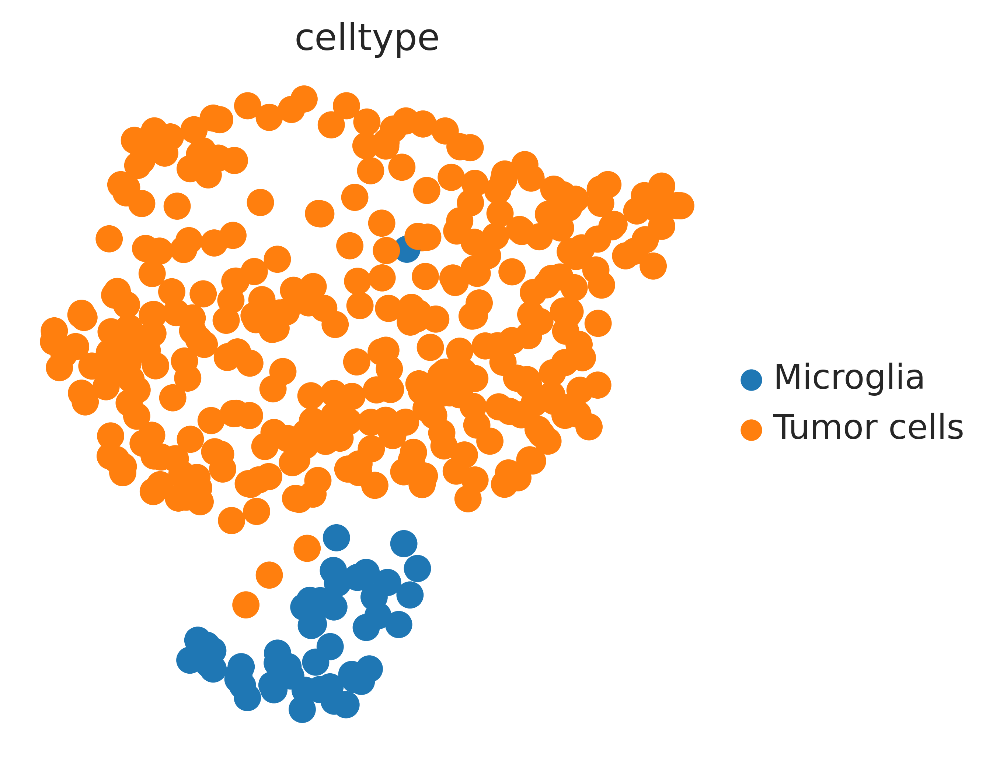

In [44]:

sc.pl.umap(rna, color=['celltype'])

In [48]:
rna.obs['mut_pos_covered_gex']=(vcf_with_sample_names_gex.iloc[:, 9:]!='nan').sum().reindex(rna.obs_names)
rna.obs['mut_pos_covered_atac']=(vcf_with_sample_names_atac.iloc[:, 9:]!='nan').sum().reindex(rna.obs_names)


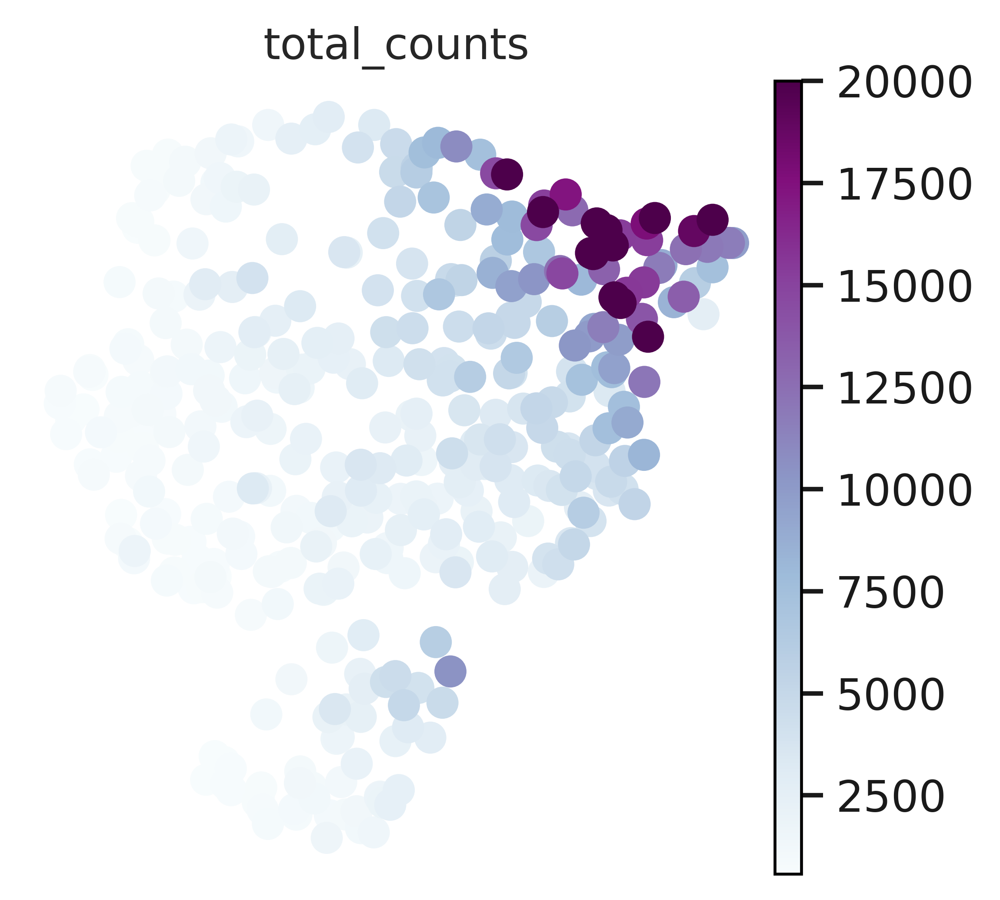

In [49]:
sc.pl.umap(rna, color=['total_counts'], vmax=20000, ncols=1, cmap='BuPu')

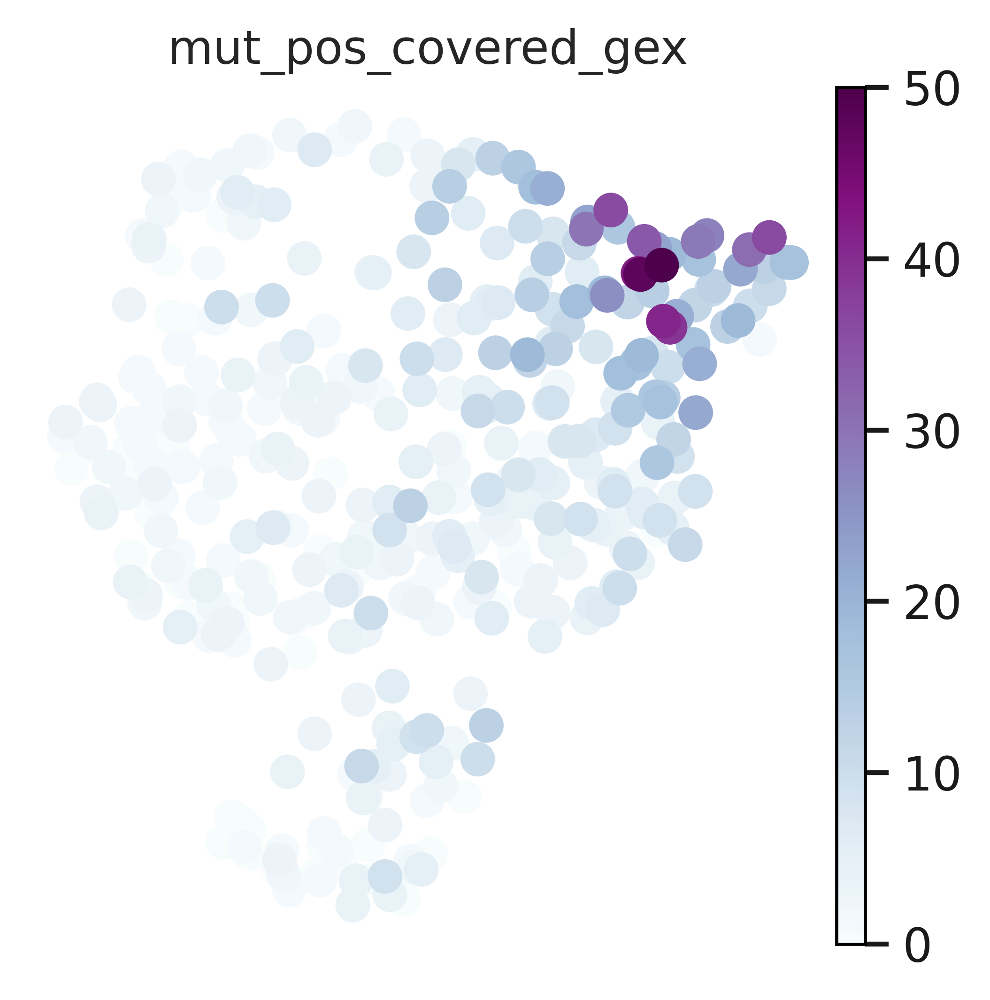

In [51]:
sc.pl.umap(rna, color=['mut_pos_covered_gex'], vmax=50, ncols=1, cmap='BuPu')

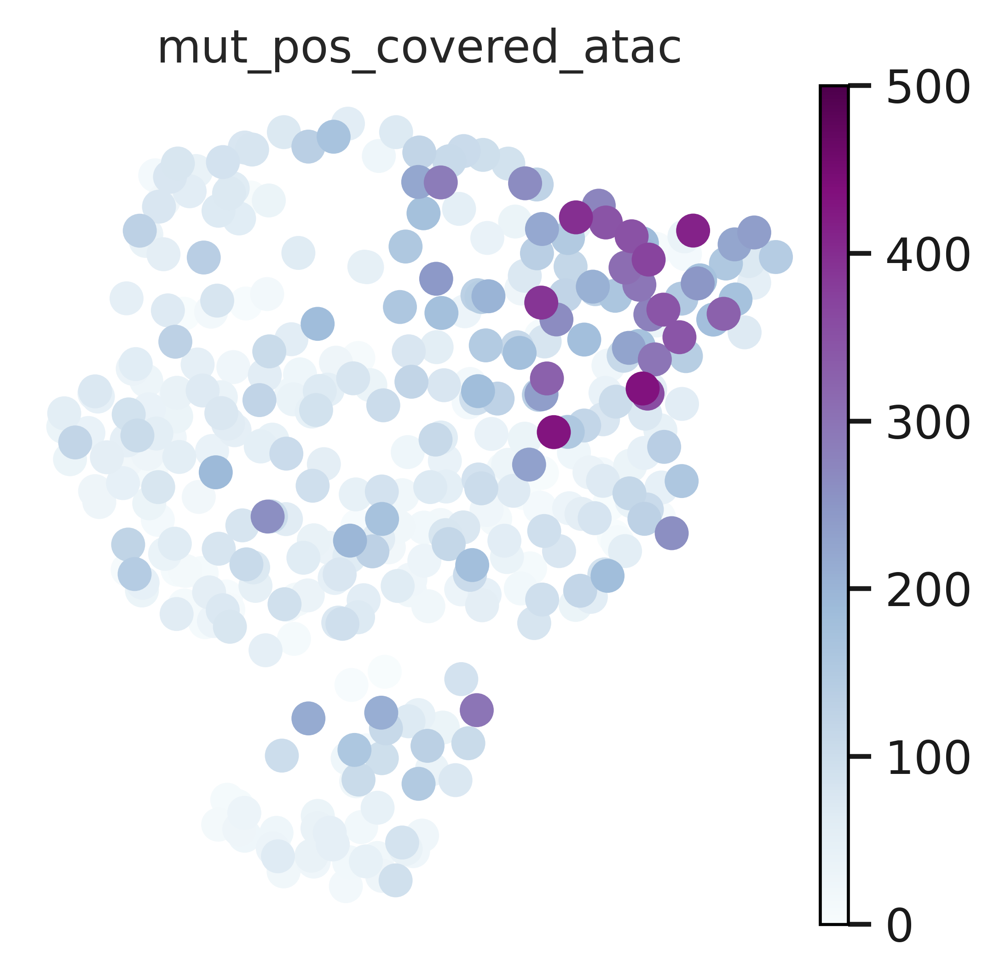

In [52]:
sc.pl.umap(rna, color=['mut_pos_covered_atac'], vmax=500, ncols=1, cmap='BuPu')

check correlation between n of mutations covered and total n of reads

In [130]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import pearsonr, spearmanr

def regplot(data1, data2, reg=True, figsize=(4, 4), ax=None, color=None, show_p=True,
            correlation='pearson', title='', ci=0, offsetx=None, offsety=None,
            pvalue_alpha=0, show_pv_on_title=True, s=35, annotate_points=None):
    """
    Plot bivariate graph with linear regression of two vectors
    :param data1: pd.Series
    :param data2: pd.Series
    :param reg: bool, whether to plot regression
    :param figsize: (float, float), figure size in inches
    :param ax: matplotlib axis, axis to plot on
    :param color: str, color to use
    :param show_p: bool, whether to show p value in legend
    :param correlation: 'pearson' or 'spearman'
    :param title: str, plot title
    :param ci: float, confidence interval for regression
    :param offsetx: float, x offset for pvalue string. If None, will be calculated automatically
    :param offsety: float, y offset for pvalue string. If None, will be calculated automatically
    :param pvalue_alpha: float, alpha for pvalue string
    :param show_pv_on_title: bool, whether to plot pvalue and correlation on title, if False - show on the plot
    :param s: int, size of the point
    :param annotate_points: list of indices to annotate with Hugo_symbol_y values
    :return: matplotlib axis
    """

    ind = data1.dropna().index.intersection(data2.dropna().index)

    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    ax.set_xlabel('Total reads')
    ax.set_ylabel('n mutations')

    if reg:
        sns.regplot(
            x=data1[ind].values,
            y=data2[ind].values,
            fit_reg=True,
            ax=ax,
            color=color,
            ci=ci,
            scatter_kws={'s': s},
        )

        if offsetx is None:
            offsetx = (ax.get_xlim()[1] - ax.get_xlim()[0]) / 20
        if offsety is None:
            offsety = (ax.get_ylim()[1] - ax.get_ylim()[0]) / 20

        if correlation == 'pearson':
            p = pearsonr(data1[ind].values, data2[ind].values)
            corr_text = 'pearson_r='
        elif correlation == 'spearman':
            p = spearmanr(data1[ind].values, data2[ind].values)
            corr_text = 'spearman_r='
        else:
            raise Exception('Unknown correlation type')

        if show_p:
            pvalue = format(p[1], '.2g')
            corr = round(p[0], 2)
            p_text = f'{corr_text}{corr}, p={pvalue}'

            if show_pv_on_title:
                title = f'{title}\n{p_text}'
            else:
                ax.text(
                    x=ax.get_xlim()[0] + offsetx,
                    y=ax.get_ylim()[0] + offsety,
                    s=p_text,
                    bbox=dict(facecolor='white', alpha=pvalue_alpha),
                )

    else:
        sns.regplot(
            x=data1[ind].values, y=data2[ind].values, fit_reg=False, ax=ax, color=color
        )

    ax.set_title(title)

    # Annotate points
    if annotate_points is not None:
        for gene in annotate_points:
            ax.annotate(
                text=gene,  # or use data2.index[idx] for the other axis
                xy=(data1.iloc[maf_merged_in[maf_merged_in['Hugo_Symbol_y']==gene].index], data2.iloc[maf_merged_in[maf_merged_in['Hugo_Symbol_y']==gene].index]),
                xytext=(20, -10),
                textcoords='offset points',
                arrowprops=dict(arrowstyle='->', color='black')
            )

    return ax


In [132]:
rna = rna[rna.obs.total_counts < 2000, :]

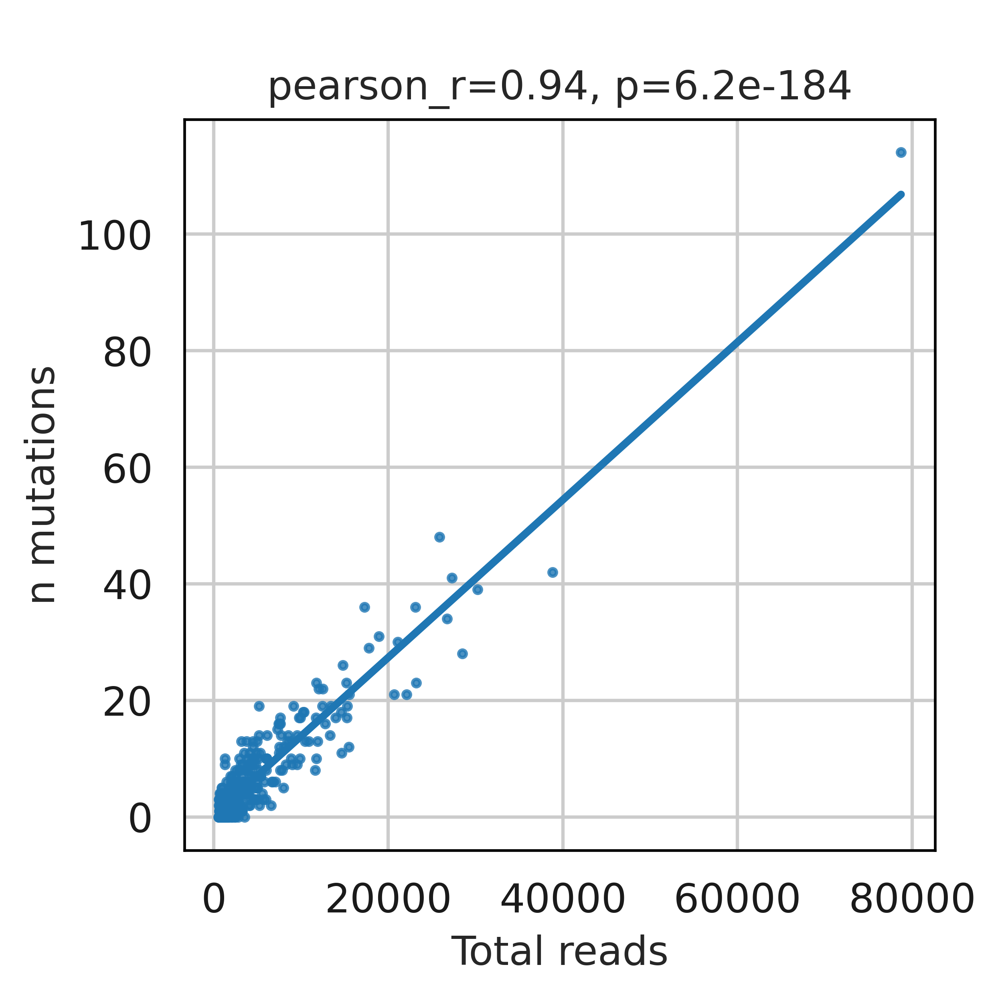

In [260]:
regplot(data1=rna.obs['total_counts'].astype('float32'), data2=rna.obs['mut_sum_gex'].astype('float32'), s=5
    )
plt.show()

In [268]:
atac=sc.read('/scratch/alexandra.livanova/ROVIGO/multiome/BTROHT_01_02_04/BTROHT01_atac_muon_new2.h5ad')
atac

AnnData object with n_obs × n_vars = 518 × 152566
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'atac', 'files'

In [269]:
atac.obs['mut_sum_atac']=(vcf_with_sample_names_atac.iloc[:, 9:]!='nan').sum().reindex(atac.obs_names)


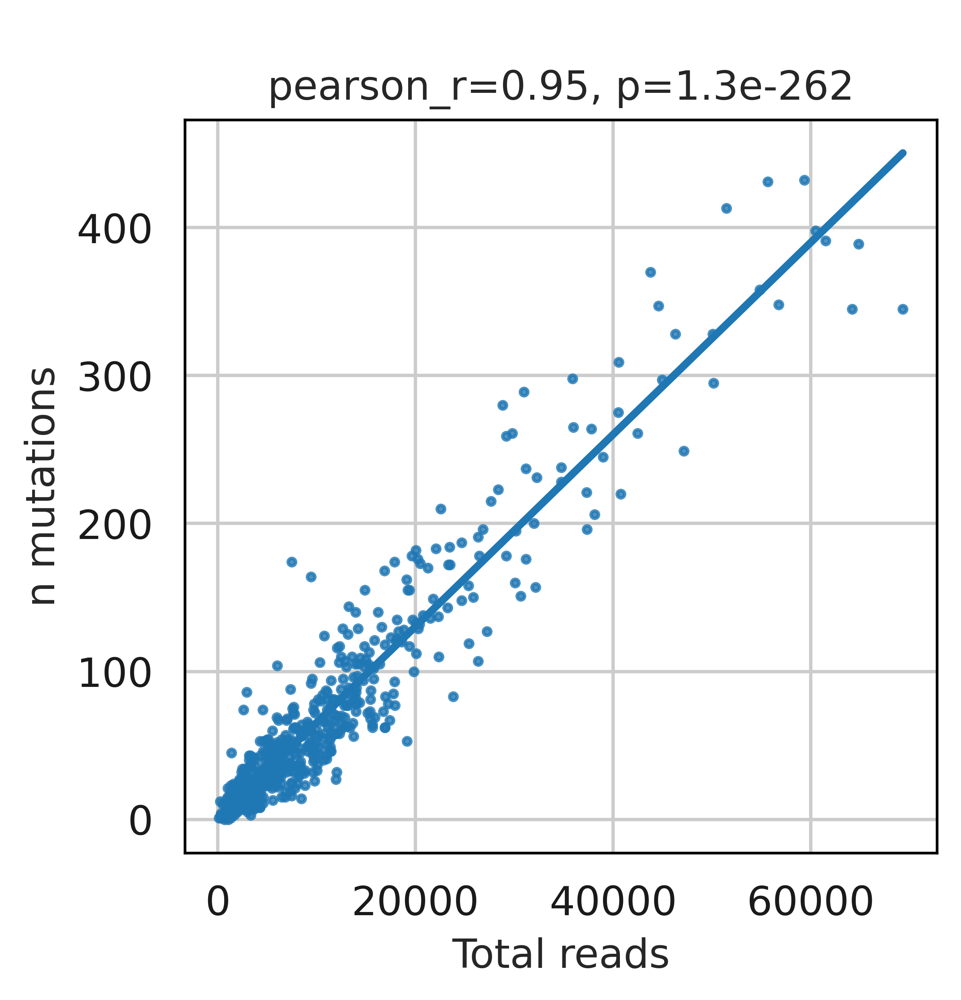

In [270]:
regplot(data1=atac.obs['total_counts'].astype('float32'), data2=atac.obs['mut_sum_atac'].astype('float32'), s=5
        )
plt.show()

посчитаем для каждой клетки сколько в ней мутаций с альтеранивными ридами

In [88]:
#функция чтобы считать ненулевые AD в всф для клетки
def extract_n_mut_per_cell(row):
    ad_sum = 0
    for item in row:
        if pd.notna(item) and ':' in item:
            try:
                ad = int(item.split(':')[1])
                if ad!=0:
                    ad_sum += 1
            except ValueError:
                continue
    return ad_sum

def extract_n_covered_per_cell(row):
    dp_sum = 0
    for item in row:
        if pd.notna(item) and ':' in item:
            try:
                dp = int(item.split(':')[2])
                if dp!=0:
                    dp_sum += 1
            except ValueError:
                continue
    return dp_sum

отберем только те мутации которые прошли фильтр в вгс

In [55]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)
maf_df_tissue=maf_df_tissue[maf_df_tissue['FILTER']=='PASS']
maf_df_tissue

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
1,OR4G4P,0,.,GRCh38,chr1,55545,55545,+,3'Flank,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,55545,1.00
3,OR4F5,0,.,GRCh38,chr1,72140,72141,+,3'Flank,INS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72140,0.76
6,ENST00000466430,0,.,GRCh38,chr1,108297,108297,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,108297,1.00
7,ENST00000466430,0,.,GRCh38,chr1,109488,109488,+,Intron,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,109488,0.52
12,Unknown,0,.,GRCh38,chr1,202217,202217,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202217,0.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407223,CTBP2P1,0,.,GRCh38,chrY,56858319,56858320,+,3'Flank,DEL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56858318,NaN
407243,Unknown,0,.,GRCh38,chrY,56863671,56863671,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56863671,NaN
407282,Unknown,0,.,GRCh38,chrY,56877135,56877135,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56877135,NaN
407294,Unknown,0,.,GRCh38,chrY,56883135,56883135,+,IGR,SNP,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56883135,NaN


In [56]:
vcf_with_sample_names_atac=vcf_with_sample_names_atac.rename(columns={0:'Chromosome', 1:'Start_Position'})
merged_table = pd.merge(vcf_with_sample_names_atac, maf_df_tissue, on=["Chromosome", "Start_Position"], how="inner")
sample_columns=merged_table[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]
sum_AD_atac = sample_columns.apply(extract_n_mut_per_cell, axis=0)
sum_AD_atac

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACGGATCATTGCAA-1,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,chr1,202217,.,G,A,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202217,0.64
1,chr1,789671,.,G,C,.,PASS,AD=2;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,789671,1.00
2,chr1,1783824,.,G,C,.,PASS,AD=1;DP=15;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1783824,1.00
3,chr1,1900573,.,C,A,.,PASS,AD=1;DP=11;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900573,1.00
4,chr1,2208463,.,T,G,.,PASS,AD=0;DP=21;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2208463,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2503,chrY,11322165,.,A,C,.,PASS,AD=6;DP=13;OTH=5,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11322165,NaN
2504,chrY,11322179,.,G,A,.,PASS,AD=3;DP=29;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11322179,NaN
2505,chrY,11322331,.,G,T,.,PASS,AD=6;DP=64;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11322331,NaN
2506,chrY,56846310,.,A,T,.,PASS,AD=0;DP=11;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56846310,NaN


In [211]:
vcf_with_sample_names_gex=vcf_with_sample_names_gex.rename(columns={0:'Chromosome', 1:'Start_Position'})
merged_table = pd.merge(vcf_with_sample_names_gex, maf_df_tissue, on=["Chromosome", "Start_Position"], how="inner")
sample_columns=merged_table[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]
sum_AD_gex = sample_columns.apply(extract_n_mut_per_cell, axis=0)
sum_AD_gex

AAACGGATCATTGCAA-1    0
AAACGGATCTCAATTC-1    0
AAAGCGGGTCATGCAA-1    0
AAAGCTTGTCACTCGC-1    0
AAAGCTTGTTAGGATT-1    1
                     ..
TTTGCGGAGCCAGTAT-1    0
TTTGGTGCACACAATT-1    2
TTTGTCTAGGACGTAA-1    0
TTTGTGGCAAGTCGCT-1    0
TTTGTTGGTGCTAGAC-1    0
Length: 518, dtype: int64

In [68]:
rna.obs['mut_sum_gex']=sum_AD_gex.reindex(rna.obs_names)
rna.obs['mut_sum_atac']=sum_AD_atac.reindex(rna.obs_names)


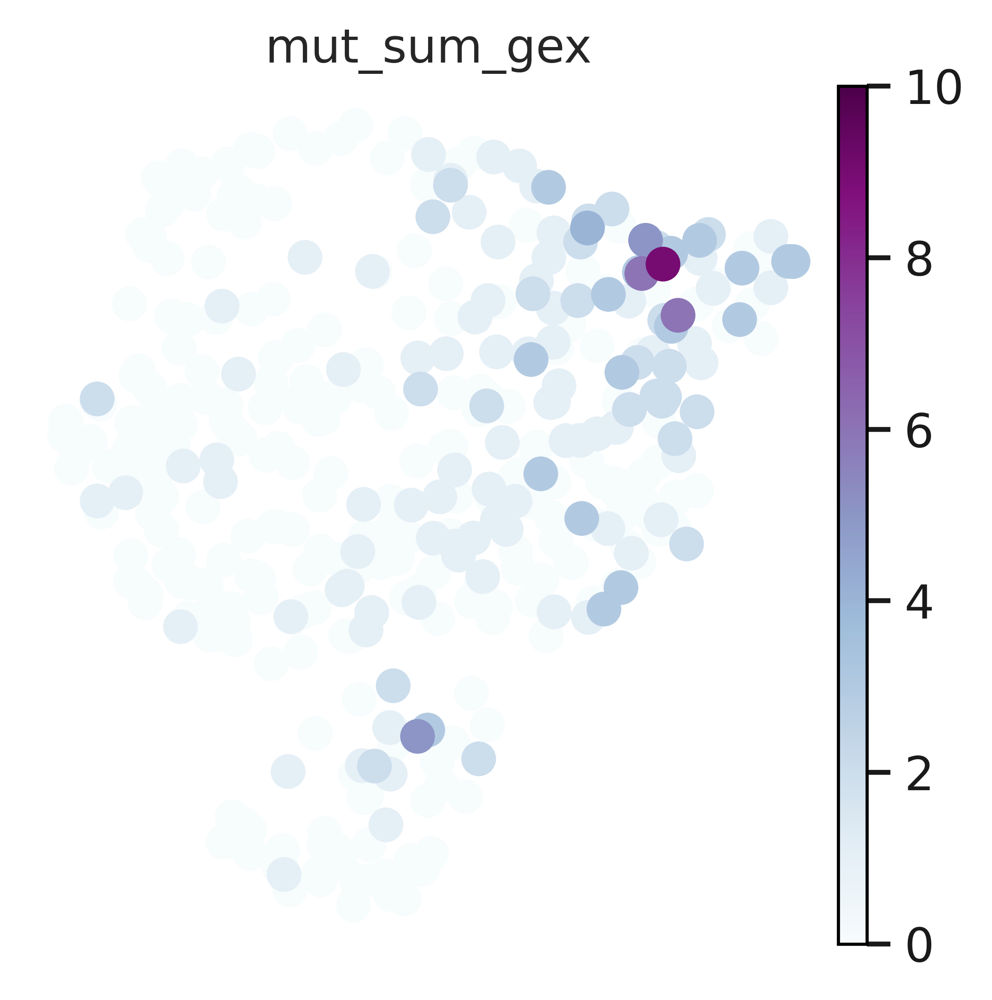

In [77]:
sc.pl.umap(rna, color=['mut_sum_gex'], vmax=10, ncols=1, cmap='BuPu')

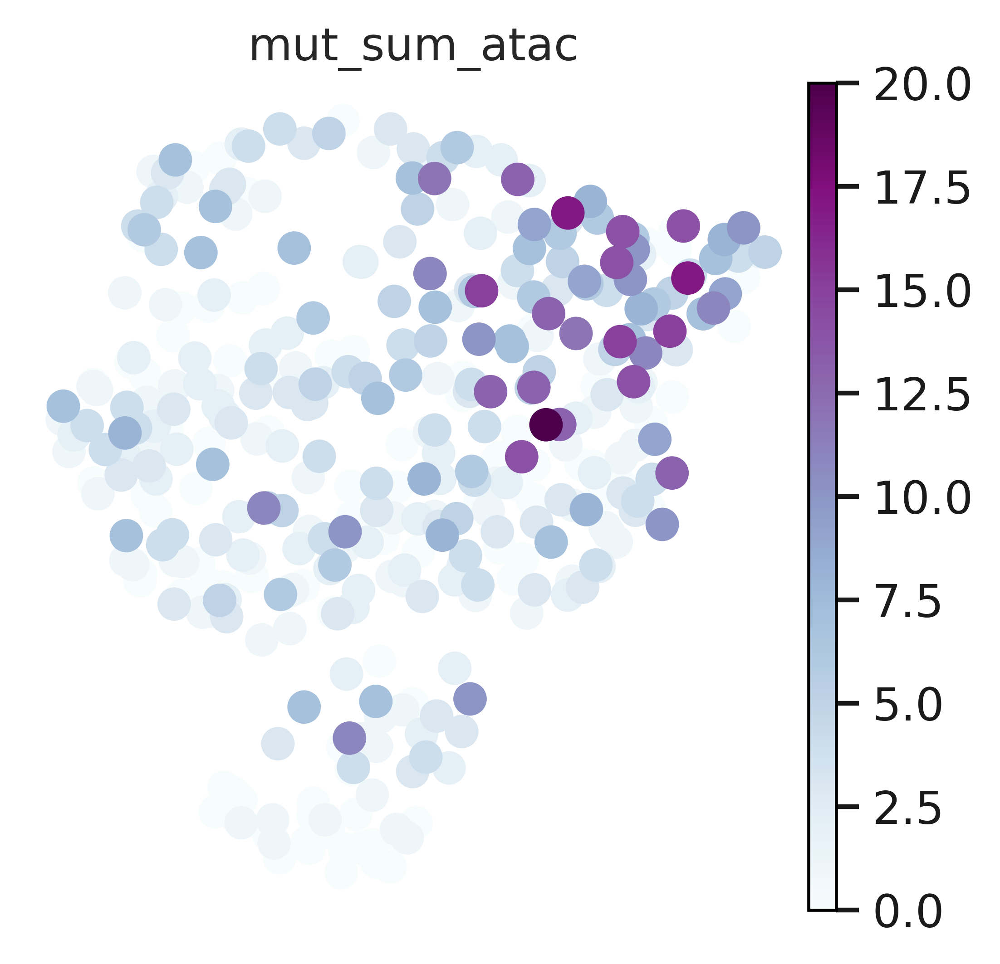

In [78]:
sc.pl.umap(rna, color=[ 'mut_sum_atac'], vmax=20, ncols=1, cmap='BuPu')

<Axes: xlabel='celltype', ylabel='mut_sum_gex'>

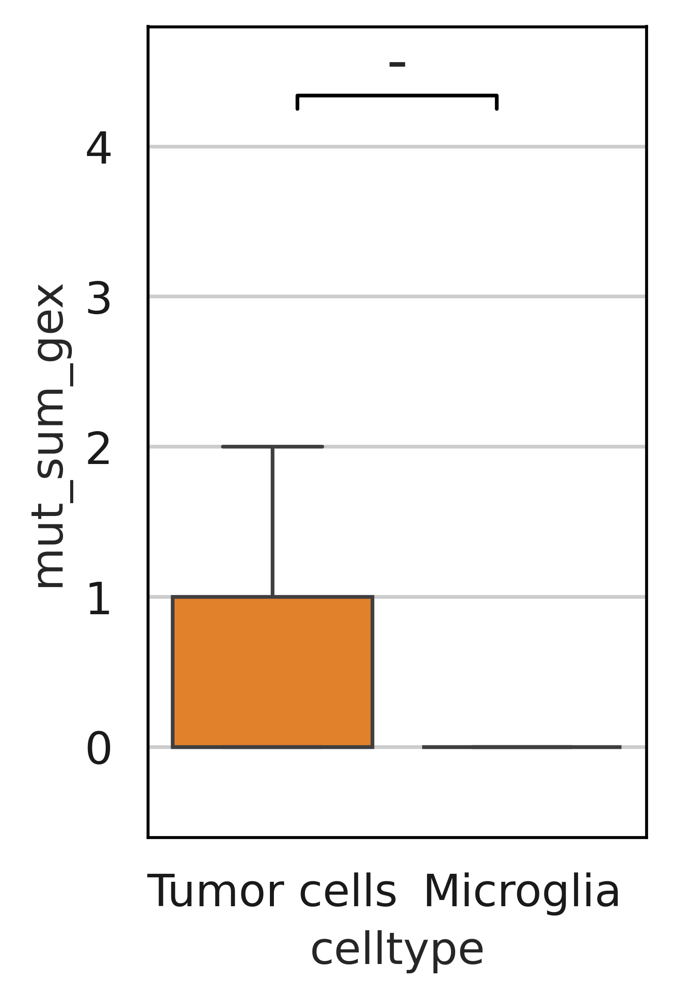

In [86]:
boxplot_with_pvalue(rna.obs['mut_sum_gex'], rna.obs['celltype'], palette={'Microglia':'#1f77b4', 
                                                                           'Tumor cells':'#ff7f0e'}, 
                     y_max=4, swarm=False)

<Axes: xlabel='celltype', ylabel='mut_sum_atac'>

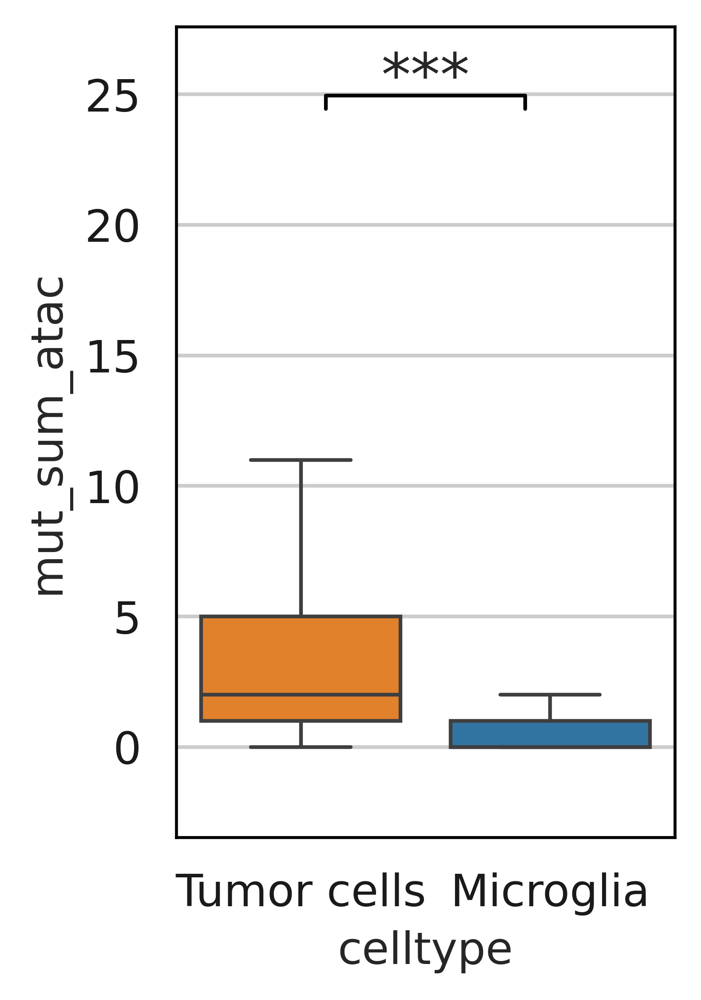

In [85]:
boxplot_with_pvalue(rna.obs['mut_sum_atac'], rna.obs['celltype'], palette={'Microglia':'#1f77b4', 
                                                                           'Tumor cells':'#ff7f0e'}, 
                     swarm=False)

<Axes: xlabel='celltype', ylabel='None'>

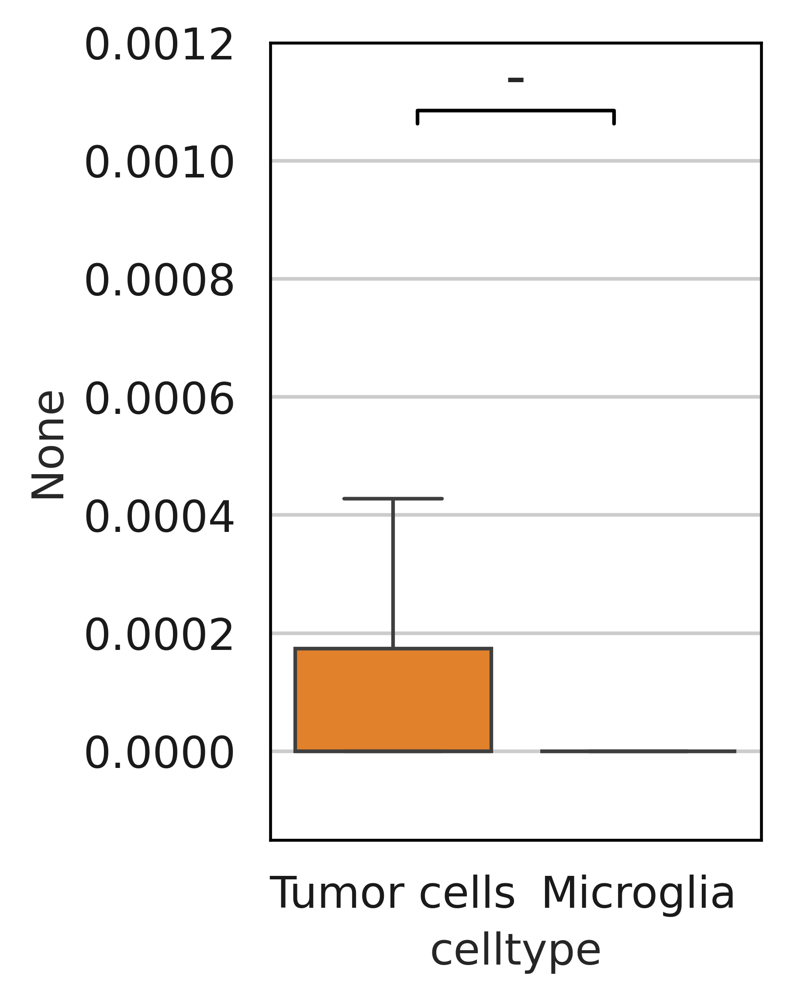

In [82]:
boxplot_with_pvalue(rna.obs['mut_sum_gex']/rna.obs['total_counts'], rna.obs['celltype'], palette={'Microglia':'#1f77b4', 
                                                                           'Tumor cells':'#ff7f0e'}, 
                    y_max=0.001, swarm=False)

<Axes: xlabel='celltype', ylabel='None'>

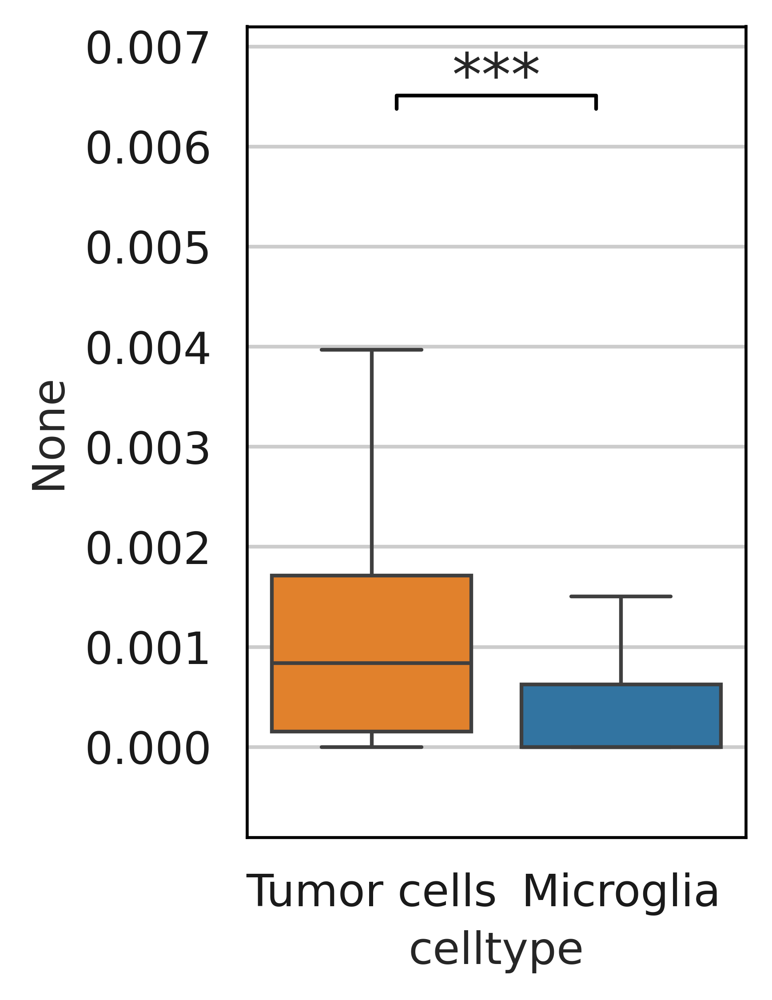

In [83]:
boxplot_with_pvalue(rna.obs['mut_sum_atac']/rna.obs['total_counts'], rna.obs['celltype'], palette={'Microglia':'#1f77b4', 
                                                                           'Tumor cells':'#ff7f0e'}, y_max=0.006, swarm=False)

теперь мы можем пойти еще дальше и посчитать в каждой клетке соотношение ридов с мутациями и ридов с реыеренсами

In [89]:
merged_table = pd.merge(vcf_with_sample_names_atac, maf_df_tissue, on=["Chromosome", "Start_Position"], how="inner")
sample_columns=merged_table[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]
sum_DP_atac = sample_columns.apply(extract_n_covered_per_cell, axis=0)
sum_DP_atac

AAACGGATCATTGCAA-1    29
AAACGGATCTCAATTC-1     4
AAAGCGGGTCATGCAA-1     3
AAAGCTTGTCACTCGC-1     0
AAAGCTTGTTAGGATT-1     1
                      ..
TTTGCGGAGCCAGTAT-1    15
TTTGGTGCACACAATT-1    22
TTTGTCTAGGACGTAA-1     4
TTTGTGGCAAGTCGCT-1    10
TTTGTTGGTGCTAGAC-1     0
Length: 518, dtype: int64

In [90]:
merged_table = pd.merge(vcf_with_sample_names_gex, maf_df_tissue, on=["Chromosome", "Start_Position"], how="inner")
sample_columns=merged_table[demultiplexing[demultiplexing['final_donor_id']=='BTROHT01_germline'].index.tolist()]
sum_DP_gex = sample_columns.apply(extract_n_covered_per_cell, axis=0)
sum_DP_gex

AAACGGATCATTGCAA-1    3
AAACGGATCTCAATTC-1    1
AAAGCGGGTCATGCAA-1    0
AAAGCTTGTCACTCGC-1    0
AAAGCTTGTTAGGATT-1    2
                     ..
TTTGCGGAGCCAGTAT-1    0
TTTGGTGCACACAATT-1    5
TTTGTCTAGGACGTAA-1    0
TTTGTGGCAAGTCGCT-1    0
TTTGTTGGTGCTAGAC-1    0
Length: 518, dtype: int64

In [91]:
rna.obs['n_covered_gex']=sum_DP_gex.reindex(rna.obs_names)
rna.obs['n_covered_atac']=sum_DP_atac.reindex(rna.obs_names)


In [99]:
rna.obs['n_REF_only_atac']=rna.obs['n_covered_atac']-rna.obs['mut_sum_atac']

In [100]:
rna.obs[['mut_sum_atac', 'n_covered_atac', 'n_REF_only_atac']].reindex(rna.obs[rna.obs['celltype']=='Microglia'].index)

,mut_sum_atac,n_covered_atac,n_REF_only_atac
AAGTTAGCATCACTTC-1,1,6,5
AATCGCCCATGATTGT-1,0,1,1
ACCTCACTCAACAAGG-1,2,12,10
ACTTACTTCAGCAAGA-1,1,1,0
AGAAACTAGCTTCTCA-1,4,7,3
AGCAAATAGTTTGGTA-1,1,4,3
AGCGCTCAGGCCTGGT-1,3,15,12
AGCTAACTCGGCTAGC-1,3,12,9
AGTAGGATCTCGCCTG-1,0,1,1
ATCATGTCACAAAGAC-1,1,8,7


In [178]:
rna.obs['ratio_atac']=rna.obs['mut_sum_atac']/rna.obs['n_covered_atac']
rna.obs['ratio_gex']=rna.obs['mut_sum_gex']/rna.obs['n_covered_gex']

<Axes: xlabel='celltype', ylabel='ratio_gex'>

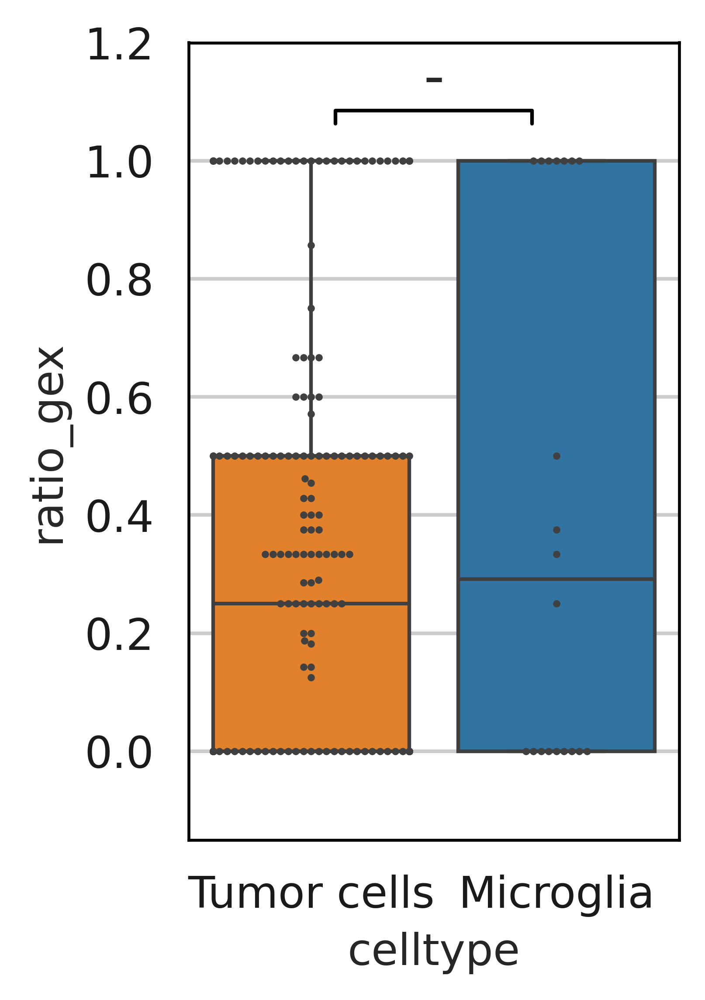

In [194]:
boxplot_with_pvalue(rna.obs['ratio_gex'], 
                    rna.obs['celltype'], 
                    palette={'Microglia':'#1f77b4', 'Tumor cells':'#ff7f0e'},
                    swarm=True, s=2)

In [116]:
rna.obs.loc['ATGTAACGTCTATCGT-1', ['mut_sum_atac', 'n_covered_atac', 'n_REF_only_atac']]

mut_sum_atac       0
n_covered_atac     0
n_REF_only_atac    0
Name: ATGTAACGTCTATCGT-1, dtype: object

In [186]:
rna.obs['celltype']=rna.obs['celltype'].astype('str')
data=rna.obs[['mut_sum_atac','n_covered_atac', 'ratio_atac',
        'mut_sum_gex','n_covered_gex', 'ratio_gex', 'celltype']]
data=data.fillna(0)

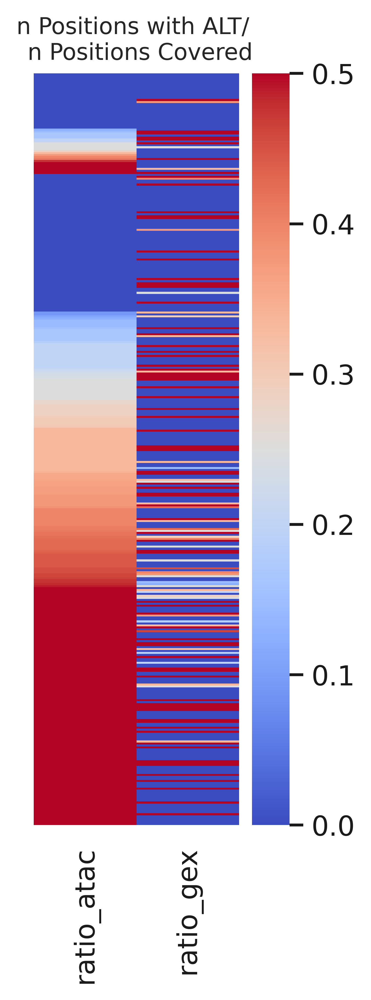

In [188]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming rna.obs is your DataFrame
data = data[['ratio_atac', 'ratio_gex', 'celltype']]  # Include celltype for sorting

# Sort data by 'celltype' and then by 'ratio' within each celltype, and drop NaNs
data_sorted = data.sort_values(by=['celltype', 'ratio_atac']).dropna()

# Extract the sorted 'ratio' column
sorted_ratio = data_sorted[['ratio_atac', 'ratio_gex']]

# Create a mapping for the cell type colors
lut = {'Microglia': '#1f78b4', 'Tumor cells': '#33a02c'}  # Color palette
row_colors = data_sorted['celltype'].map(lut)  # Map the colors to the celltypes

# Create the heatmap
plt.figure(figsize=(2, 6))  # Adjust figure size
sns.heatmap(sorted_ratio, 
             cmap='coolwarm',  # Choose a bright colormap
             linewidths=0,  # Remove lines between cells
             yticklabels=False,  # Use sorted cell types
             vmax=0.5)  # Adjust color bar size

# # Add color for cell types using patches
# for idx, cell_type in enumerate(data_sorted['celltype']):
#     plt.gca().add_patch(plt.Rectangle((1, idx), 1, 1, color=lut[cell_type]))

# Set titles and labels
plt.title('n Positions with ALT/ \n n Positions Covered', fontsize=10)
plt.ylabel('', fontsize=12)
plt.xlabel('', fontsize=12)

# Show the plot
plt.show()


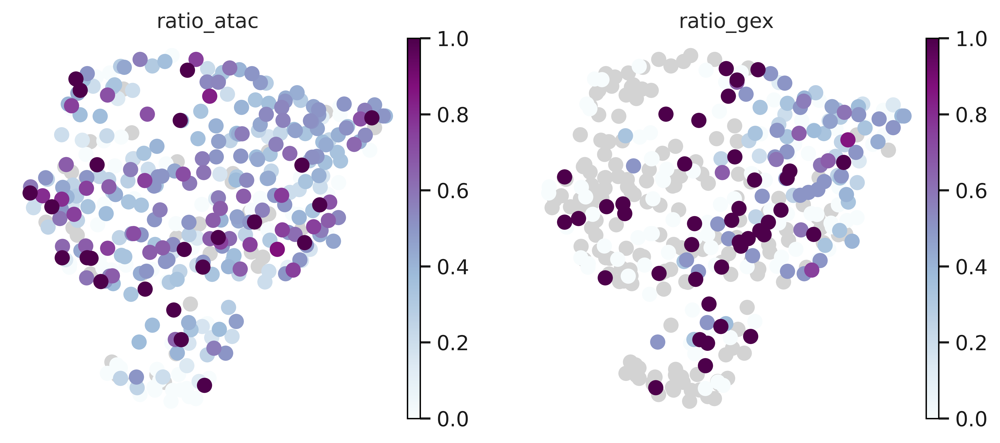

In [192]:
sc.pl.umap(rna, color=['ratio_atac', 'ratio_gex'],cmap='BuPu', vmax=1 )

## сделаем из всего образца сингл селл псеввдобалк и посчитаем вафы мутаций

In [59]:
sample_columns = vcf_with_sample_names.iloc[:, 9:] 
variant_columns = vcf_with_sample_names.iloc[:, :9]

NameError: name 'vcf_with_sample_names' is not defined

In [26]:
sample_columns=sample_columns.replace('nan', None)

In [27]:
def extract_sum_dp(row):
    dp_sum = 0
    for item in row:
        if pd.notna(item) and ':' in item:
            try:
                dp = int(item.split(':')[2])
                dp_sum += dp
            except ValueError:
                continue
    return dp_sum

def extract_sum_ad(row):
    ad_sum = 0
    for item in row:
        if pd.notna(item) and ':' in item:
            try:
                ad = int(item.split(':')[1])
                ad_sum += ad
            except ValueError:
                continue
    return ad_sum

sum_DP = sample_columns.apply(extract_sum_dp, axis=1)
sum_AD = sample_columns.apply(extract_sum_ad, axis=1)

sample_columns['sum_DP']=sum_DP
sample_columns['sum_AD']=sum_AD

In [35]:
sample_columns = sample_columns.iloc[:, :518]
sample_columns

,AAACGGATCATTGCAA-1,AAACGGATCTCAATTC-1,AAAGCGGGTCATGCAA-1,AAAGCTTGTCACTCGC-1,AAAGCTTGTTAGGATT-1,AAAGCTTGTTGTTCAC-1,AAATGGCCACAACCTA-1,AAATGGCCATAAAGCA-1,AACCTCACACTCGCTC-1,AACCTTGCAGGCTTGT-1,...,TTTAACGAGAGGGACT-1,TTTAAGGTCCCATAGG-1,TTTCATCAGCTCCTTA-1,TTTCCTGAGGTTTGAC-1,TTTGACCGTCCTTTAA-1,TTTGCGGAGCCAGTAT-1,TTTGGTGCACACAATT-1,TTTGTCTAGGACGTAA-1,TTTGTGGCAAGTCGCT-1,TTTGTTGGTGCTAGAC-1
0,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
4,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3442,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3443,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3444,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3445,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [39]:
def extract_n_mut_per_cell(row):
    ad_sum = 0
    for item in row:
        if pd.notna(item) and ':' in item:
            try:
                ad = int(item.split(':')[1])
                if ad!=0:
                    ad_sum += 1
            except ValueError:
                continue
    return ad_sum
sum_AD = sample_columns.apply(extract_n_mut_per_cell, axis=0)

In [40]:
sum_AD

AAACGGATCATTGCAA-1    26
AAACGGATCTCAATTC-1     8
AAAGCGGGTCATGCAA-1     6
AAAGCTTGTCACTCGC-1     1
AAAGCTTGTTAGGATT-1     8
                      ..
TTTGCGGAGCCAGTAT-1    12
TTTGGTGCACACAATT-1    29
TTTGTCTAGGACGTAA-1     1
TTTGTGGCAAGTCGCT-1    13
TTTGTTGGTGCTAGAC-1     0
Length: 518, dtype: int64

In [28]:
vcf=pd.concat([variant_columns, sample_columns], axis=1)
vcf

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACGGATCATTGCAA-1,...,TTTCCTGAGGTTTGAC-1,TTTGACCGTCCTTTAA-1,TTTGCGGAGCCAGTAT-1,TTTGGTGCACACAATT-1,TTTGTCTAGGACGTAA-1,TTTGTGGCAAGTCGCT-1,TTTGTTGGTGCTAGAC-1,modality,sum_DP,sum_AD
0,chr1,16257,.,G,C,.,PASS,AD=3;DP=35;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,atac,10,3
1,chr1,202217,.,G,A,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,atac,1,1
2,chr1,202259,.,G,T,.,PASS,AD=5;DP=7;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,atac,1,1
3,chr1,283102,.,T,C,.,PASS,AD=2;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,atac,1,1
4,chr1,630026,.,C,T,.,PASS,AD=6;DP=10;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,atac,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3442,chrX,153581087,.,T,G,.,PASS,AD=1;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,gex,0,0
3443,chrX,154318600,.,C,T,.,PASS,AD=2;DP=3;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,gex,0,0
3444,chrY,11298902,.,G,A,.,PASS,AD=2;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,gex,0,0
3445,chrY,11305405,.,G,T,.,PASS,AD=2;DP=4;OTH=0,GT:AD:DP:OTH:PL:ALL,None,...,None,None,None,None,None,None,None,gex,0,0


In [29]:
vcf_aggregated = vcf.groupby(['Chromosome', 'Start_Position']).agg({
    'sum_DP': 'sum',
    'sum_AD': 'sum'
}).reset_index()
vcf_aggregated

,Chromosome,Start_Position,sum_DP,sum_AD
0,chr1,16257,10,3
1,chr1,202217,1,1
2,chr1,202259,1,1
3,chr1,283102,1,1
4,chr1,630026,2,0
...,...,...,...,...
16749,chrY,56870269,3,0
16750,chrY,56871034,0,0
16751,chrY,56872101,1,0
16752,chrY,56874216,1,1


In [30]:
vcf_aggregated=vcf_aggregated[vcf_aggregated['sum_DP']!=0]

In [31]:
vcf_aggregated

,Chromosome,Start_Position,sum_DP,sum_AD
0,chr1,16257,10,3
1,chr1,202217,1,1
2,chr1,202259,1,1
3,chr1,283102,1,1
4,chr1,630026,2,0
...,...,...,...,...
16745,chrY,56867120,1,0
16748,chrY,56870228,3,0
16749,chrY,56870269,3,0
16751,chrY,56872101,1,0


In [349]:
maf_df_tissue = pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
sep='\t', comment='#', low_memory=False)

merged_table = pd.merge(vcf_aggregated, maf_df_tissue, on=["Chromosome", "Start_Position"], how="left")

#merged_table=merged_table.dropna(subset='Hugo_Symbol')

merged_table

,Chromosome,Start_Position,sum_DP,sum_AD,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,End_Position,Strand,...,gnomAD_AFR_AF,gnomAD_AMR_AF,gnomAD_ASJ_AF,gnomAD_EAS_AF,gnomAD_FIN_AF,gnomAD_NFE_AF,gnomAD_OTH_AF,gnomAD_SAS_AF,vcf_pos,MAPPABILITY
0,chr1,16257,10,3,DDX11L2,0,.,GRCh38,16257,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16257,1.00
1,chr1,202217,1,1,Unknown,0,.,GRCh38,202217,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202217,0.64
2,chr1,202259,1,1,Unknown,0,.,GRCh38,202259,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,202259,0.82
3,chr1,283102,1,1,ENST00000424587,0,.,GRCh38,283102,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,283102,0.96
4,chr1,630026,2,0,MTND2P28,0,.,GRCh38,630026,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,630026,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10084,chrY,56867120,1,0,Unknown,0,.,GRCh38,56867120,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56867120,NaN
10085,chrY,56870228,3,0,Unknown,0,.,GRCh38,56870228,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56870228,NaN
10086,chrY,56870269,3,0,Unknown,0,.,GRCh38,56870269,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56870269,NaN
10087,chrY,56872101,1,0,Unknown,0,.,GRCh38,56872101,+,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56872101,NaN


In [350]:
merged_table=merged_table[[

'Hugo_Symbol','HGVSp', 'Chromosome', 'Start_Position','End_Position','Variant_Classification',
 'sum_DP',
 'sum_AD', 't_alt_count','t_depth' ]]

merged_table['vaf_sc']=merged_table['sum_AD']/merged_table['sum_DP']
merged_table['vaf_sc']=merged_table['vaf_sc'].fillna(0)
merged_table

,Hugo_Symbol,HGVSp,Chromosome,Start_Position,End_Position,Variant_Classification,sum_DP,sum_AD,t_alt_count,t_depth,vaf_sc
0,DDX11L2,NaN,chr1,16257,16257,3'Flank,10,3,20,337,0.3
1,Unknown,NaN,chr1,202217,202217,IGR,1,1,5,51,1.0
2,Unknown,NaN,chr1,202259,202259,IGR,1,1,8,82,1.0
3,ENST00000424587,NaN,chr1,283102,283102,Intron,1,1,10,268,1.0
4,MTND2P28,NaN,chr1,630026,630026,RNA,2,0,21,74,0.0
...,...,...,...,...,...,...,...,...,...,...,...
10084,Unknown,NaN,chrY,56867120,56867120,IGR,1,0,6,491,0.0
10085,Unknown,NaN,chrY,56870228,56870228,IGR,3,0,33,482,0.0
10086,Unknown,NaN,chrY,56870269,56870269,IGR,3,0,6,561,0.0
10087,Unknown,NaN,chrY,56872101,56872101,IGR,1,0,7,407,0.0


In [351]:
merged_table['Tissue_VAF']=merged_table['t_alt_count']/merged_table['t_depth']
merged_table

,Hugo_Symbol,HGVSp,Chromosome,Start_Position,End_Position,Variant_Classification,sum_DP,sum_AD,t_alt_count,t_depth,vaf_sc,Tissue_VAF
0,DDX11L2,NaN,chr1,16257,16257,3'Flank,10,3,20,337,0.3,0.059347
1,Unknown,NaN,chr1,202217,202217,IGR,1,1,5,51,1.0,0.098039
2,Unknown,NaN,chr1,202259,202259,IGR,1,1,8,82,1.0,0.097561
3,ENST00000424587,NaN,chr1,283102,283102,Intron,1,1,10,268,1.0,0.037313
4,MTND2P28,NaN,chr1,630026,630026,RNA,2,0,21,74,0.0,0.283784
...,...,...,...,...,...,...,...,...,...,...,...,...
10084,Unknown,NaN,chrY,56867120,56867120,IGR,1,0,6,491,0.0,0.012220
10085,Unknown,NaN,chrY,56870228,56870228,IGR,3,0,33,482,0.0,0.068465
10086,Unknown,NaN,chrY,56870269,56870269,IGR,3,0,6,561,0.0,0.010695
10087,Unknown,NaN,chrY,56872101,56872101,IGR,1,0,7,407,0.0,0.017199


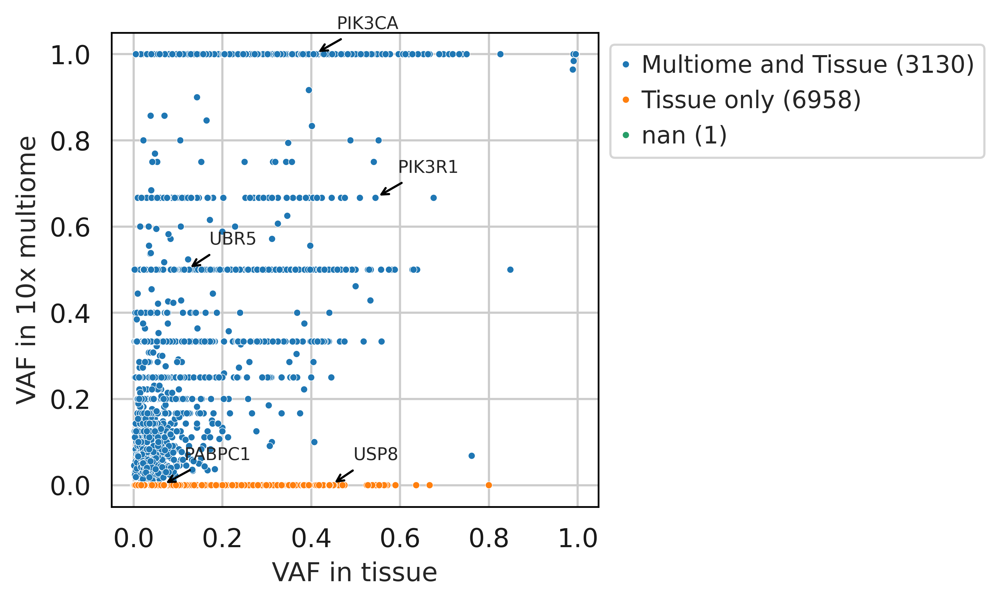

In [352]:
# Assuming 'Presense' column is already added to maf_merged
merged_table['Presense'] = np.where((merged_table['Tissue_VAF'] != 0) & (merged_table['vaf_sc'] != 0), 'Multiome and Tissue',
                                   np.where(merged_table['Tissue_VAF'] == 0, 'nan',
                                            np.where(merged_table['vaf_sc'] == 0, 'Tissue only', np.nan)))

# Create a scatter plot
scatter_plot = sns.scatterplot(x=merged_table['Tissue_VAF'].values, y=merged_table['vaf_sc'].values, 
                               hue=merged_table['Presense'], s=10)

# Get the counts for each category
counts = merged_table['Presense'].value_counts()

# Get legend handles and labels
handles, labels = scatter_plot.get_legend().legendHandles, scatter_plot.get_legend().texts

# Customize the legend with counts
legend_labels = [f'{label.get_text()} ({counts[label.get_text()]})' for label in labels]

# Set new legend labels
scatter_plot.legend(handles, legend_labels, title='', bbox_to_anchor=(1, 1), loc='upper left')

# List of genes to annotate
genes_to_annotate = merged_table[merged_table.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]['Hugo_Symbol'].drop_duplicates().tolist()
scatter_plot.set_xlabel('VAF in tissue')
scatter_plot.set_ylabel('VAF in 10x multiome')
# Annotate the specified genes with arrows and text
for gene in ['PIK3CA', 'PIK3R1', 'USP8', 'PABPC1', 'UBR5']:
    gene_data = merged_table[merged_table['Hugo_Symbol'] == gene].iloc[0]
    scatter_plot.annotate(gene, xy=(gene_data['Tissue_VAF'], gene_data['vaf_sc']),
                          xytext=(gene_data['Tissue_VAF'] + 0.05, gene_data['vaf_sc'] + 0.05),
                          arrowprops=dict(facecolor='black', edgecolor='black', arrowstyle='->'),
                          fontsize=8, ha='left', va='bottom')

# Show the plot
plt.show()

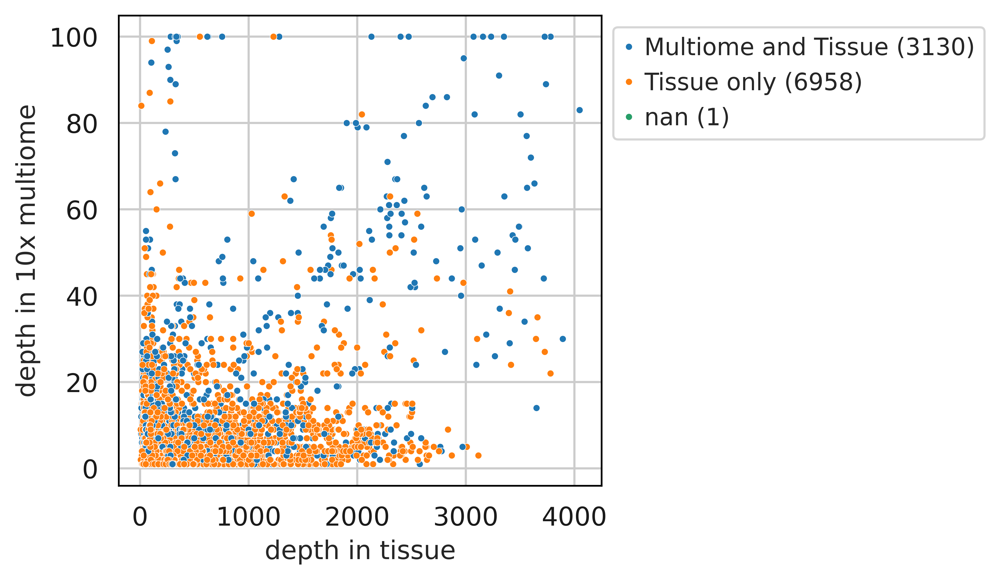

In [353]:
# Create a scatter plot
scatter_plot = sns.scatterplot(x=merged_table['t_depth'].values, y=merged_table['sum_DP'].values.clip(0, 100), 
                               hue=merged_table['Presense'], s=10, )

# Get the counts for each category
counts = merged_table['Presense'].value_counts()

# Get legend handles and labels
handles, labels = scatter_plot.get_legend().legendHandles, scatter_plot.get_legend().texts

# Customize the legend with counts
legend_labels = [f'{label.get_text()} ({counts[label.get_text()]})' for label in labels]

# Set new legend labels
scatter_plot.legend(handles, legend_labels, title='', bbox_to_anchor=(1, 1), loc='upper left')

# List of genes to annotate
genes_to_annotate = merged_table[merged_table.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]['Hugo_Symbol'].drop_duplicates().tolist()
scatter_plot.set_xlabel('depth in tissue')
scatter_plot.set_ylabel('depth in 10x multiome')
# Annotate the specified genes with arrows and text
# for gene in ['PIK3CA', 'PIK3R1', 'USP8', 'PABPC1', 'UBR5']:
#     gene_data = merged_table[merged_table['Hugo_Symbol'] == gene].iloc[0]
#     scatter_plot.annotate(gene, xy=(gene_data['Tissue_VAF'], gene_data['vaf_sc']),
#                           xytext=(gene_data['Tissue_VAF'] + 0.05, gene_data['vaf_sc'] + 0.05),
#                           arrowprops=dict(facecolor='black', edgecolor='black', arrowstyle='->'),
#                           fontsize=8, ha='left', va='bottom')

# Show the plot
plt.show()

In [354]:
# merged_table = merged_table[merged_table.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
#  'Missense_Mutation',
#  'Frame_Shift_Ins',
#  'Frame_Shift_Del',
#  'Nonsense_Mutation',
#  'Nonstop_Mutation',
#  'Translation_Start_Site',
#  'Splice_Site'])]

# merged_table

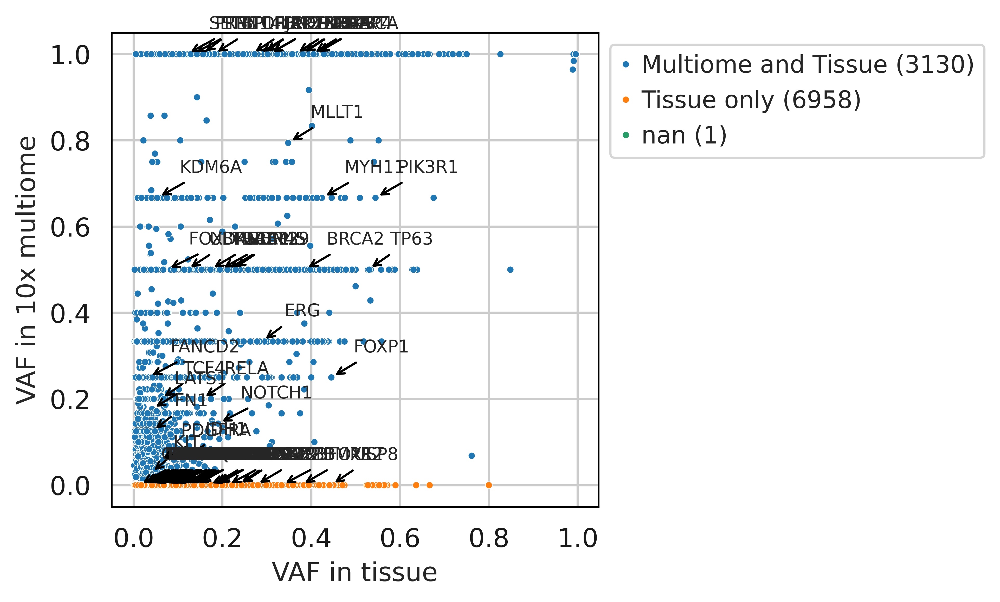

In [355]:
# Assuming 'Presense' column is already added to maf_merged
merged_table['Presense'] = np.where((merged_table['Tissue_VAF'] != 0) & (merged_table['vaf_sc'] != 0), 'Multiome and Tissue',
                                   np.where(merged_table['Tissue_VAF'] == 0, 'nan',
                                            np.where(merged_table['vaf_sc'] == 0, 'Tissue only', np.nan)))

# Create a scatter plot
scatter_plot = sns.scatterplot(x=merged_table['Tissue_VAF'].values, y=merged_table['vaf_sc'].values, 
                               hue=merged_table['Presense'], s=10)

# Get the counts for each category
counts = merged_table['Presense'].value_counts()

# Get legend handles and labels
handles, labels = scatter_plot.get_legend().legendHandles, scatter_plot.get_legend().texts

# Customize the legend with counts
legend_labels = [f'{label.get_text()} ({counts[label.get_text()]})' for label in labels]

# Set new legend labels
scatter_plot.legend(handles, legend_labels, title='', bbox_to_anchor=(1, 1), loc='upper left')

# List of genes to annotate
genes_to_annotate = merged_table[merged_table.Hugo_Symbol.isin(IntOGen.IntOGen.tolist() + ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]['Hugo_Symbol'].drop_duplicates().tolist()
scatter_plot.set_xlabel('VAF in tissue')
scatter_plot.set_ylabel('VAF in 10x multiome')
# Annotate the specified genes with arrows and text
for gene in genes_to_annotate:
    gene_data = merged_table[merged_table['Hugo_Symbol'] == gene].iloc[0]
    scatter_plot.annotate(gene, xy=(gene_data['Tissue_VAF'], gene_data['vaf_sc']),
                          xytext=(gene_data['Tissue_VAF'] + 0.05, gene_data['vaf_sc'] + 0.05),
                          arrowprops=dict(facecolor='black', edgecolor='black', arrowstyle='->'),
                          fontsize=8, ha='left', va='bottom')

# Show the plot
plt.show()

## Mutations across chromosomes - somatics

In [356]:
segs=pd.read_csv(f'/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/sequenza/ploidy_7/gamma_5/TISSUE_10_100/BTROHT01_T3_segments.txt', sep='\t')

chromosome_mapping = {
    'chr1': 1,
    'chr2': 2,
    'chr3': 3,
    'chr4': 4,
    'chr5': 5,
    'chr6': 6,
    'chr7': 7,
    'chr8': 8,
    'chr9': 9,
    'chr10': 10,
    'chr11': 11,
    'chr12': 12,
    'chr13': 13,
    'chr14': 14,
    'chr15': 15,
    'chr16': 16,
    'chr17': 17,
    'chr18': 18,
    'chr19': 19,
    'chr20': 20,
    'chr21': 21,
    'chr22': 22,
    'chrX': 23  # Map 'chrX' to 23
}

# Extract numeric part from 'chromosome' column and map to integers
segs['chrom'] = segs['chromosome'].map(chromosome_mapping)

# Convert the 'chrom' column to integers
#segs['chrom'] = pd.to_numeric(segs['chrom'], errors='coerce')

# Display the updated DataFrame


segs=segs.rename(columns={'start.pos':'start',
                          'CNt':'total',
                          'end.pos':'end',
                          'A':'major',
                          'B':'minor'})

                          
chr_sizes = pd.DataFrame(
    {
        'hg19': pd.Series(
            {
                1: 249250621,
                2: 243199373,
                3: 198022430,
                4: 191154276,
                5: 180915260,
                6: 171115067,
                7: 159138663,
                8: 146364022,
                9: 141213431,
                10: 135534747,
                11: 135006516,
                12: 133851895,
                13: 115169878,
                14: 107349540,
                15: 102531392,
                16: 90354753,
                17: 81195210,
                18: 78077248,
                19: 59128983,
                20: 63025520,
                21: 48129895,
                22: 51304566,
                23: 155270560,
                24: 59373566,
            }
        ),
        'hg38': pd.Series(
            {
                1: 248956422,
                2: 242193529,
                3: 198295559,
                4: 190214555,
                5: 181538259,
                6: 170805979,
                7: 159345973,
                8: 145138636,
                9: 138394717,
                10: 133797422,
                11: 135086622,
                12: 133275309,
                13: 114364328,
                14: 107043718,
                15: 101991189,
                16: 90338345,
                17: 83257441,
                18: 80373285,
                19: 58617616,
                20: 64444167,
                21: 46709983,
                22: 50818468,
                23: 156040895,
                24: 57227415,
            }
        ),
    }
)

chr_end_cs = chr_sizes['hg38'][:-1].cumsum()
chr_end_cs

1      248956422
2      491149951
3      689445510
4      879660065
5     1061198324
6     1232004303
7     1391350276
8     1536488912
9     1674883629
10    1808681051
11    1943767673
12    2077042982
13    2191407310
14    2298451028
15    2400442217
16    2490780562
17    2574038003
18    2654411288
19    2713028904
20    2777473071
21    2824183054
22    2875001522
23    3031042417
Name: hg38, dtype: int64

In [357]:
chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes['hg38'].index)[:-1]
chr_start_cs

1              0
2      248956422
3      491149951
4      689445510
5      879660065
6     1061198324
7     1232004303
8     1391350276
9     1536488912
10    1674883629
11    1808681051
12    1943767673
13    2077042982
14    2191407310
15    2298451028
16    2400442217
17    2490780562
18    2574038003
19    2654411288
20    2713028904
21    2777473071
22    2824183054
23    2875001522
dtype: int64

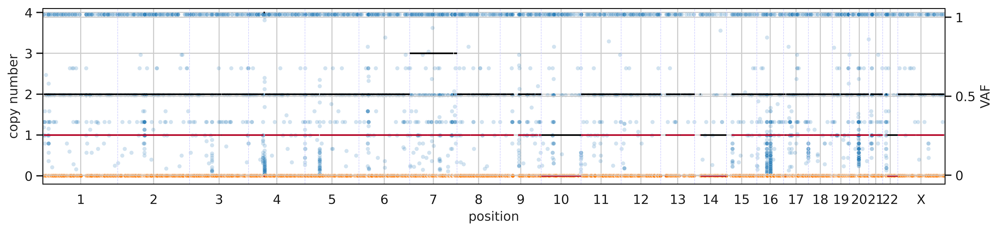

In [358]:
def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate_genes=None,
        maf_final=None,  # DataFrame containing gene information
        mutations=None
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate_genes: genes of interest for annotation in list format
    :param maf_final: DataFrame containing gene information
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[:-1]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.1
    min_h = -0.2

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)
    ax.set_ylabel('copy number')
    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate_genes and maf_final is not None:
        annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes)
    if mutations and maf_final is not None:
        draw_segments_with_mutations(ax, maf_final, cna_segments, chr_start_cs, max_h)

    return ax

def draw_segments_with_mutations(ax, maf_final, cna_segments, chr_start_cs, max_h):
    maf_final['chrom'] = maf_final['Chromosome'].map(chromosome_mapping)
    maf_final['position']=0
    for mut in maf_final.index:
        maf_final.loc[mut, 'position']=maf_final.loc[mut, 'position']+chr_start_cs.loc[maf_final.loc[mut, 'chrom']]+maf_final.loc[mut, 'Start_Position'] 
   # ax.scatter(maf_final['position'], maf_final['vaf_y']*(max_h-0.05), s=5,)
    sns.scatterplot(x=maf_final['position'], 
                    y=maf_final['vaf_sc'] * (max_h - 0.15), 
                    hue=maf_final['Presense'], 
                    s=15, 
                    alpha=0.2, 
                    ax=ax)
    ax2 = ax.twinx()

# Set labels and ticks for the right y-axis
    ax2.set_ylabel('VAF')
    ax2.set_yticks([0.05, 0.5, 0.95])  # Customize the tick positions as needed
    ax2.set_yticklabels(['0', '0.5', '1'])  # Customize the tick labels as needed
    ax.legend().remove()

    
    
def annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes):
    for gene in annotate_genes:
        gene_data = maf_final[maf_final['Hugo_Symbol_y'] == gene]
        
        if not gene_data.empty:
            gene_data = gene_data.iloc[0]  # Take the first occurrence if there are multiple entries
            segment_index = gene_data['segment_n']

            if pd.notna(segment_index):
                segment_data = cna_segments.loc[segment_index]
                chr_pos = chr_start_cs[int(segment_data['chrom'])]

                ax.annotate(
                    gene,
                    xy=((segment_data['start'] + segment_data['end']) / 2 + chr_pos, segment_data['total']),
                    xytext=(0, 5),
                    textcoords='offset points',
                    ha='center',
                    va='bottom',
                    fontsize=8,
                    color='red',  # You can customize the color
                    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'),
                )


draw_segments(segs, annotate_genes=None,mutations=True, maf_final=merged_table[merged_table['Chromosome']!='chrY'], max_cna=4)
plt.show()



In [359]:
maf_final=merged_table[merged_table['Chromosome']!='chrY']

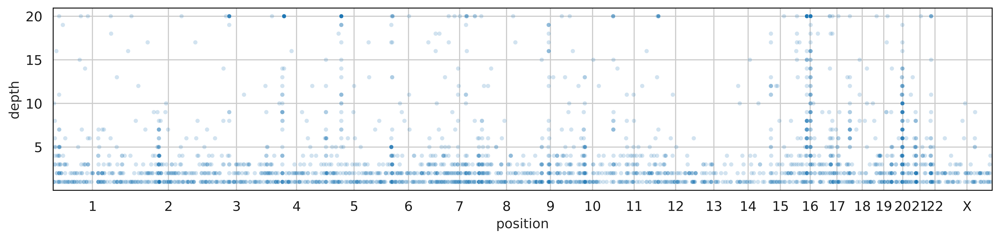

In [370]:
maf_final['chrom'] = maf_final['Chromosome'].map(chromosome_mapping)
maf_final['position']=0
maf_final=maf_final[maf_final['Presense']=='Multiome and Tissue']

plt.figure(figsize=(15, 3))

for mut in maf_final.index:
    maf_final.loc[mut, 'position']=maf_final.loc[mut, 'position']+chr_start_cs.loc[maf_final.loc[mut, 'chrom']]+maf_final.loc[mut, 'Start_Position'] 
   # ax.scatter(maf_final['position'], maf_final['vaf_y']*(max_h-0.05), s=5,)
ax=sns.scatterplot(x=maf_final['position'], 
                    y=maf_final['sum_DP'].clip(0, 20) , 
                    hue=maf_final['Presense'], 
                    s=15, 
                    alpha=0.2)
ax.set_ylabel('depth')
ax_ticks = chr_start_cs + chr_sizes['hg38'][:-1] / 2

ax.set_xticks(ax_ticks)
ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])
ax.legend().remove()

ax.set_xlim(-3000000, chr_end_cs.max() + 3000000)
plt.show()

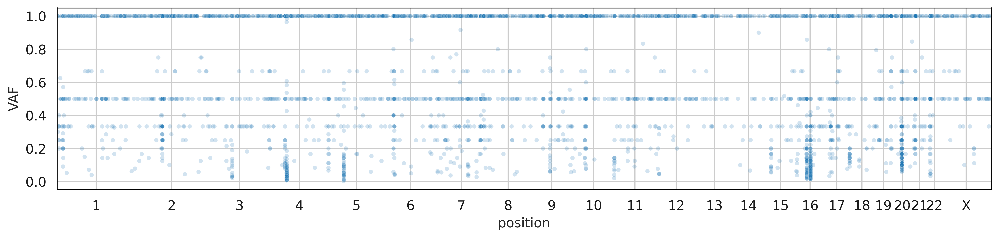

In [363]:
maf_final['chrom'] = maf_final['Chromosome'].map(chromosome_mapping)
maf_final['position']=0
maf_final=maf_final[maf_final['Presense']=='Multiome and Tissue']

plt.figure(figsize=(15, 3))

for mut in maf_final.index:
    maf_final.loc[mut, 'position']=maf_final.loc[mut, 'position']+chr_start_cs.loc[maf_final.loc[mut, 'chrom']]+maf_final.loc[mut, 'Start_Position'] 
   # ax.scatter(maf_final['position'], maf_final['vaf_y']*(max_h-0.05), s=5,)
ax=sns.scatterplot(x=maf_final['position'], 
                    y=maf_final['vaf_sc'] , 
                    hue=maf_final['Presense'], 
                    s=15, 
                    alpha=0.2)
ax.set_ylabel('VAF')
ax_ticks = chr_start_cs + chr_sizes['hg38'][:-1] / 2

ax.set_xticks(ax_ticks)
ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])
ax.legend().remove()

ax.set_xlim(-3000000, chr_end_cs.max() + 3000000)
plt.show()

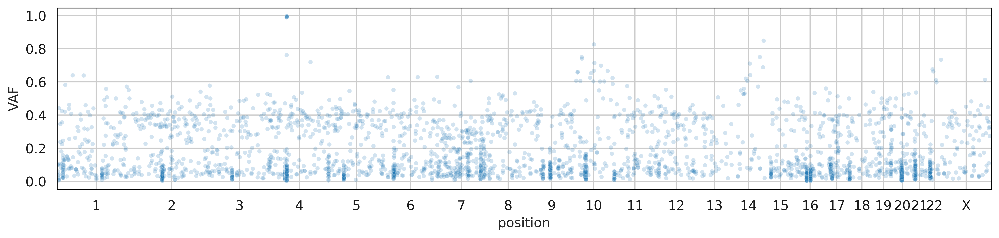

In [365]:
maf_final['chrom'] = maf_final['Chromosome'].map(chromosome_mapping)
maf_final['position']=0
maf_final=maf_final[maf_final['Presense']=='Multiome and Tissue']

plt.figure(figsize=(15, 3))

for mut in maf_final.index:
    maf_final.loc[mut, 'position']=maf_final.loc[mut, 'position']+chr_start_cs.loc[maf_final.loc[mut, 'chrom']]+maf_final.loc[mut, 'Start_Position'] 
   # ax.scatter(maf_final['position'], maf_final['vaf_y']*(max_h-0.05), s=5,)
ax=sns.scatterplot(x=maf_final['position'], 
                    y=maf_final['Tissue_VAF'] , 
                    hue=maf_final['Presense'], 
                    s=15, 
                    alpha=0.2)
ax.set_ylabel('VAF')
ax_ticks = chr_start_cs + chr_sizes['hg38'][:-1] / 2

ax.set_xticks(ax_ticks)
ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])
ax.legend().remove()

ax.set_xlim(-3000000, chr_end_cs.max() + 3000000)
plt.show()

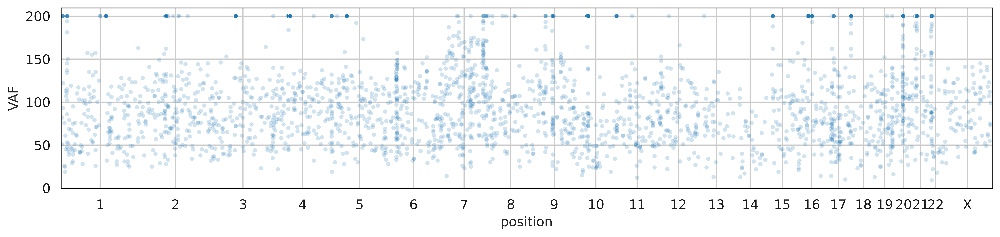

In [369]:
maf_final['chrom'] = maf_final['Chromosome'].map(chromosome_mapping)
maf_final['position']=0
maf_final=maf_final[maf_final['Presense']=='Multiome and Tissue']

plt.figure(figsize=(15, 3))

for mut in maf_final.index:
    maf_final.loc[mut, 'position']=maf_final.loc[mut, 'position']+chr_start_cs.loc[maf_final.loc[mut, 'chrom']]+maf_final.loc[mut, 'Start_Position'] 
   # ax.scatter(maf_final['position'], maf_final['vaf_y']*(max_h-0.05), s=5,)
ax=sns.scatterplot(x=maf_final['position'], 
                    y=maf_final['t_depth'].clip(0, 200) , 
                    hue=maf_final['Presense'], 
                    s=15, 
                    alpha=0.2)
ax.set_ylabel('VAF')
ax_ticks = chr_start_cs + chr_sizes['hg38'][:-1] / 2

ax.set_xticks(ax_ticks)
ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])
ax.legend().remove()

ax.set_xlim(-3000000, chr_end_cs.max() + 3000000)
plt.show()

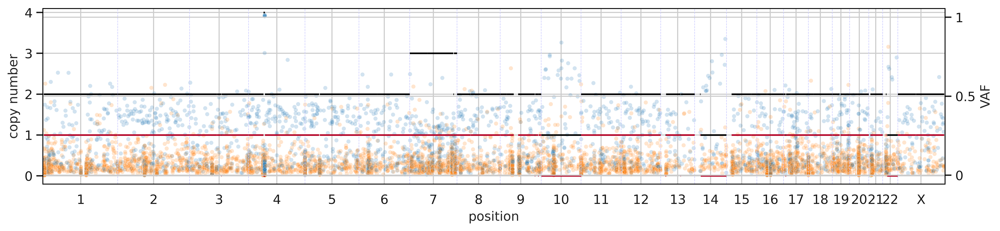

In [314]:
def draw_segments(
        cna_segments,
        ax=None,
        figsize=(15, 3),
        ref='hg38',
        x_offset=3000000,
        max_cna=8,
        annotate_genes=None,
        maf_final=None,  # DataFrame containing gene information
        mutations=None
):
    """
    Plots segments
    :param cna_segments: Segments file
    :param ax:
    :param figsize:
    :param ref: reference genome
    :param x_offset:
    :param max_cna: plot's height
    :param annotate_genes: genes of interest for annotation in list format
    :param maf_final: DataFrame containing gene information
    """
    if ax is None:
        _, ax = plt.subplots(figsize=figsize)

    chr_end_cs = chr_sizes[ref][:-1].cumsum()
    chr_start_cs = pd.Series([0] + chr_end_cs.to_list(), index=chr_sizes[ref].index)[:-1]

    max_h = min(max_cna, cna_segments['total'].max()) + 0.1
    min_h = -0.2

    for chr_pos in chr_start_cs.values[1:]:
        ax.plot((chr_pos, chr_pos), (min_h, max_h), '--', lw=0.5, color='#ccccff')

    for seg in cna_segments.index:
        cseg = cna_segments.loc[seg]
        cum_len = chr_start_cs[int(cseg.chrom)]

        total = min(max_cna, cseg.total)
        ax.plot(
            (cseg.start + cum_len, cseg.end + cum_len),
            (total, total),
            solid_capstyle='butt',
            color='#000000',
        )
        if cseg.minor is not None:
            ax.plot(
                (cseg.start + cum_len, cseg.end + cum_len),
                (cseg.minor, cseg.minor),
                solid_capstyle='butt',
                color='#b40426',
            )

    ax.set_ylim(min_h, max_h)
    ax.set_ylabel('copy number')
    ax_ticks = chr_start_cs + chr_sizes[ref][:-1] / 2

    ax.set_xticks(ax_ticks)
    ax.set_xticklabels(list(ax_ticks.index[:-1]) + ['X'])

    ax.set_xlim(-x_offset, chr_end_cs.max() + x_offset)

    if annotate_genes and maf_final is not None:
        annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes)
    if mutations and maf_final is not None:
        draw_segments_with_mutations(ax, maf_final, cna_segments, chr_start_cs, max_h)

    return ax

def draw_segments_with_mutations(ax, maf_final, cna_segments, chr_start_cs, max_h):
    maf_final['chrom'] = maf_final['Chromosome'].map(chromosome_mapping)
    maf_final['position']=0
    for mut in maf_final.index:
        maf_final.loc[mut, 'position']=maf_final.loc[mut, 'position']+chr_start_cs.loc[maf_final.loc[mut, 'chrom']]+maf_final.loc[mut, 'Start_Position'] 
   # ax.scatter(maf_final['position'], maf_final['vaf_y']*(max_h-0.05), s=5,)
    sns.scatterplot(x=maf_final['position'], 
                    y=maf_final['Tissue_VAF'] * (max_h - 0.15), 
                    hue=maf_final['Presense'], 
                    s=15, 
                    alpha=0.2, 
                    ax=ax)
    ax2 = ax.twinx()

# Set labels and ticks for the right y-axis
    ax2.set_ylabel('VAF')
    ax2.set_yticks([0.05, 0.5, 0.95])  # Customize the tick positions as needed
    ax2.set_yticklabels(['0', '0.5', '1'])  # Customize the tick labels as needed
    ax.legend().remove()

    
    
def annotate_genes_draw_segments(ax, maf_final, cna_segments, chr_start_cs, ref, annotate_genes):
    for gene in annotate_genes:
        gene_data = maf_final[maf_final['Hugo_Symbol_y'] == gene]
        
        if not gene_data.empty:
            gene_data = gene_data.iloc[0]  # Take the first occurrence if there are multiple entries
            segment_index = gene_data['segment_n']

            if pd.notna(segment_index):
                segment_data = cna_segments.loc[segment_index]
                chr_pos = chr_start_cs[int(segment_data['chrom'])]

                ax.annotate(
                    gene,
                    xy=((segment_data['start'] + segment_data['end']) / 2 + chr_pos, segment_data['total']),
                    xytext=(0, 5),
                    textcoords='offset points',
                    ha='center',
                    va='bottom',
                    fontsize=8,
                    color='red',  # You can customize the color
                    bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'),
                )


draw_segments(segs, annotate_genes=None,mutations=True, maf_final=merged_table[merged_table['Chromosome']!='chrY'], max_cna=4)
plt.show()



In [14]:
from scipy.stats import binomtest
binomtest(1, 20, 0.5, alternative='two-sided', ).proportion_ci()

ConfidenceInterval(low=0.0012650894979560335, high=0.24873276277202772)

In [13]:
1/20

0.05

# BTROHT01 perimarginal mut calling

In [15]:
cells=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_peri_somatic/cellSNP.samples.tsv', sep="\t", header=None)


sample_names = cells[0].tolist()

# Read cellSNP.cells.vcf file
vcf_df = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_peri_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns = vcf_df.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns = vcf_df.iloc[:, 9:]   # Assuming remaining columns are sample genotypes

# Rename sample columns with sample names
sample_columns.columns = sample_names

# Concatenate variant columns with renamed sample columns
vcf_with_sample_names = pd.concat([variant_columns, sample_columns], axis=1)
vcf_with_sample_names['modality']='atac'

cells_gex=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_peri_somatic/cellSNP.samples.tsv', sep="\t", header=None)
sample_names = cells_gex[0].tolist()

# Read cellSNP.cells.vcf file
vcf_df_gex = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_peri_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns_gex = vcf_df_gex.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns_gex = vcf_df_gex.iloc[:, 9:]   # Assuming remaining columns are sample genotypes
# Rename sample columns with sample names
sample_columns_gex.columns = sample_names



# Concatenate variant columns with renamed sample columns
vcf_with_sample_names_gex = pd.concat([variant_columns_gex, sample_columns_gex], axis=1)
vcf_with_sample_names_gex['modality']='gex'

#concatenate atac and rna vcfs
vcf_with_sample_names=pd.concat([vcf_with_sample_names, vcf_with_sample_names_gex])

vcf_with_sample_names=vcf_with_sample_names.rename(columns={0:'Chromosome', 1:'Start_Position'})
vcf_with_sample_names

NameError: name 'pd' is not defined

In [373]:
vcf_with_sample_names=vcf_with_sample_names.replace('.:.:.:.:.:.', 'nan')
vcf_with_sample_names

,Chromosome,Start_Position,2,3,4,5,6,7,8,AAACAGCCAATGCCCG-1,...,TTTGTGTTCAAACTCA-1,TTTGTGTTCAAGGACA-1,TTTGTGTTCCGTCCAT-1,TTTGTGTTCGTTCACC-1,TTTGTTGGTAACGGGA-1,TTTGTTGGTACCGTTT-1,TTTGTTGGTTAACGGC-1,TTTGTTGGTTACATCC-1,TTTGTTGGTTTATGGG-1,modality
0,chr1,16257,.,G,C,.,PASS,AD=4;DP=57;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
1,chr1,187173,.,T,G,.,PASS,AD=2;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
2,chr1,202259,.,G,T,.,PASS,AD=2;DP=13;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
3,chr1,630026,.,C,T,.,PASS,AD=1;DP=4;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
4,chr1,789671,.,G,C,.,PASS,AD=2;DP=7;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,atac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4494,chrX,154453759,.,C,A,.,PASS,AD=0;DP=13;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex
4495,chrY,11309369,.,G,C,.,PASS,AD=4;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex
4496,chrY,11309392,.,C,T,.,PASS,AD=0;DP=2;OTH=4,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex
4497,chrY,11309397,.,G,A,.,PASS,AD=0;DP=2;OTH=4,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,gex


## let's see how many positions with variants are covered in each cell in GEX and ATAC

In [374]:
cells=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_peri_somatic/cellSNP.samples.tsv', sep="\t", header=None)


sample_names = cells[0].tolist()

vcf_df_gex = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_rna/BTROHT01_peri_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns_gex = vcf_df_gex.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns_gex = vcf_df_gex.iloc[:, 9:]   # Assuming remaining columns are sample genotypes
# Rename sample columns with sample names
sample_columns_gex.columns = sample_names



# Concatenate variant columns with renamed sample columns
vcf_with_sample_names_gex = pd.concat([variant_columns_gex, sample_columns_gex], axis=1)


vcf_with_sample_names_gex=vcf_with_sample_names_gex.replace('.:.:.:.:.:.', 'nan')
vcf_with_sample_names_gex

,0,1,2,3,4,5,6,7,8,AAACAGCCAATGCCCG-1,...,TTTGTGGCATGAATAG-1,TTTGTGTTCAAACTCA-1,TTTGTGTTCAAGGACA-1,TTTGTGTTCCGTCCAT-1,TTTGTGTTCGTTCACC-1,TTTGTTGGTAACGGGA-1,TTTGTTGGTACCGTTT-1,TTTGTTGGTTAACGGC-1,TTTGTTGGTTACATCC-1,TTTGTTGGTTTATGGG-1
0,chr1,826372,.,C,T,.,PASS,AD=7;DP=10;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,chr1,1572341,.,T,A,.,PASS,AD=12;DP=14;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,chr1,1667948,.,A,G,.,PASS,AD=1;DP=3;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,chr1,2220202,.,A,C,.,PASS,AD=1;DP=2;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,chr1,2652849,.,C,T,.,PASS,AD=4;DP=5;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4494,chrX,154453759,.,C,A,.,PASS,AD=0;DP=13;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4495,chrY,11309369,.,G,C,.,PASS,AD=4;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4496,chrY,11309392,.,C,T,.,PASS,AD=0;DP=2;OTH=4,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4497,chrY,11309397,.,G,A,.,PASS,AD=0;DP=2;OTH=4,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [376]:
cells=pd.read_csv('/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_peri_somatic/cellSNP.samples.tsv', sep="\t", header=None)


sample_names = cells[0].tolist()

# Read cellSNP.cells.vcf file
vcf_df_atac = pd.read_csv("/scratch/alexandra.livanova/INT/sc_mutation_calling/output_atac/BTROHT01_peri_somatic/cellSNP.cells.vcf", sep="\t", comment="#", header=None)

# Extract variant columns and sample columns
variant_columns = vcf_df_atac.iloc[:, :9]  # Assuming first 9 columns are variant information
sample_columns = vcf_df_atac.iloc[:, 9:]   # Assuming remaining columns are sample genotypes

# Rename sample columns with sample names
sample_columns.columns = sample_names

# Concatenate variant columns with renamed sample columns
vcf_with_sample_names_atac = pd.concat([variant_columns, sample_columns], axis=1)

vcf_with_sample_names_atac=vcf_with_sample_names_atac.replace('.:.:.:.:.:.', 'nan')
vcf_with_sample_names_atac

,0,1,2,3,4,5,6,7,8,AAACAGCCAATGCCCG-1,...,TTTGTGGCATGAATAG-1,TTTGTGTTCAAACTCA-1,TTTGTGTTCAAGGACA-1,TTTGTGTTCCGTCCAT-1,TTTGTGTTCGTTCACC-1,TTTGTTGGTAACGGGA-1,TTTGTTGGTACCGTTT-1,TTTGTTGGTTAACGGC-1,TTTGTTGGTTACATCC-1,TTTGTTGGTTTATGGG-1
0,chr1,16257,.,G,C,.,PASS,AD=4;DP=57;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,chr1,187173,.,T,G,.,PASS,AD=2;DP=8;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,chr1,202259,.,G,T,.,PASS,AD=2;DP=13;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,chr1,630026,.,C,T,.,PASS,AD=1;DP=4;OTH=1,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,chr1,789671,.,G,C,.,PASS,AD=2;DP=7;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18576,chrY,56874216,.,G,A,.,PASS,AD=2;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
18577,chrY,56874464,.,C,T,.,PASS,AD=1;DP=9;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
18578,chrY,56878358,.,A,T,.,PASS,AD=1;DP=6;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
18579,chrY,56883711,.,G,A,.,PASS,AD=1;DP=3;OTH=0,GT:AD:DP:OTH:PL:ALL,nan,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


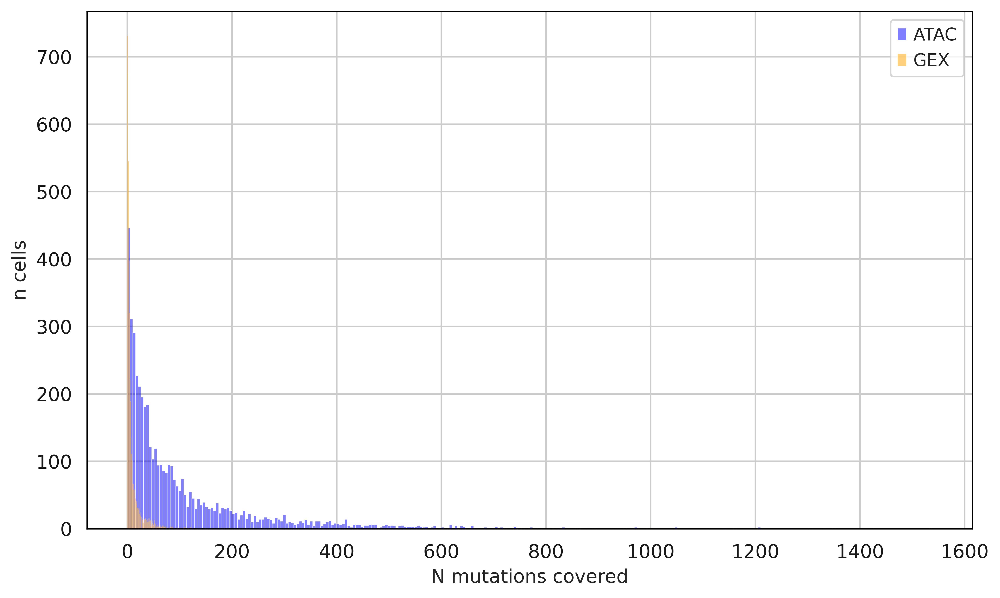

In [377]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create the figure
plt.figure(figsize=(10, 6))

# Plot the first histogram for ATAC data
sns.histplot((vcf_with_sample_names_atac.iloc[:, 9:] != 'nan').sum(), 
             color='blue', label='ATAC', kde=False, alpha=0.5, bins=300)

# Plot the second histogram for GEX data
sns.histplot((vcf_with_sample_names_gex.iloc[:, 9:] != 'nan').sum(), 
             color='orange', label='GEX', kde=False, alpha=0.5)

# Add labels and a title
plt.xlabel('N mutations covered')
plt.ylabel('n cells')
plt.title('')

# Show the legend to differentiate between ATAC and GEX
plt.legend()

# Display the plot
plt.show()


## visualize n of mutations in UMAP plots

In [378]:
rna = sc.read('/group/sottoriva//alexandra.livanova/ROVIGO/multiome/BTROHT_01_perimarginal/data/BTROHT_01_perimarginal_rna.h5ad')
rna

AnnData object with n_obs × n_vars = 4216 × 36588
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'cell_typist_majority_voting_AdultAged_Hippocampus', 'cell_typist_predicted_labels_AdultAged_Hippocampus', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'celltypist_conf_score_AdultAged_Hippocampus', 'cnv_raw_l1', 'cnv_raw_l2', 'cnv_score', 'cnv_leiden', 'celltype', 'S_score', 'G2M_score', 'phase', 'TERT_promoter_mutated'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cell_typist_majority_voting_AdultAged_Hippocampus_colors', 'cell_typist_predicted_labels_AdultAged_Hippocampus_colors', 'celltype_colors', 'cnv_leiden_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'umap'
    obsm: '

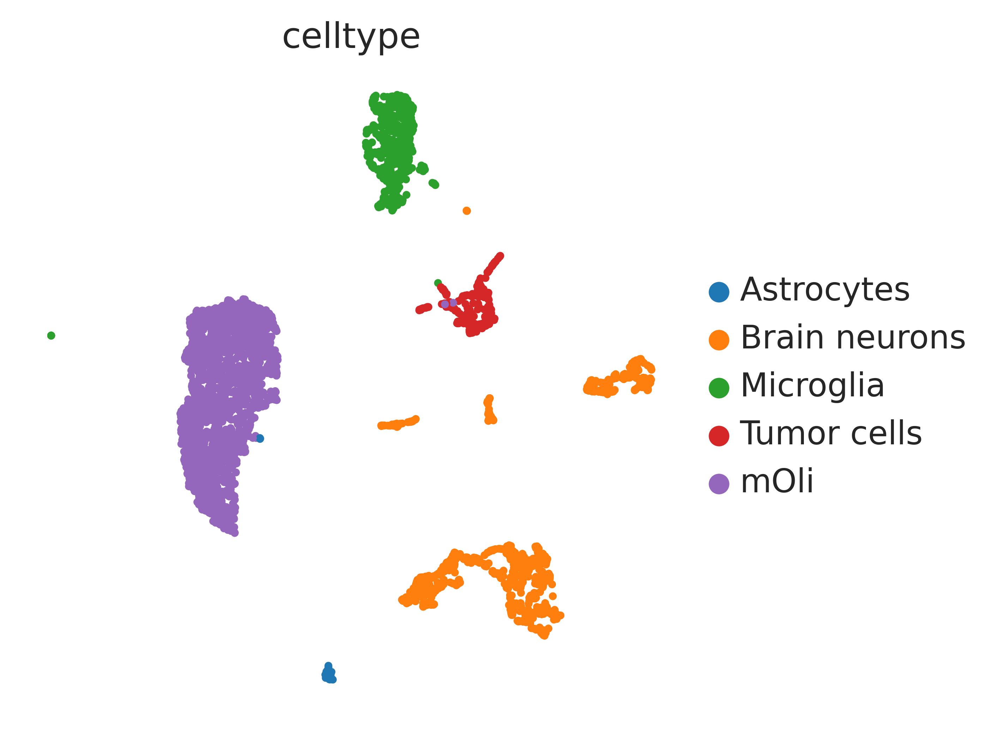

In [379]:
sc.pl.umap(rna, color=['celltype'])

In [380]:
rna.obs['mut_sum_gex']=(vcf_with_sample_names_gex.iloc[:, 9:]!='nan').sum().reindex(rna.obs_names)
rna.obs['mut_sum_atac']=(vcf_with_sample_names_atac.iloc[:, 9:]!='nan').sum().reindex(rna.obs_names)


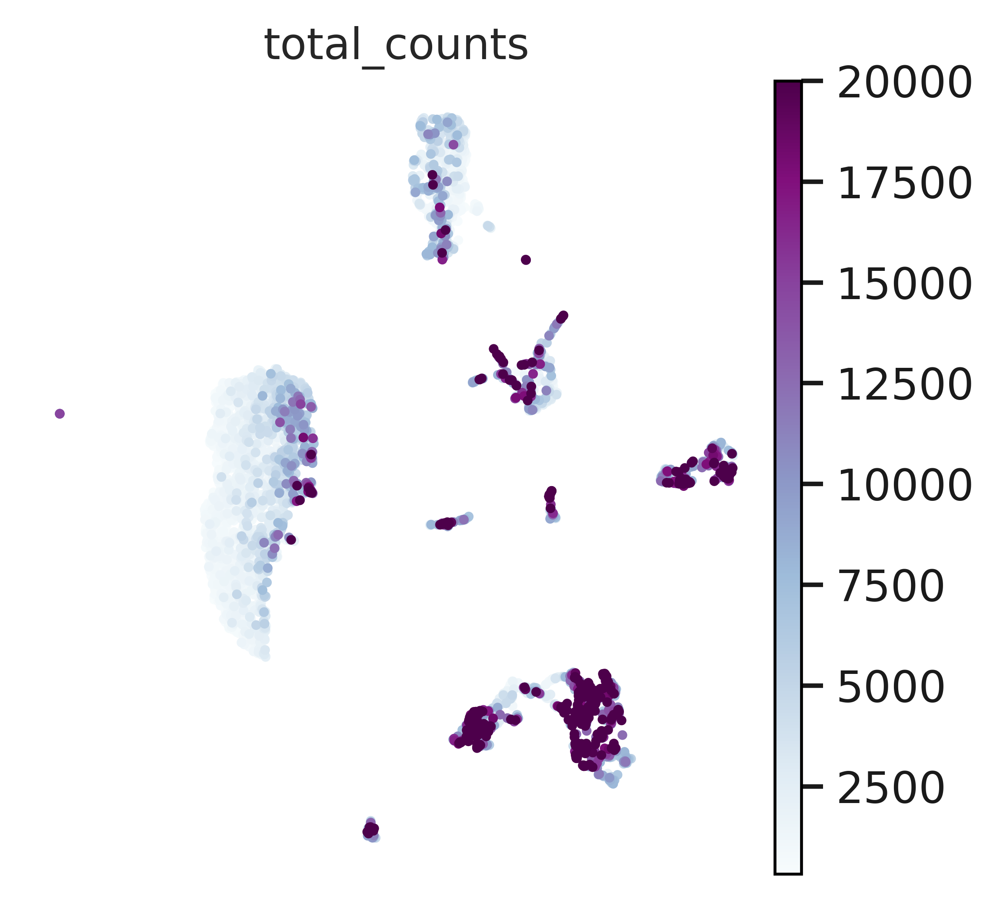

In [381]:
sc.pl.umap(rna, color=['total_counts'], vmax=20000, ncols=1, cmap='BuPu')

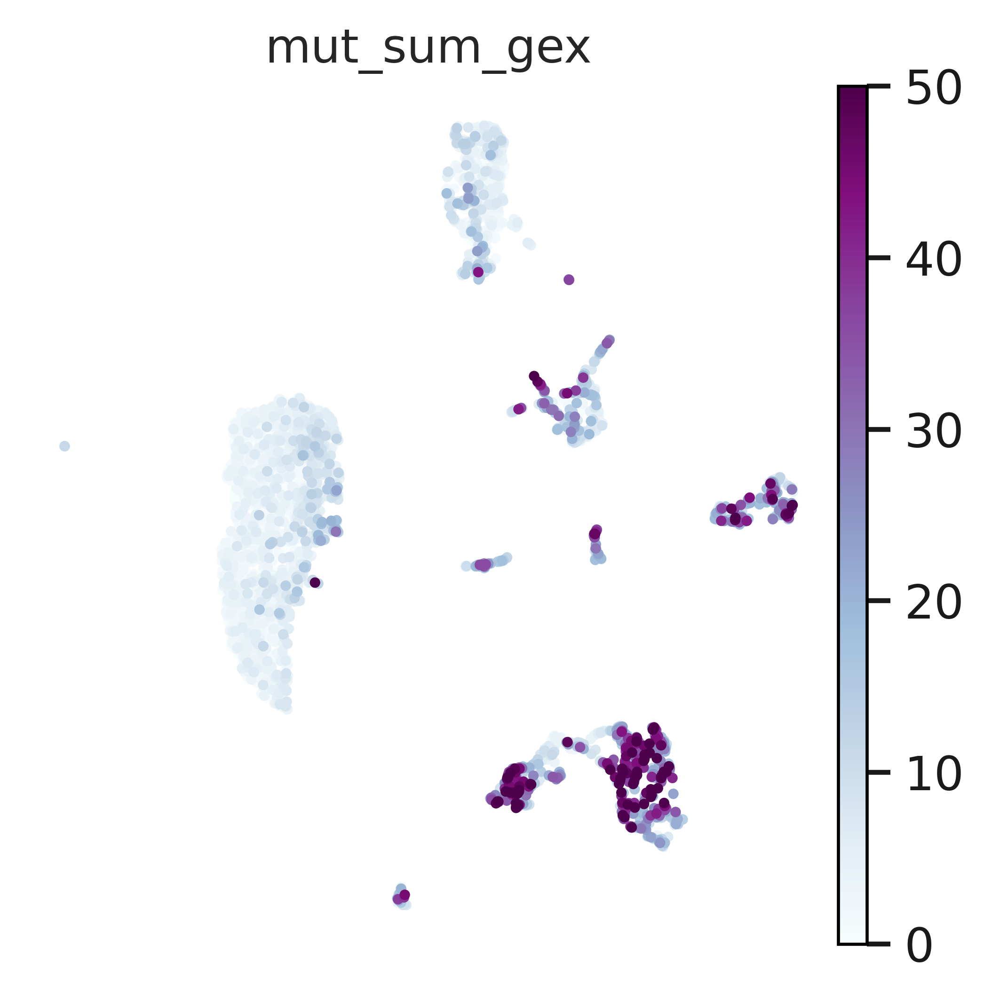

In [382]:
sc.pl.umap(rna, color=['mut_sum_gex'], vmax=50, ncols=1, cmap='BuPu')

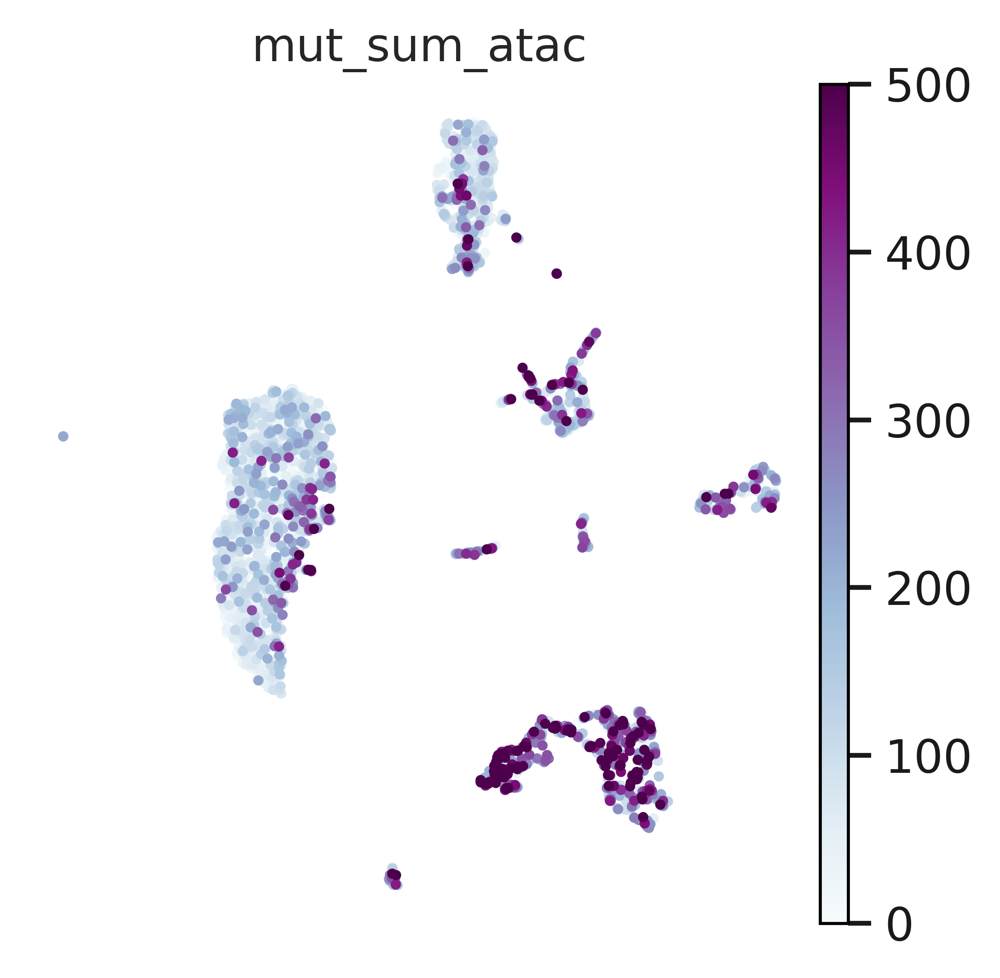

In [384]:
sc.pl.umap(rna, color=['mut_sum_atac'], vmax=500, ncols=1, cmap='BuPu')

# CNAs BTROHT01

In [ ]:
file_paths_rovigo=[
    '/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT01/BTROHT01/BTROHT01_T3/BTROHT01_T3/wgs/mutect/BTROHT01_T3.maf',
    '/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT02/BTROHT02_T2/BTROHT02_T2/wgs/mutect/BTROHT02_T2.maf',
    '/group/sottoriva/00-PROCESSED_DATA/2023-ROVIGO/BTROHT04/BTROHT04_T1/BTROHT04_T1/wgs/mutect/BTROHT04_T1.maf']

In [ ]:
valid_chromosomes = [f'chr{i}' for i in range(1, 23)]


In [ ]:
import os
import pandas as pd
maf_list = []
for path in file_paths_rovigo:
    maf=pd.read_csv(path,sep='\t', comment='#', low_memory=False)
    maf=maf[maf['FILTER']=='PASS']
    maf=maf[maf['Chromosome'].isin(valid_chromosomes)]
    maf = maf[maf.Variant_Classification.isin(['In_Frame_Ins', 'In_Frame_Del',
 'Missense_Mutation',
 'Frame_Shift_Ins',
 'Frame_Shift_Del',
 'Nonsense_Mutation',
 'Nonstop_Mutation',
 'Translation_Start_Site',
 'Splice_Site'])]
    maf['Tumor_VAF']=maf['t_alt_count']/maf['t_depth']
    maf['Normal_VAF']=maf['n_alt_count']/maf['n_depth']

#     maf=maf[maf['Tumor_VAF']>0.05]
#     indel_condition = (maf['Variant_Classification'].isin(['In_Frame_Del', 'Frame_Shift_Ins']))
#     maf = maf[(indel_condition & (maf['Tumor_VAF'] > 0.1)) | (~indel_condition)]
 

    maf=maf[maf['t_depth']>10]
    maf=maf[maf['n_depth']>10]
    maf=maf[maf['t_alt_count']>=3]
    maf=maf[maf['n_alt_count']==0]
 
    maf=maf[['Hugo_Symbol', 'Variant_Classification']]
    maf=maf[maf['Hugo_Symbol'].isin(IntOGen.IntOGen.tolist()+ ['TERT', 'SPTA1', 'GABRA6', 'CDH18', 'SEMA3C', 'COL1A2', 'ABCC9', 'NLRP5', 'DRD5', 'TCHH', 'SCN9A'])]
    filename = os.path.basename(path)  # This gives "INT_C035_T2.adj.maf" or "INT_C035_T1.maf"
    
    # Remove the extension to get the ID
    if filename.endswith('.adj.maf'):
        id = filename[:-8]  # Remove ".adj.maf"
    elif filename.endswith('.maf'):
        id = filename[:-4] 
        
    maf['Patient']=id
    maf_list.append(maf)
    print(f'{id} maf added to list')